<a href="https://colab.research.google.com/github/BrainConnection/Quantum_Algorithm/blob/main/6.%205Q%20TFIM%20VQNHE%20CNN%20QEM%20ZZ%20Crosstalk%203%204%205%2015%2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Environment Setting

In [ ]:
!pip install qiskit
!pip install qiskit-ibm-runtime
!pip install qiskit[visualization]
!pip install qiskit-algorithms
!pip install qiskit-aer

!pip install scipy
!pip install matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 15.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 29.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.7/49.7 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.4/39.4 MB 42.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.5/107.5 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.0/318.0 kB 23.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 8.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   

In [ ]:
from functools import cache

from qiskit_ibm_runtime import QiskitRuntimeService, Estimator, Options

# Save an IBM Quantum account and set it as your default account.
QiskitRuntimeService.save_account(channel="ibm_quantum",
                                  token="067e5c82606f0a1157dd554e2087d6b7a9b823dbaa4ad47b95c3337eab2e6cd9361719cc0470f4a98d1631b73b264a82577012a0b8ff32963d5964e6cc12c525",
                                  set_as_default=True,
                                  overwrite=True)

service = QiskitRuntimeService()
backend = service.backend("ibmq_qasm_simulator")

# Hamiltonian Diagonalization

$$ H = Σ Z_j Z_{j+1} - Σ X_j  $$

1D 5 Qubit System

In [ ]:
from qiskit.quantum_info import SparsePauliOp
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)
hamiltonian_matrix = hamiltonian.to_matrix()

eigenvalue, eigenvector = np.linalg.eig(hamiltonian_matrix)

lowest_energy = np.min(eigenvalue)

np.real(lowest_energy)

-6.026674183332294

# 7. CNN Estimation - ZZ Crosstalk (CUSCO 3 4 5 15 22)

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 1MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 1MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.001                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23201064 5.13798936]
[10.16026046 10.37001454  9.97059499]
1.4542737942768724e-05
[5.13800667 4.98799333]
[ 9.97058713 10.12601724  9.66844563]
1.723952758059255e-05
[4.98796301 5.01503699]
[ 9.66844402 10.00301312  9.72300286]
1.3120722719861533e-05
[5.01499625 5.28200375]
[ 9.72300652 10.29705895 10.26094454]
5.8948757417631725e-05


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(7.271368971384362e-06,
 8.619763790296275e-06,
 6.560361359930766e-06,
 2.9474378708815863e-05)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

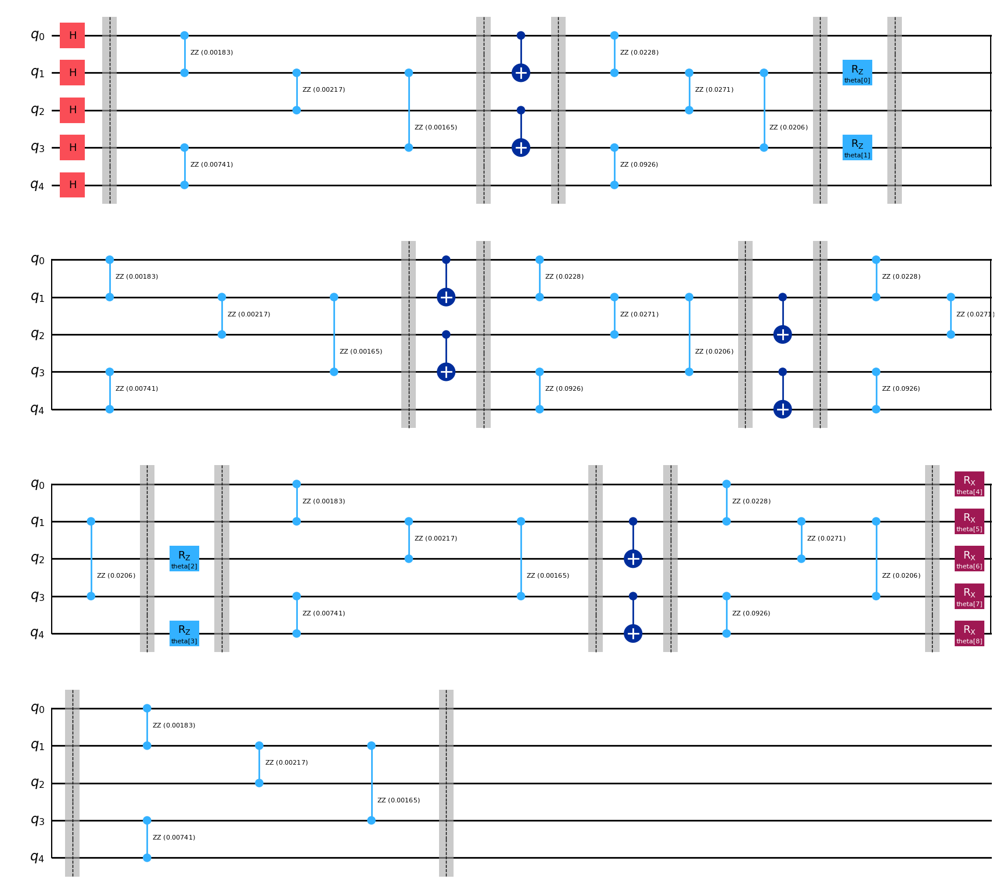

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

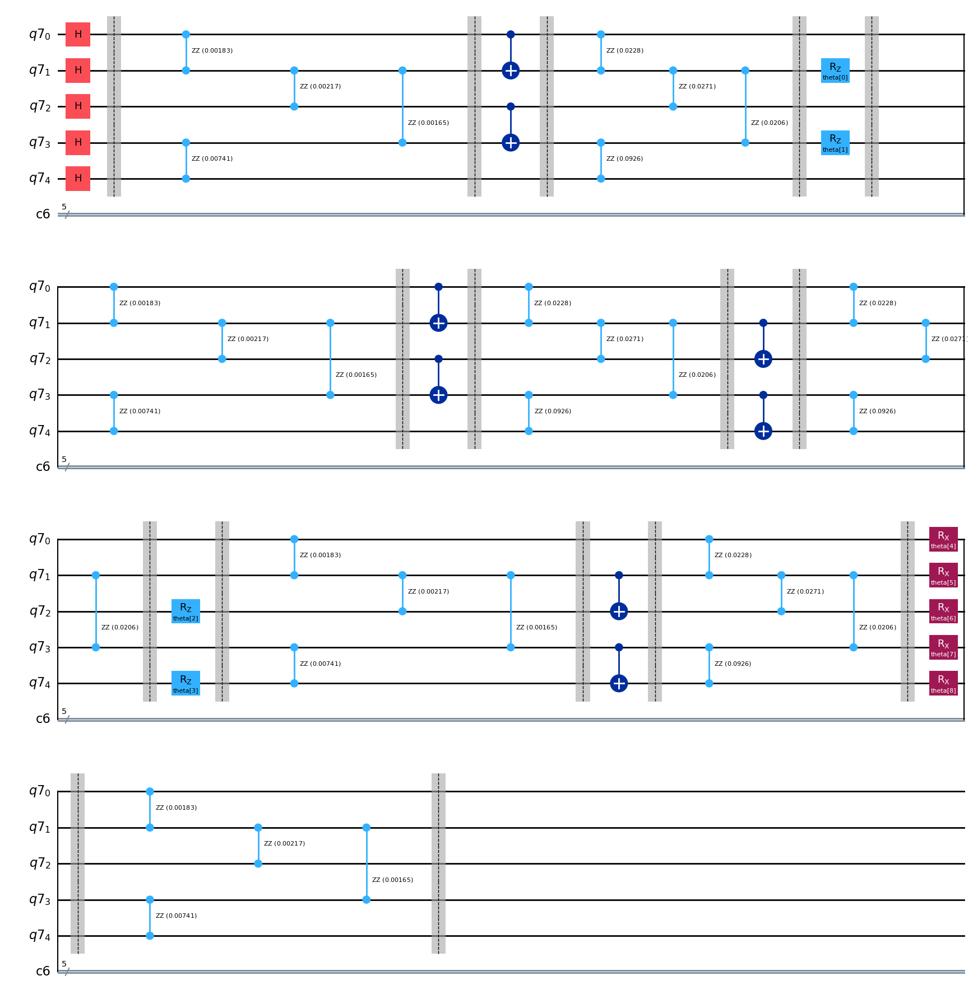

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

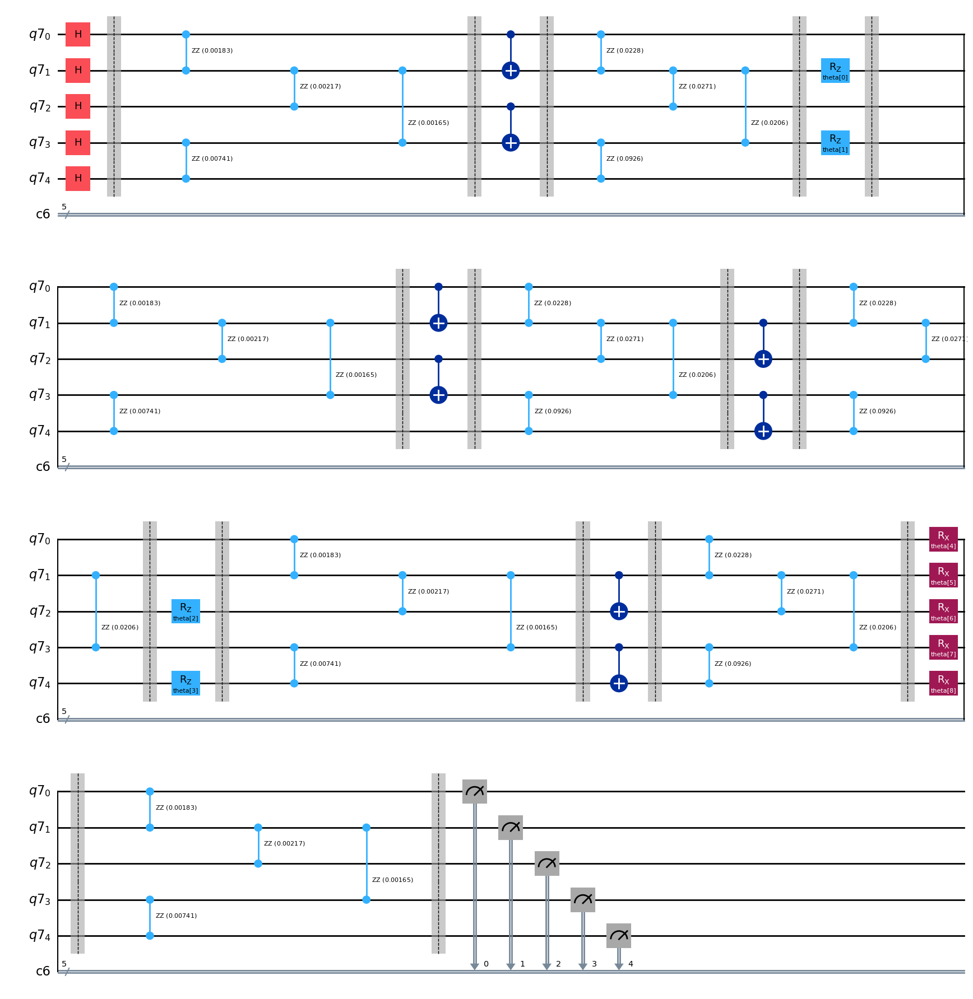

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

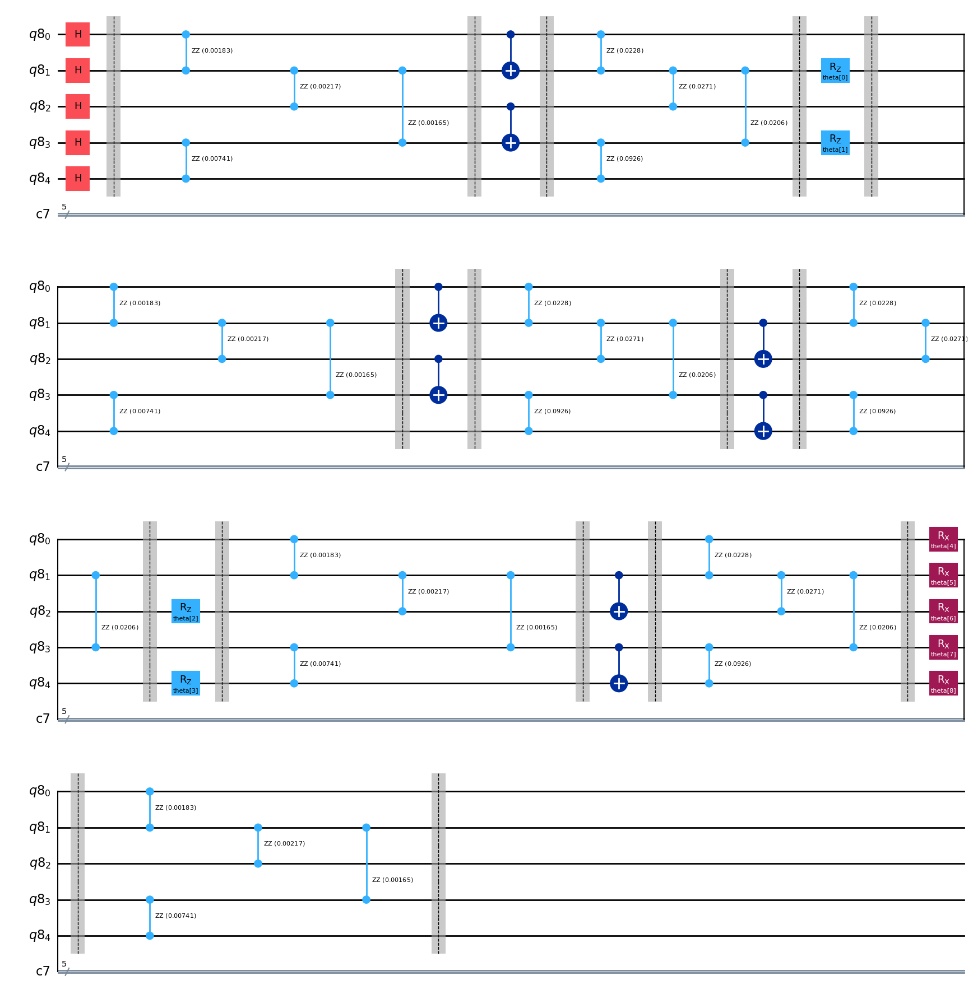

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

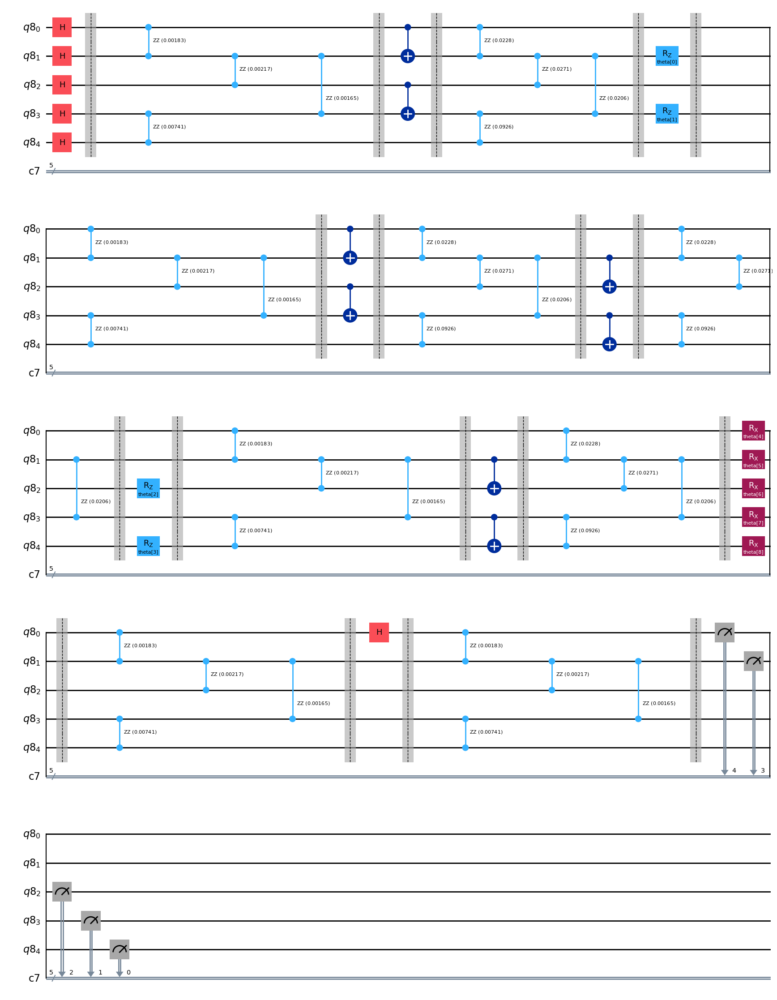

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

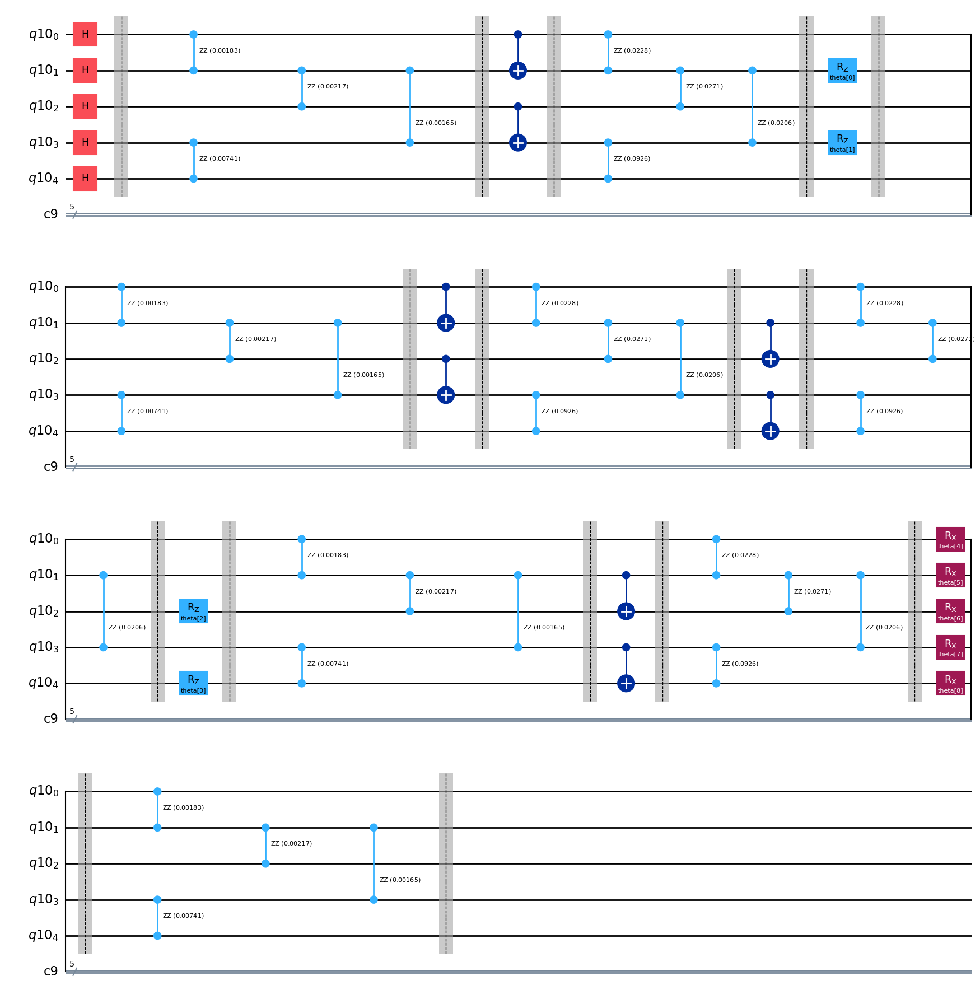

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

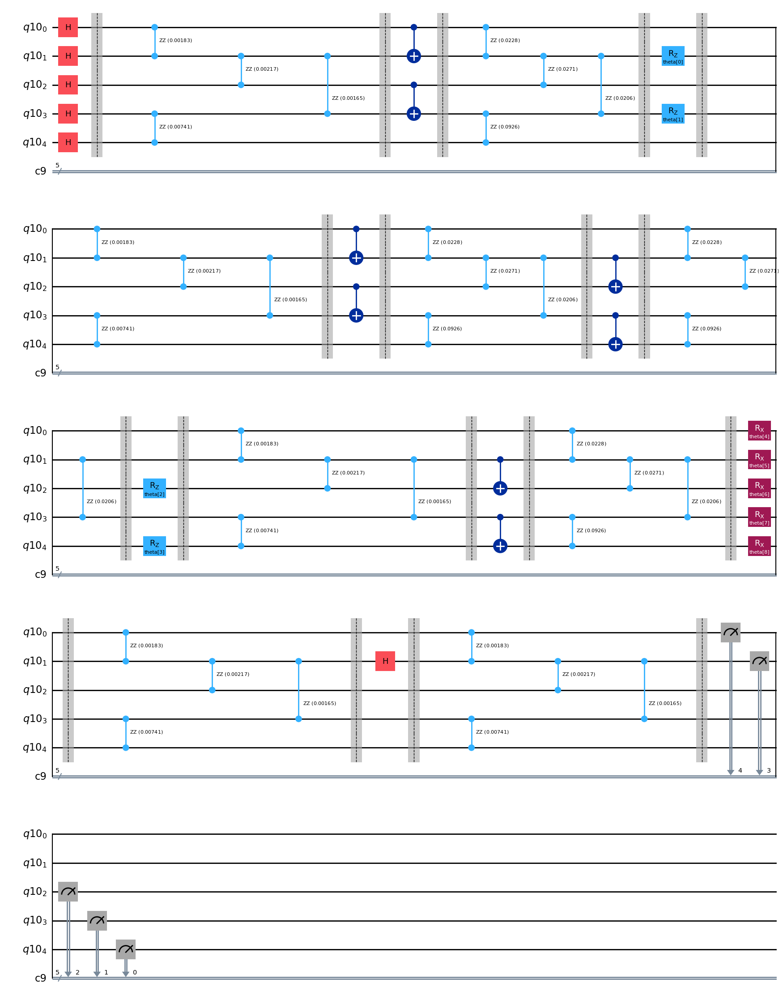

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

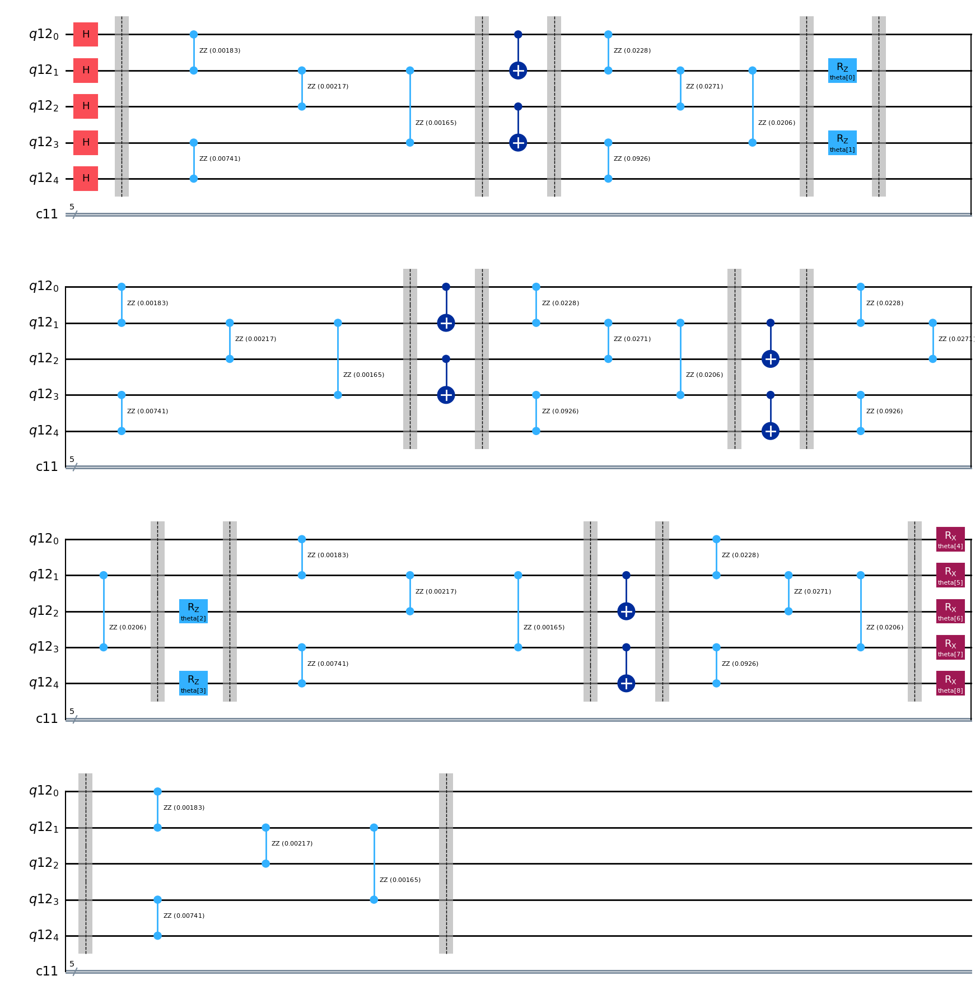

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

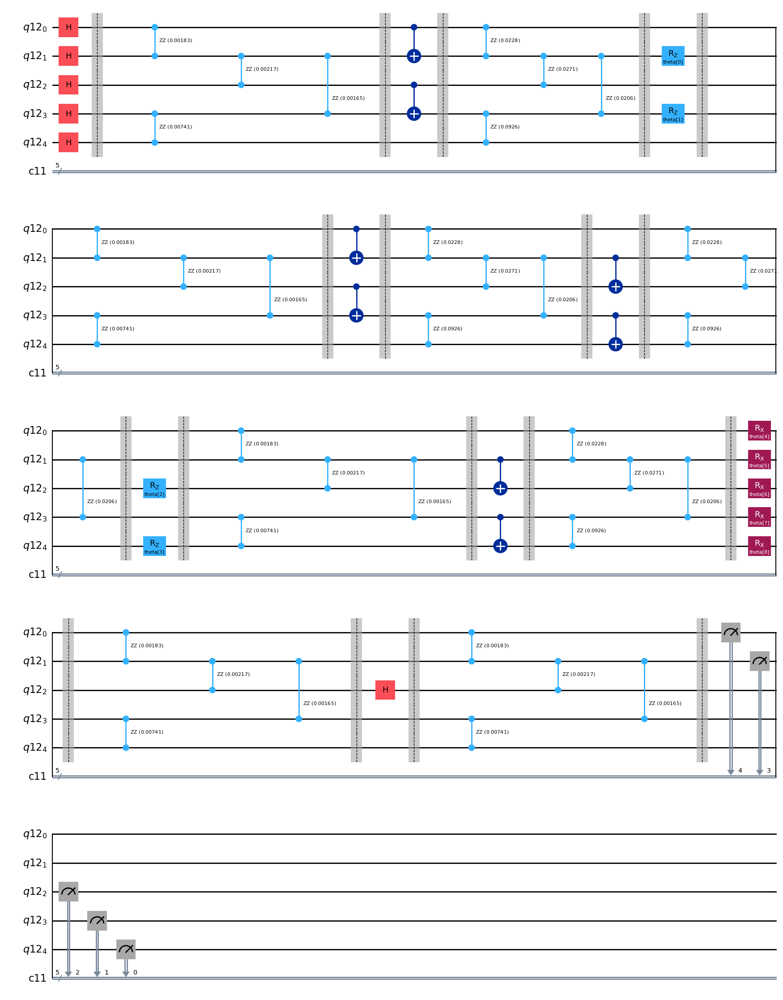

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

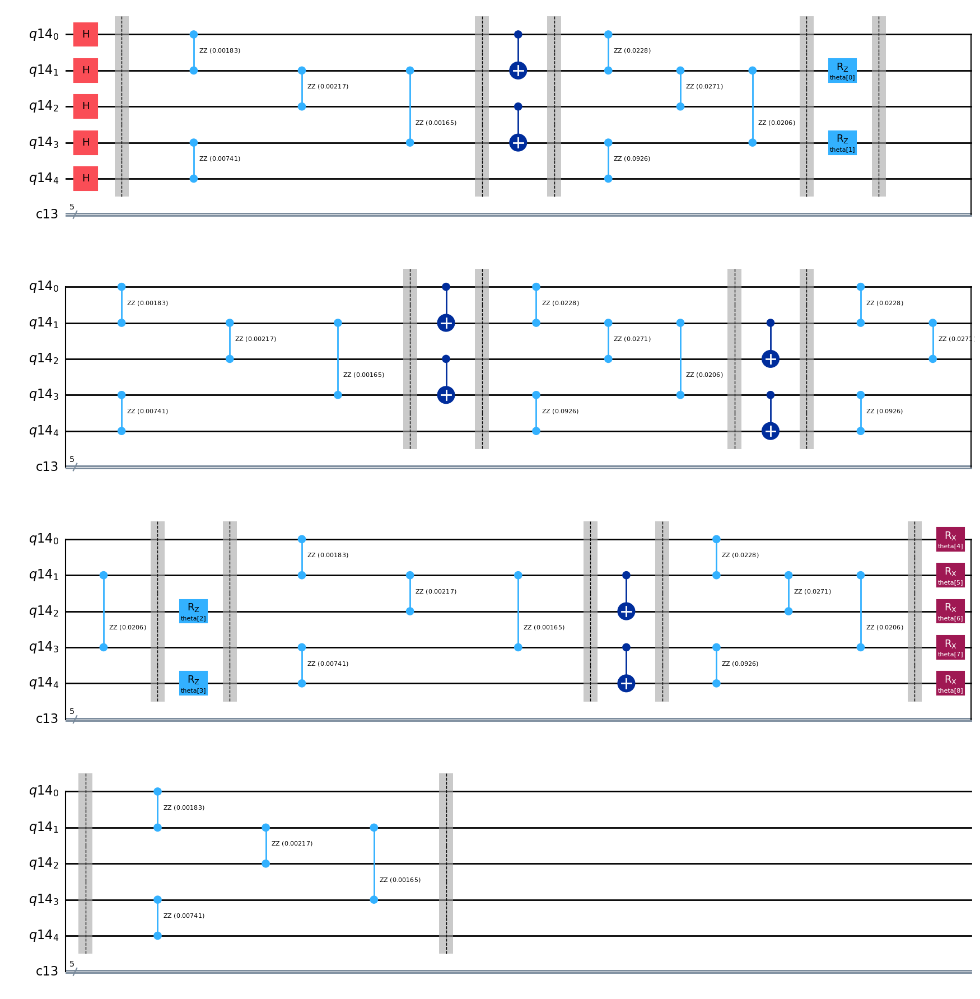

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

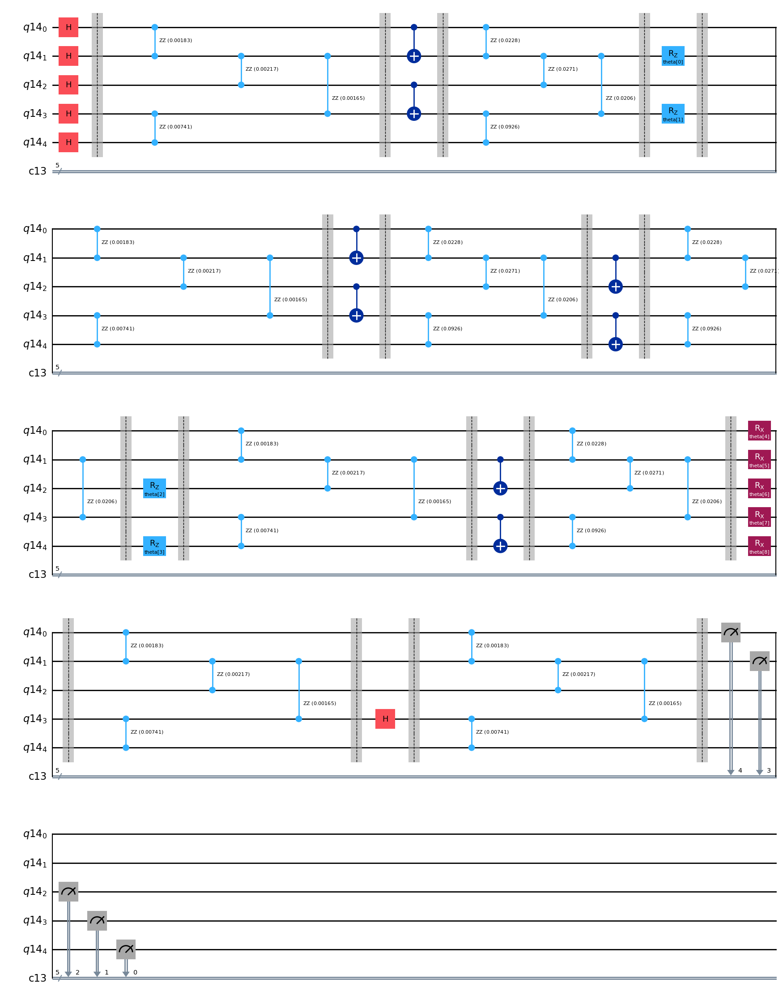

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

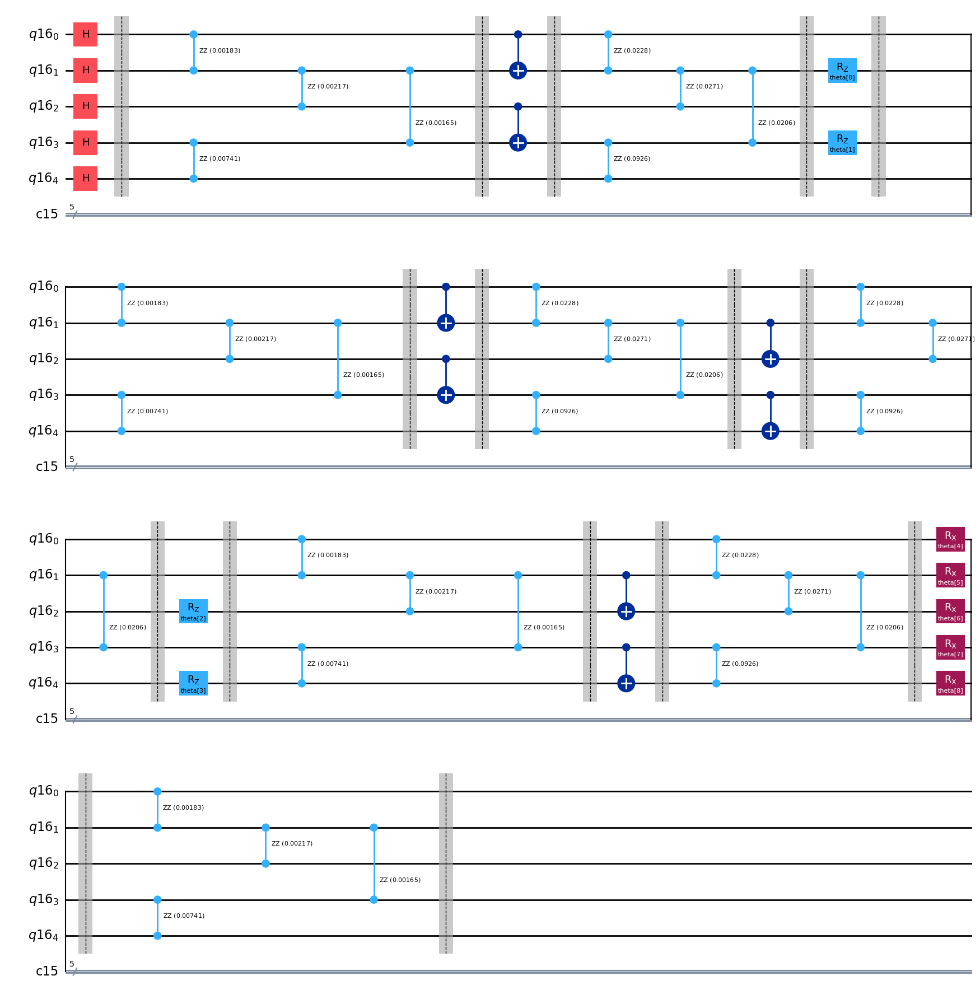

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

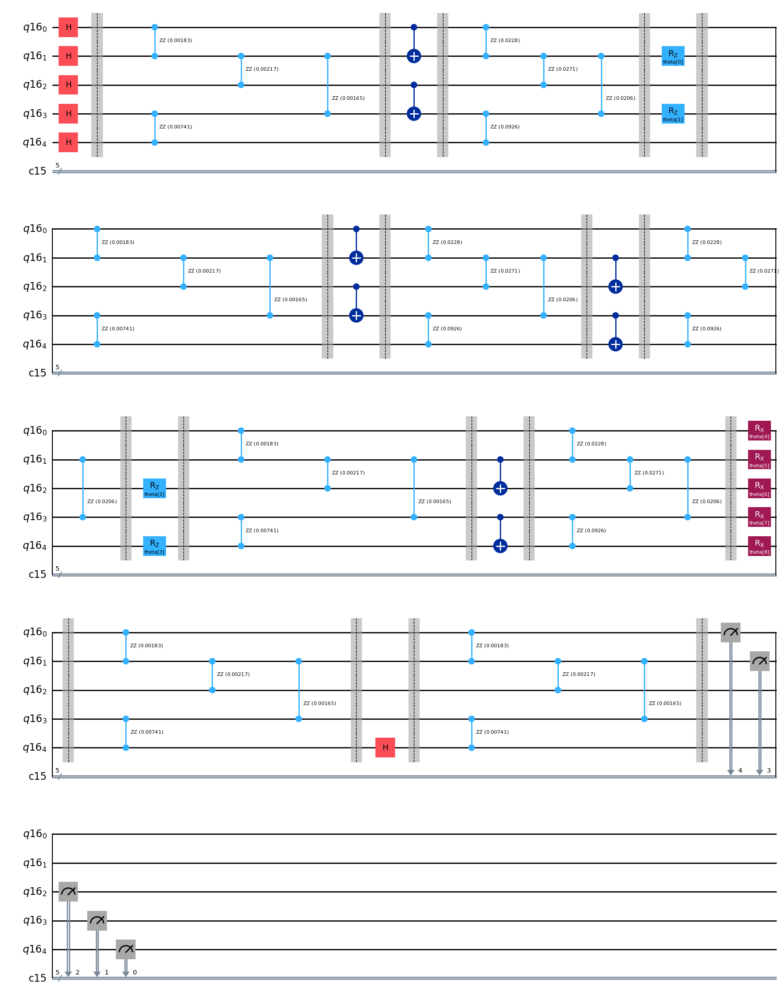

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-3.536400000000001
-5.6408000000000005
-3.5378000000000003
-3.4834
-5.847399999999999
-5.8108
-5.792400000000001
-5.819799999999998
-5.8522
-3.5445999999999995
-5.7436
-5.830999999999998
-5.697399999999999
-5.8416000000000015
-5.814200000000001
-5.8435999999999995
-3.480200000000001
-5.821199999999999
-5.793200000000001
-5.715800000000001


In [ ]:
lowest_energy_vqe

-5.8522

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.536400000000001
-5.6408000000000005
-3.5378000000000003
-3.4834
-5.847399999999999
-5.8108
-5.792400000000001
-5.819799999999998
-5.8522
-3.5445999999999995
-5.7436
-5.830999999999998
-5.697399999999999
-5.8416000000000015
-5.814200000000001
-5.8435999999999995
-3.480200000000001
-5.821199999999999
-5.793200000000001
-5.715800000000001
Optimization terminated successfully.
         Current function value: -6.219820
         Iterations: 227
         Function evaluations: 2037
         Gradient evaluations: 291
Optimization terminated successfully.
         Current function value: -6.219821
         Iterations: 238
         Function evaluations: 2142
         Gradient evaluations: 306


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219821
         Iterations: 300
         Function evaluations: 3010
         Gradient evaluations: 430


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219820
         Iterations: 221
         Function evaluations: 2142
         Gradient evaluations: 306
Optimization terminated successfully.
         Current function value: -6.219819
         Iterations: 219
         Function evaluations: 2037
         Gradient evaluations: 291
Optimization terminated successfully.
         Current function value: -6.219820
         Iterations: 206
         Function evaluations: 2037
         Gradient evaluations: 291


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219821
         Iterations: 209
         Function evaluations: 2301
         Gradient evaluations: 327


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219819
         Iterations: 208
         Function evaluations: 1974
         Gradient evaluations: 282


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219820
         Iterations: 228
         Function evaluations: 2434
         Gradient evaluations: 346
Optimization terminated successfully.
         Current function value: -6.219821
         Iterations: 216
         Function evaluations: 2184
         Gradient evaluations: 312


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219819
         Iterations: 188
         Function evaluations: 1911
         Gradient evaluations: 273


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219820
         Iterations: 217
         Function evaluations: 2210
         Gradient evaluations: 314
Optimization terminated successfully.
         Current function value: -6.219819
         Iterations: 246
         Function evaluations: 2555
         Gradient evaluations: 365


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219820
         Iterations: 180
         Function evaluations: 1825
         Gradient evaluations: 259


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219821
         Iterations: 217
         Function evaluations: 2100
         Gradient evaluations: 300


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219820
         Iterations: 197
         Function evaluations: 1876
         Gradient evaluations: 268


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219820
         Iterations: 220
         Function evaluations: 2142
         Gradient evaluations: 306


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.219819
         Iterations: 166
         Function evaluations: 1839
         Gradient evaluations: 261
Optimization terminated successfully.
         Current function value: -6.219820
         Iterations: 211
         Function evaluations: 2037
         Gradient evaluations: 291
         Current function value: -6.219819
         Iterations: 170
         Function evaluations: 1832
         Gradient evaluations: 260


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.21982082354652

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.536400000000001
-5.6408000000000005
-3.5378000000000003
-3.4834
-5.847399999999999
-5.8108
-5.792400000000001
-5.819799999999998
-5.8522
-3.5445999999999995
-5.7436
-5.830999999999998
-5.697399999999999
-5.8416000000000015
-5.814200000000001
-5.8435999999999995
-3.480200000000001
-5.821199999999999
-5.793200000000001
-5.715800000000001


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.464399
         Iterations: 160
         Function evaluations: 7339
         Gradient evaluations: 229


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.331131
         Iterations: 300
         Function evaluations: 12224
         Gradient evaluations: 382


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.434555
         Iterations: 187
         Function evaluations: 9986
         Gradient evaluations: 312


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.427552
         Iterations: 98
         Function evaluations: 6217
         Gradient evaluations: 194


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.462363
         Iterations: 300
         Function evaluations: 11360
         Gradient evaluations: 355


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.460613
         Iterations: 248
         Function evaluations: 12775
         Gradient evaluations: 399


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.381331
         Iterations: 300
         Function evaluations: 12512
         Gradient evaluations: 391


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.383828
         Iterations: 237
         Function evaluations: 11725
         Gradient evaluations: 366


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.457546
         Iterations: 300
         Function evaluations: 11104
         Gradient evaluations: 347
         Current function value: -6.456362
         Iterations: 300
         Function evaluations: 13408
         Gradient evaluations: 419


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.462705
         Iterations: 170
         Function evaluations: 8939
         Gradient evaluations: 279


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.254734
         Iterations: 300
         Function evaluations: 13952
         Gradient evaluations: 436


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.445503
         Iterations: 127
         Function evaluations: 5643
         Gradient evaluations: 176
Optimization terminated successfully.
         Current function value: -6.416399
         Iterations: 152
         Function evaluations: 6176
         Gradient evaluations: 193


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.441431
         Iterations: 255
         Function evaluations: 12164
         Gradient evaluations: 380


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.450835
         Iterations: 300
         Function evaluations: 12064
         Gradient evaluations: 377
Optimization terminated successfully.
         Current function value: -6.425667
         Iterations: 74
         Function evaluations: 2528
         Gradient evaluations: 79


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.418740
         Iterations: 204
         Function evaluations: 8646
         Gradient evaluations: 270


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.331510
         Iterations: 140
         Function evaluations: 7820
         Gradient evaluations: 244
         Current function value: -6.463145
         Iterations: 300
         Function evaluations: 12064
         Gradient evaluations: 377


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.464399237314924

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.536400000000001
-5.6408000000000005
-3.5378000000000003
-3.4834
-5.847399999999999
-5.8108
-5.792400000000001
-5.819799999999998
-5.8522
-3.5445999999999995
-5.7436
-5.830999999999998
-5.697399999999999
-5.8416000000000015
-5.814200000000001
-5.8435999999999995
-3.480200000000001
-5.821199999999999
-5.793200000000001
-5.715800000000001
         Current function value: -6.452615
         Iterations: 300
         Function evaluations: 19836
         Gradient evaluations: 348
Optimization terminated successfully.
         Current function value: -6.183877
         Iterations: 116
         Function evaluations: 10431
         Gradient evaluations: 183
         Current function value: -6.297701
         Iterations: 300
         Function evaluations: 21204
         Gradient evaluations: 372


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.431717
         Iterations: 83
         Function evaluations: 11122
         Gradient evaluations: 195


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.467973
         Iterations: 300
         Function evaluations: 20976
         Gradient evaluations: 368


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.436312
         Iterations: 208
         Function evaluations: 19620
         Gradient evaluations: 344


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.423187
         Iterations: 195
         Function evaluations: 16599
         Gradient evaluations: 291


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.424599
         Iterations: 262
         Function evaluations: 22064
         Gradient evaluations: 387


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.464957
         Iterations: 300
         Function evaluations: 18411
         Gradient evaluations: 323


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.443875
         Iterations: 133
         Function evaluations: 16541
         Gradient evaluations: 290
Optimization terminated successfully.
         Current function value: -6.446397
         Iterations: 148
         Function evaluations: 9747
         Gradient evaluations: 171


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.433270
         Iterations: 244
         Function evaluations: 18935
         Gradient evaluations: 332


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.307946
         Iterations: 300
         Function evaluations: 30495
         Gradient evaluations: 535
         Current function value: -6.453717
         Iterations: 300
         Function evaluations: 22743
         Gradient evaluations: 399


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.378833
         Iterations: 124
         Function evaluations: 11294
         Gradient evaluations: 198


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.391944
         Iterations: 107
         Function evaluations: 10215
         Gradient evaluations: 179


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.392623
         Iterations: 130
         Function evaluations: 10609
         Gradient evaluations: 186


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.422076
         Iterations: 152
         Function evaluations: 19217
         Gradient evaluations: 337


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.445334
         Iterations: 272
         Function evaluations: 22120
         Gradient evaluations: 388
         Current function value: -6.464929
         Iterations: 300
         Function evaluations: 19893
         Gradient evaluations: 349


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.467973467549965

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.536400000000001
-5.6408000000000005
-3.5378000000000003
-3.4834
-5.847399999999999
-5.8108
-5.792400000000001
-5.819799999999998
-5.8522
-3.5445999999999995
-5.7436
-5.830999999999998
-5.697399999999999
-5.8416000000000015
-5.814200000000001
-5.8435999999999995
-3.480200000000001
-5.821199999999999
-5.793200000000001
-5.715800000000001
Optimization terminated successfully.
         Current function value: -5.963312
         Iterations: 44
         Function evaluations: 1196
         Gradient evaluations: 46
Optimization terminated successfully.
         Current function value: -5.930139
         Iterations: 55
         Function evaluations: 1664
         Gradient evaluations: 64
Optimization terminated successfully.
         Current function value: -5.889458
         Iterations: 45
         Function evaluations: 1404
         Gradient evaluations: 54


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.882765
         Iterations: 20
         Function evaluations: 2194
         Gradient evaluations: 84
Optimization terminated successfully.
         Current function value: -5.858003
         Iterations: 9
         Function evaluations: 312
         Gradient evaluations: 12
Optimization terminated successfully.
         Current function value: -5.933737
         Iterations: 52
         Function evaluations: 1690
         Gradient evaluations: 65


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.938305
         Iterations: 46
         Function evaluations: 3994
         Gradient evaluations: 153
Optimization terminated successfully.
         Current function value: -5.858003
         Iterations: 9
         Function evaluations: 286
         Gradient evaluations: 11
Optimization terminated successfully.
         Current function value: -5.939746
         Iterations: 66
         Function evaluations: 1898
         Gradient evaluations: 73
Optimization terminated successfully.
         Current function value: -5.950703
         Iterations: 46
         Function evaluations: 2756
         Gradient evaluations: 106
Optimization terminated successfully.
         Current function value: -5.965538
         Iterations: 37
         Function evaluations: 1040
         Gradient evaluations: 40
Optimization terminated successfully.
         Current function value: -5.883259
         Iterations: 28
         Function evaluations: 884
         Gradient evalu

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.936207
         Iterations: 37
         Function evaluations: 2475
         Gradient evaluations: 95
Optimization terminated successfully.
         Current function value: -5.882594
         Iterations: 23
         Function evaluations: 832
         Gradient evaluations: 32


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.955185
         Iterations: 58
         Function evaluations: 3078
         Gradient evaluations: 118


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.937627
         Iterations: 24
         Function evaluations: 2039
         Gradient evaluations: 78


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.947549
         Iterations: 62
         Function evaluations: 5261
         Gradient evaluations: 202


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.961069
         Iterations: 116
         Function evaluations: 6070
         Gradient evaluations: 233
Optimization terminated successfully.
         Current function value: -5.948057
         Iterations: 38
         Function evaluations: 1118
         Gradient evaluations: 43
         Current function value: -5.935447
         Iterations: 49
         Function evaluations: 5056
         Gradient evaluations: 194


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-5.9655381927103335

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.536400000000001
-5.6408000000000005
-3.5378000000000003
-3.4834
-5.847399999999999
-5.8108
-5.792400000000001
-5.819799999999998
-5.8522
-3.5445999999999995
-5.7436
-5.830999999999998
-5.697399999999999
-5.8416000000000015
-5.814200000000001
-5.8435999999999995
-3.480200000000001
-5.821199999999999
-5.793200000000001
-5.715800000000001
Optimization terminated successfully.
         Current function value: -5.962614
         Iterations: 46
         Function evaluations: 2860
         Gradient evaluations: 52


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.928595
         Iterations: 33
         Function evaluations: 5560
         Gradient evaluations: 101


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.936248
         Iterations: 65
         Function evaluations: 9800
         Gradient evaluations: 178
Optimization terminated successfully.
         Current function value: -5.883032
         Iterations: 124
         Function evaluations: 8690
         Gradient evaluations: 158
Optimization terminated successfully.
         Current function value: -5.858003
         Iterations: 4
         Function evaluations: 495
         Gradient evaluations: 9
Optimization terminated successfully.
         Current function value: -5.928442
         Iterations: 23
         Function evaluations: 1540
         Gradient evaluations: 28


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.940834
         Iterations: 155
         Function evaluations: 13979
         Gradient evaluations: 254
Optimization terminated successfully.
         Current function value: -5.935302
         Iterations: 55
         Function evaluations: 6160
         Gradient evaluations: 112
Optimization terminated successfully.
         Current function value: -5.852200
         Iterations: 1
         Function evaluations: 110
         Gradient evaluations: 2
Optimization terminated successfully.
         Current function value: -5.961408
         Iterations: 100
         Function evaluations: 10670
         Gradient evaluations: 194
Optimization terminated successfully.
         Current function value: -5.966580
         Iterations: 49
         Function evaluations: 2860
         Gradient evaluations: 52
Optimization terminated successfully.
         Current function value: -5.883259
         Iterations: 16
         Function evaluations: 1100
         Gradient 

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.936215
         Iterations: 54
         Function evaluations: 8592
         Gradient evaluations: 156
Optimization terminated successfully.
         Current function value: -5.882594
         Iterations: 13
         Function evaluations: 1045
         Gradient evaluations: 19


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.954884
         Iterations: 228
         Function evaluations: 23387
         Gradient evaluations: 425


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.933980
         Iterations: 30
         Function evaluations: 4901
         Gradient evaluations: 89


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.883654
         Iterations: 76
         Function evaluations: 7865
         Gradient evaluations: 143
Optimization terminated successfully.
         Current function value: -5.948342
         Iterations: 23
         Function evaluations: 1925
         Gradient evaluations: 35
Optimization terminated successfully.
         Current function value: -5.950703
         Iterations: 31
         Function evaluations: 2090
         Gradient evaluations: 38
         Current function value: -5.883953
         Iterations: 14
         Function evaluations: 5842
         Gradient evaluations: 106


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-5.966579532916328

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 2MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 2MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.002                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23204253 5.13795747]
[10.16023187 10.37005816  9.97057997]
5.816083447474085e-05
[5.13802666 4.98797334]
[ 9.97054855 10.12606894  9.66843252]
6.893901781612755e-05
[4.98785266 5.01514734]
[ 9.66842608 10.00305248  9.72298145]
5.247606325298193e-05
[5.01498502 5.28201498]
[ 9.72299606 10.29723471 10.26077922]
0.00023471457999857392


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(2.9080417237370426e-05,
 3.446950890806377e-05,
 2.6238031626490965e-05,
 0.00011735728999928696)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

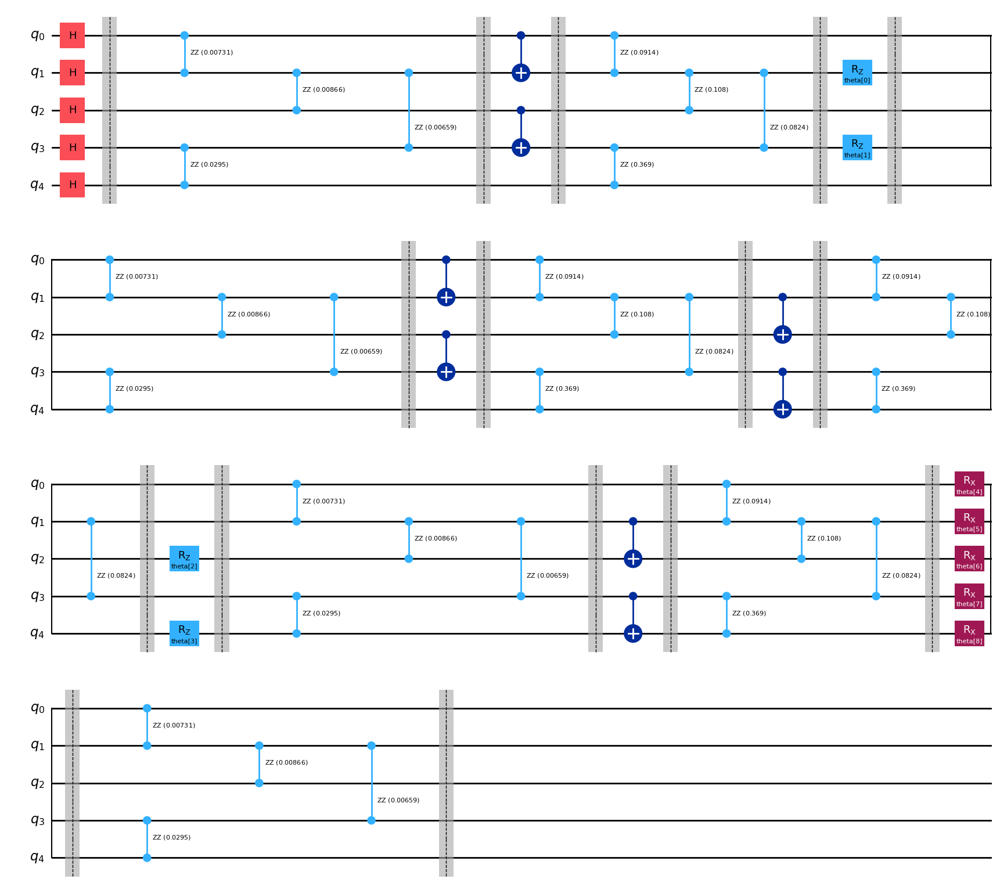

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

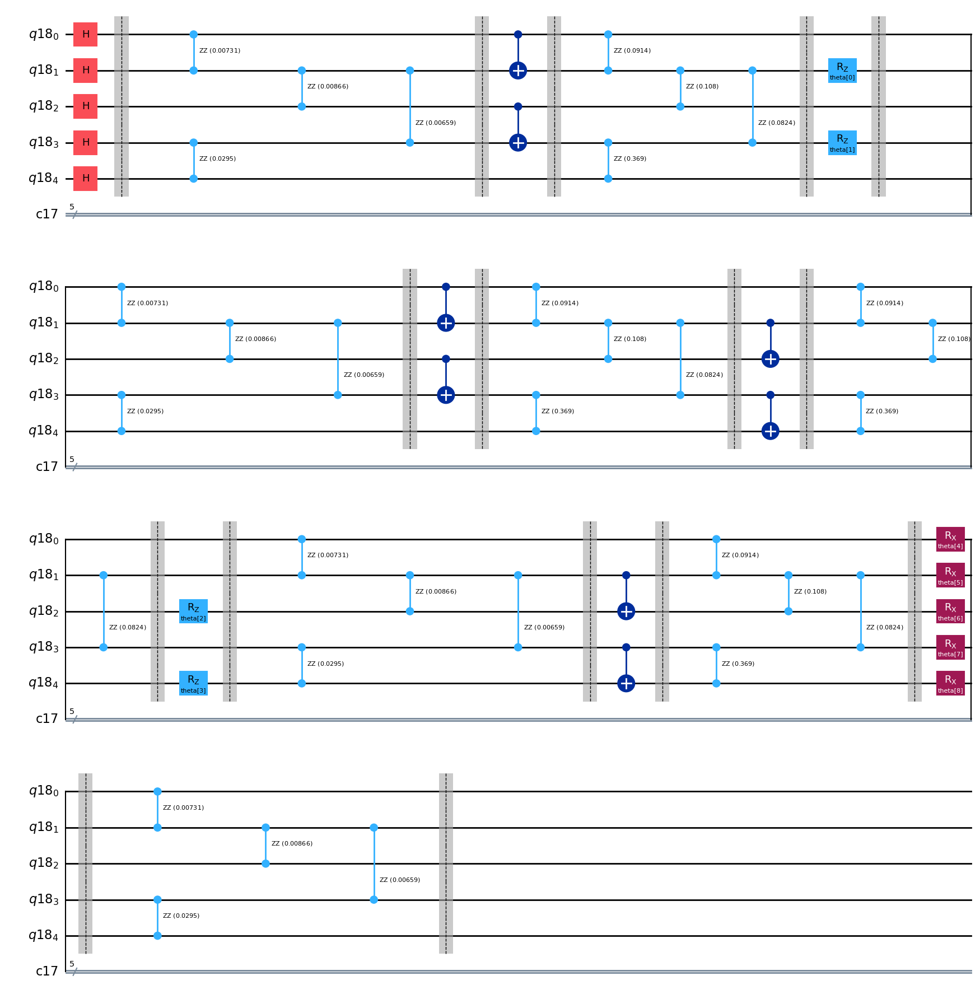

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

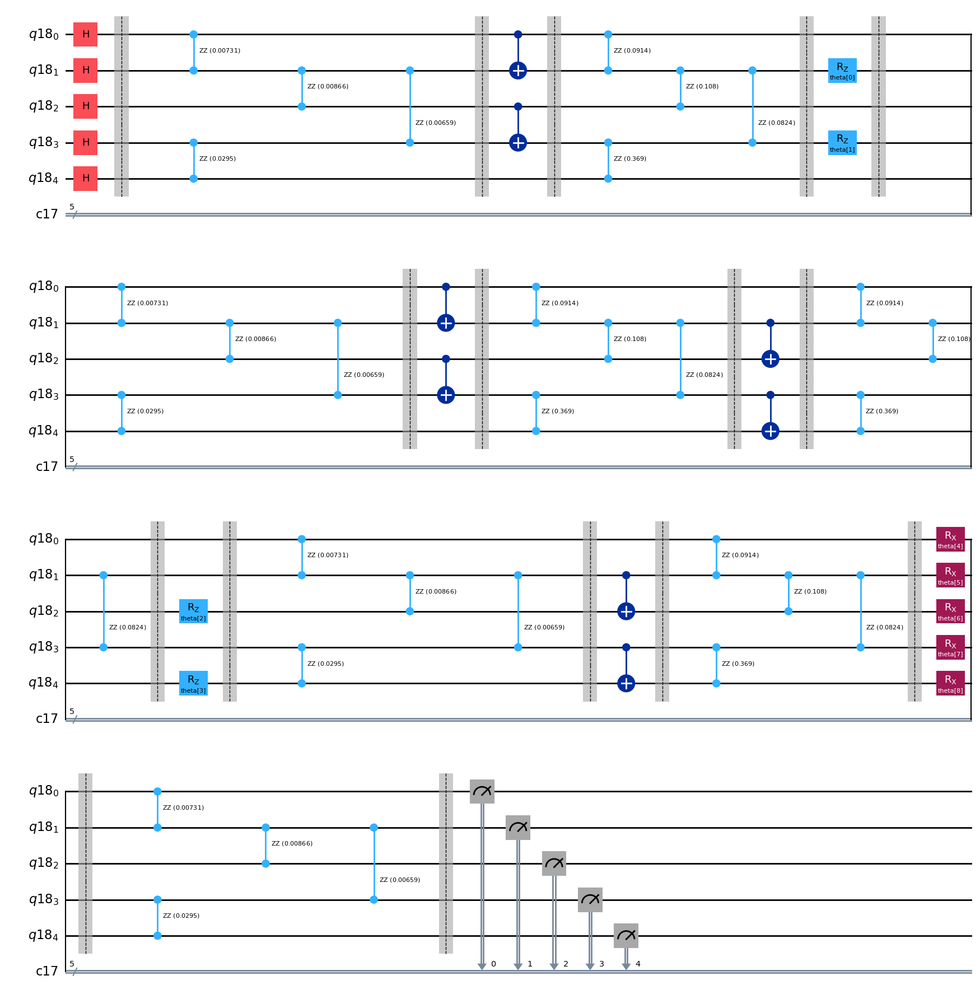

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

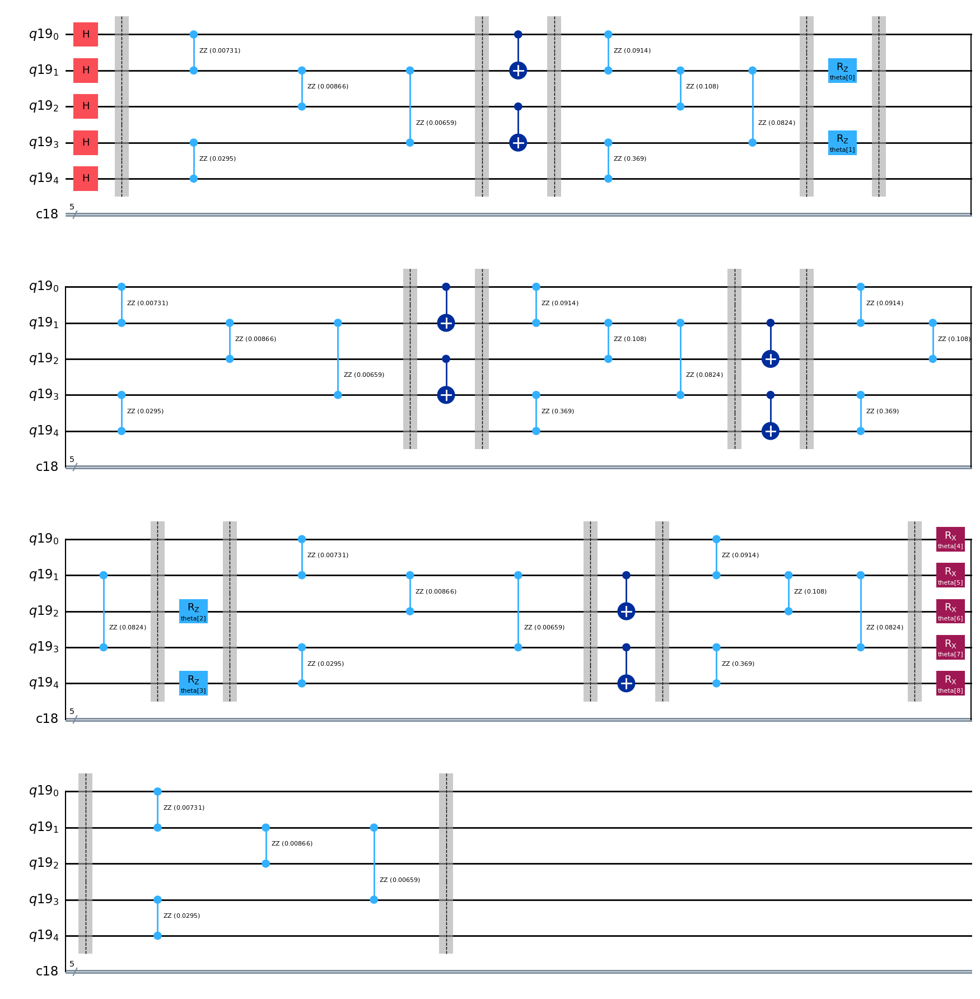

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

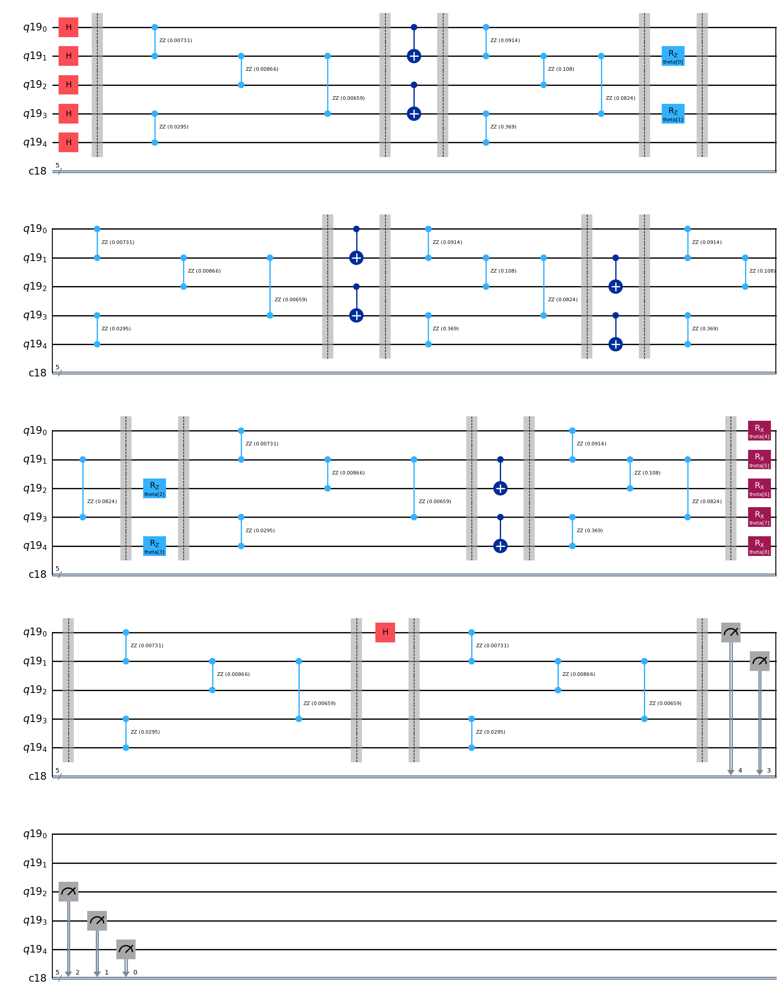

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

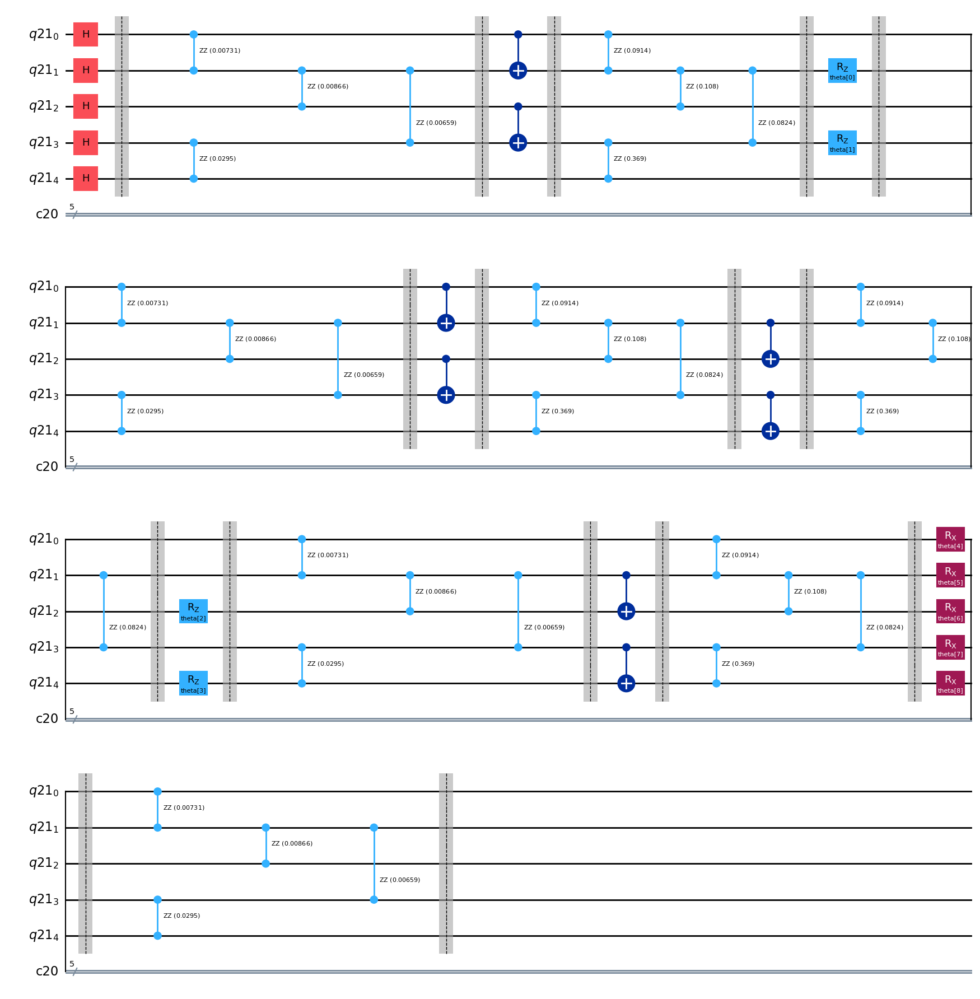

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

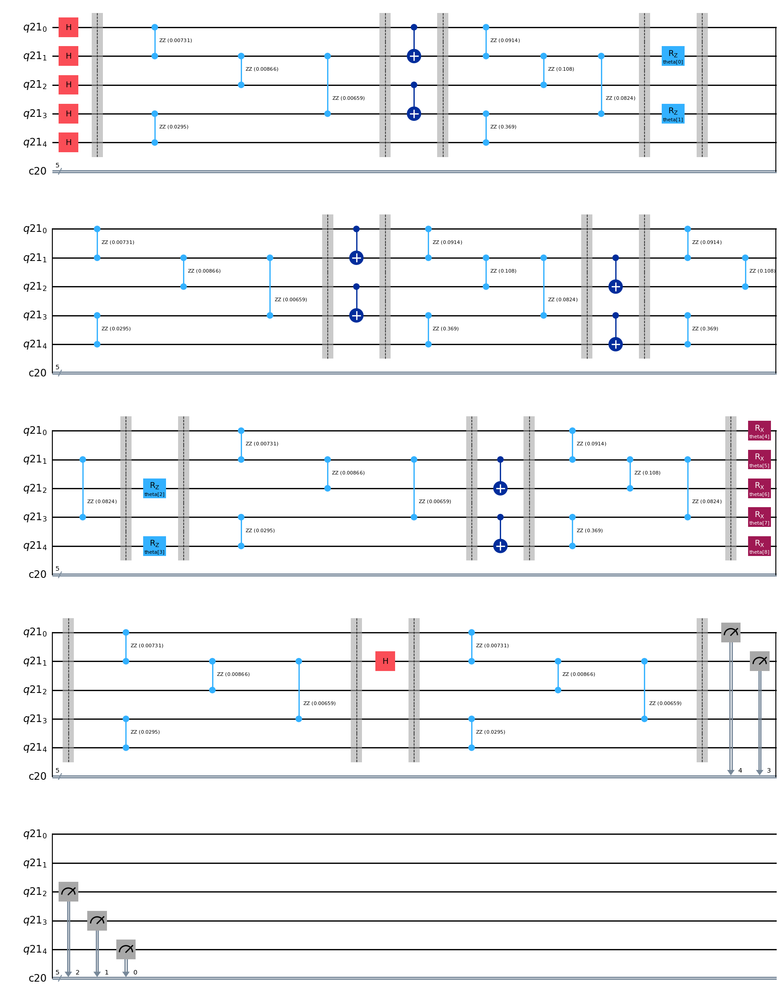

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

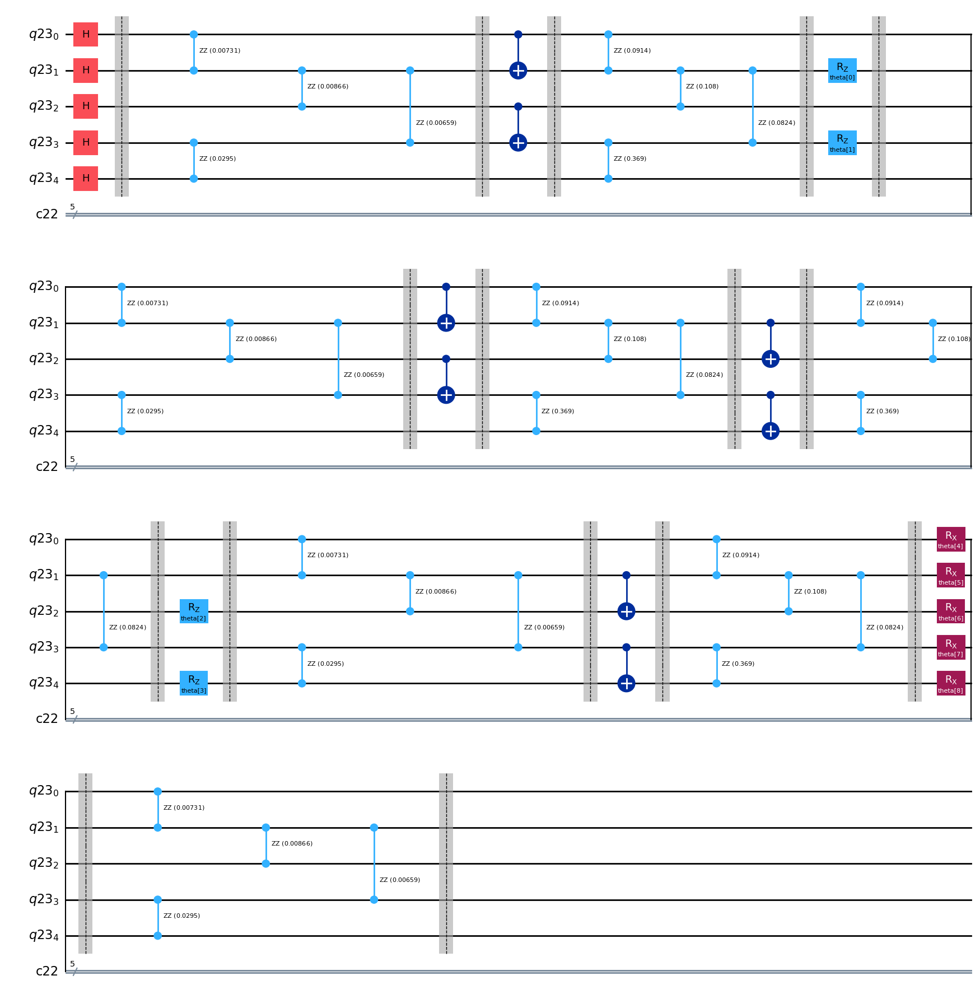

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

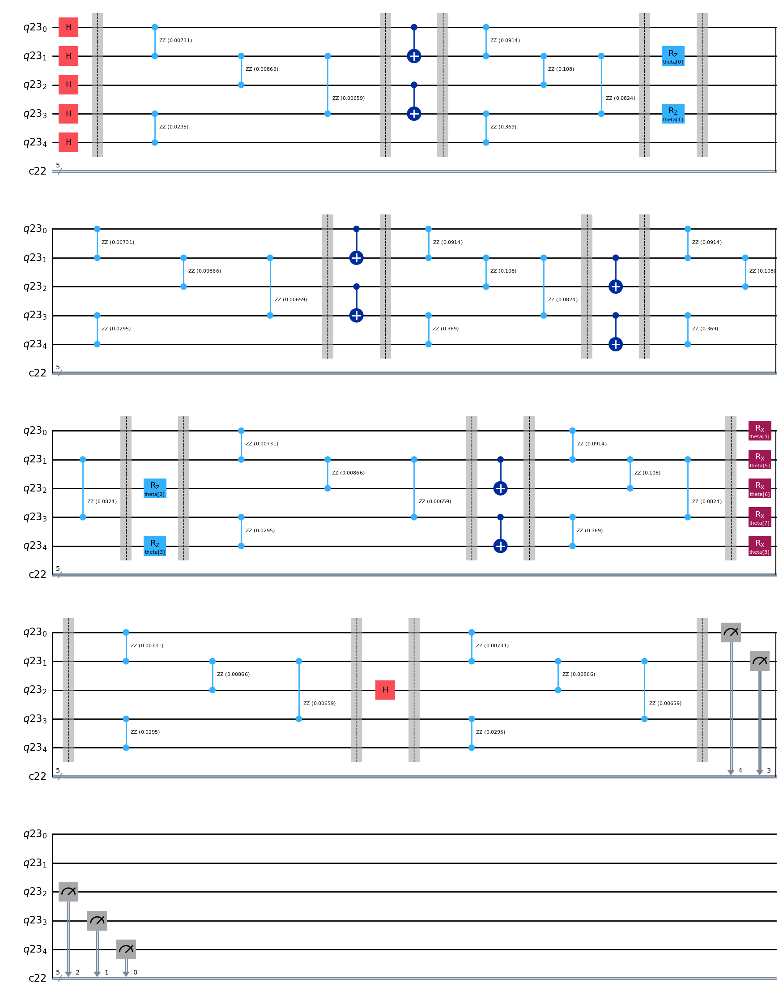

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

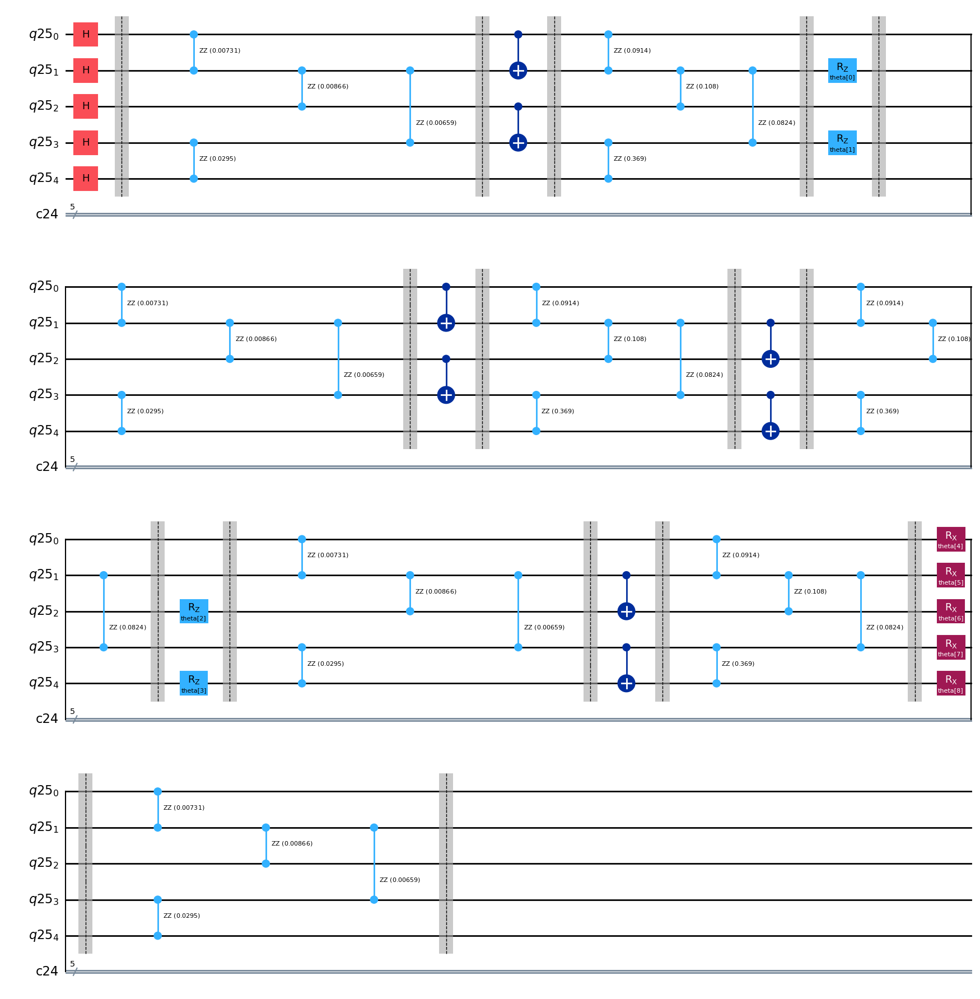

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

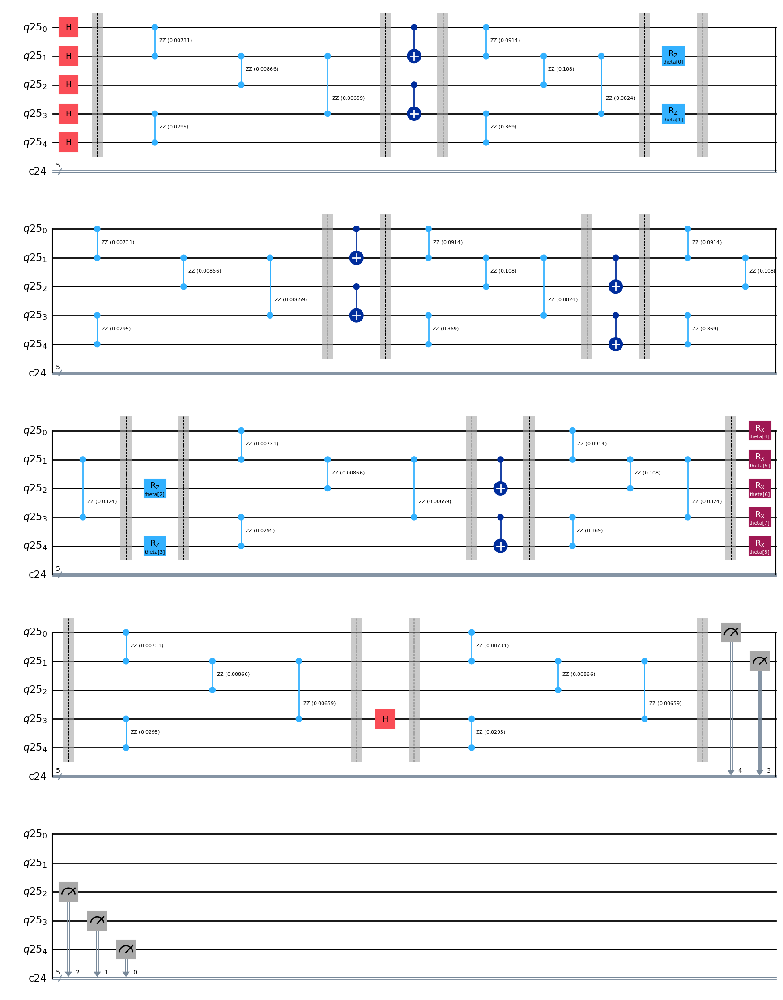

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

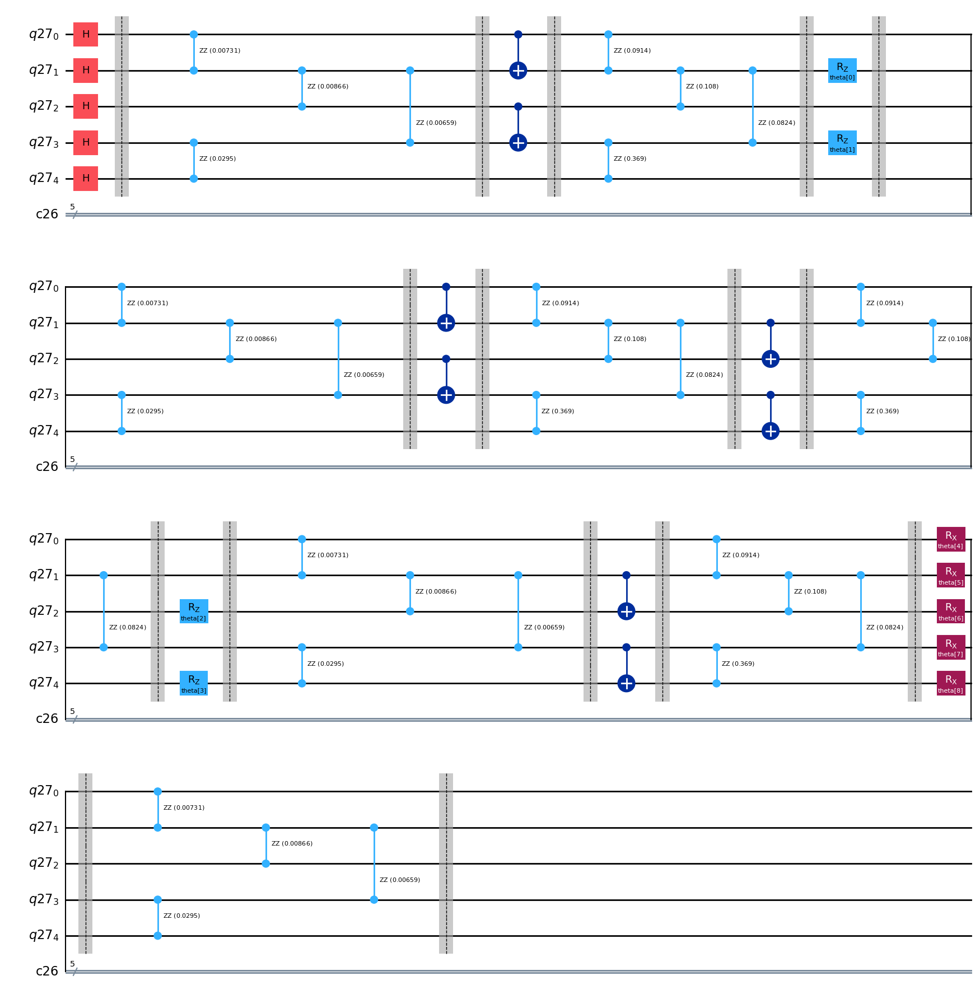

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

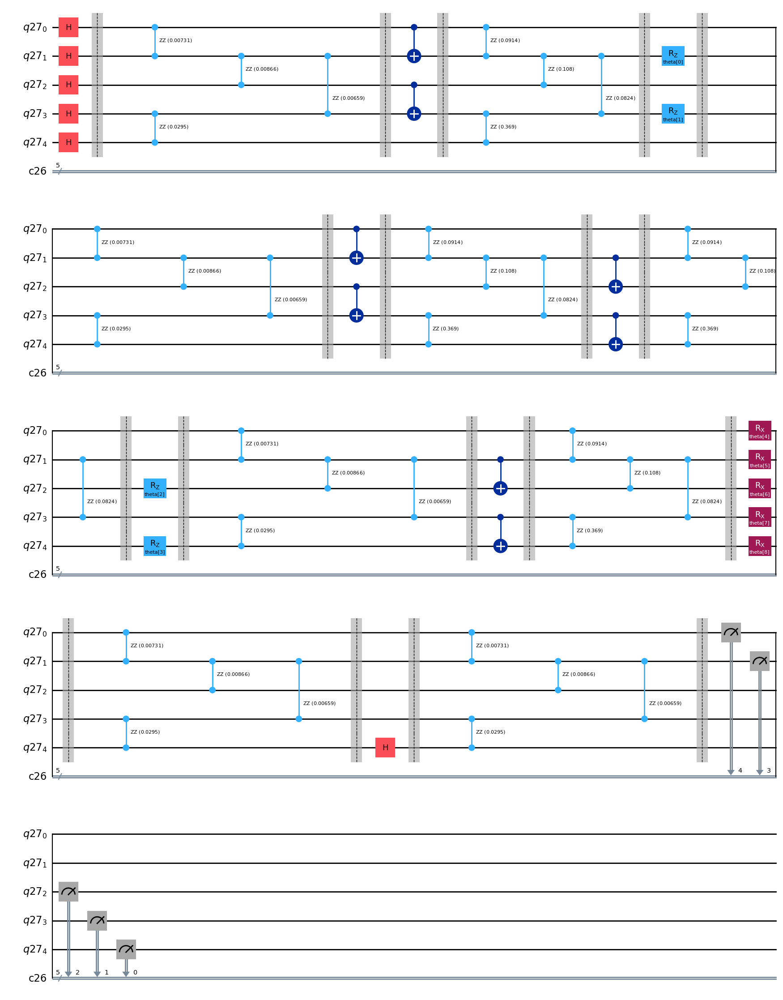

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-5.2970000000000015
-5.266400000000001
-3.2542000000000004
-3.257199999999999
-5.4574
-5.408799999999999
-5.424599999999999
-5.377400000000001
-5.431800000000001
-3.260999999999999
-5.2742
-5.4804
-5.4152000000000005
-5.4281999999999995
-5.398600000000002
-5.464199999999999
-3.2750000000000004
-2.7452000000000005
-2.8894000000000006
-5.2426


In [ ]:
lowest_energy_vqe

-5.4804

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-5.2970000000000015
-5.266400000000001
-3.2542000000000004
-3.257199999999999
-5.4574
-5.408799999999999
-5.424599999999999
-5.377400000000001
-5.431800000000001
-3.260999999999999
-5.2742
-5.4804
-5.4152000000000005
-5.4281999999999995
-5.398600000000002
-5.464199999999999
-3.2750000000000004
-2.7452000000000005
-2.8894000000000006
-5.2426
Optimization terminated successfully.
         Current function value: -6.655747
         Iterations: 275
         Function evaluations: 2730
         Gradient evaluations: 390


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655746
         Iterations: 258
         Function evaluations: 2632
         Gradient evaluations: 376


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655744
         Iterations: 213
         Function evaluations: 2161
         Gradient evaluations: 307
Optimization terminated successfully.
         Current function value: -6.655744
         Iterations: 232
         Function evaluations: 2170
         Gradient evaluations: 310


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655746
         Iterations: 256
         Function evaluations: 2873
         Gradient evaluations: 409


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655744
         Iterations: 203
         Function evaluations: 1964
         Gradient evaluations: 279


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655746
         Iterations: 228
         Function evaluations: 2266
         Gradient evaluations: 322
Optimization terminated successfully.
         Current function value: -6.655747
         Iterations: 251
         Function evaluations: 2366
         Gradient evaluations: 338


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655744
         Iterations: 205
         Function evaluations: 2209
         Gradient evaluations: 314
Optimization terminated successfully.
         Current function value: -6.655740
         Iterations: 191
         Function evaluations: 1869
         Gradient evaluations: 267


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655747
         Iterations: 283
         Function evaluations: 2963
         Gradient evaluations: 422


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655743
         Iterations: 202
         Function evaluations: 1900
         Gradient evaluations: 270


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655741
         Iterations: 211
         Function evaluations: 2539
         Gradient evaluations: 361


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655744
         Iterations: 202
         Function evaluations: 2139
         Gradient evaluations: 304


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655746
         Iterations: 233
         Function evaluations: 2308
         Gradient evaluations: 328


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655746
         Iterations: 222
         Function evaluations: 2369
         Gradient evaluations: 337


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655746
         Iterations: 266
         Function evaluations: 2737
         Gradient evaluations: 391


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655747
         Iterations: 217
         Function evaluations: 2390
         Gradient evaluations: 340
Optimization terminated successfully.
         Current function value: -6.655745
         Iterations: 221
         Function evaluations: 2114
         Gradient evaluations: 302
         Current function value: -6.655747
         Iterations: 228
         Function evaluations: 2595
         Gradient evaluations: 369


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.655747349960823

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-5.2970000000000015
-5.266400000000001
-3.2542000000000004
-3.257199999999999
-5.4574
-5.408799999999999
-5.424599999999999
-5.377400000000001
-5.431800000000001
-3.260999999999999
-5.2742
-5.4804
-5.4152000000000005
-5.4281999999999995
-5.398600000000002
-5.464199999999999
-3.2750000000000004
-2.7452000000000005
-2.8894000000000006
-5.2426


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.011986
         Iterations: 170
         Function evaluations: 7915
         Gradient evaluations: 247


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.826491
         Iterations: 300
         Function evaluations: 13184
         Gradient evaluations: 412


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.820499
         Iterations: 180
         Function evaluations: 12940
         Gradient evaluations: 404


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.012890
         Iterations: 229
         Function evaluations: 11530
         Gradient evaluations: 360


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.027779
         Iterations: 297
         Function evaluations: 13996
         Gradient evaluations: 437


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.960813
         Iterations: 159
         Function evaluations: 7936
         Gradient evaluations: 248


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.997390
         Iterations: 267
         Function evaluations: 12908
         Gradient evaluations: 403
Optimization terminated successfully.
         Current function value: -7.031155
         Iterations: 129
         Function evaluations: 5824
         Gradient evaluations: 182


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.007693
         Iterations: 269
         Function evaluations: 15148
         Gradient evaluations: 473


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.895525
         Iterations: 300
         Function evaluations: 10816
         Gradient evaluations: 338


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.041907
         Iterations: 148
         Function evaluations: 8812
         Gradient evaluations: 275


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.505122
         Iterations: 300
         Function evaluations: 21504
         Gradient evaluations: 672
         Current function value: -7.031872
         Iterations: 300
         Function evaluations: 12000
         Gradient evaluations: 375
         Current function value: -7.012752
         Iterations: 300
         Function evaluations: 11328
         Gradient evaluations: 354
         Current function value: -7.025185
         Iterations: 300
         Function evaluations: 11680
         Gradient evaluations: 365
         Current function value: -6.939295
         Iterations: 300
         Function evaluations: 12256
         Gradient evaluations: 383
         Current function value: -6.971174
         Iterations: 300
         Function evaluations: 12928
         Gradient evaluations: 404


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.969689
         Iterations: 84
         Function evaluations: 5675
         Gradient evaluations: 177


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.966463
         Iterations: 300
         Function evaluations: 12416
         Gradient evaluations: 388
         Current function value: -6.939492
         Iterations: 284
         Function evaluations: 13706
         Gradient evaluations: 428


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-7.041906949151377

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-5.2970000000000015
-5.266400000000001
-3.2542000000000004
-3.257199999999999
-5.4574
-5.408799999999999
-5.424599999999999
-5.377400000000001
-5.431800000000001
-3.260999999999999
-5.2742
-5.4804
-5.4152000000000005
-5.4281999999999995
-5.398600000000002
-5.464199999999999
-3.2750000000000004
-2.7452000000000005
-2.8894000000000006
-5.2426


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.982384
         Iterations: 195
         Function evaluations: 17335
         Gradient evaluations: 304


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.046514
         Iterations: 197
         Function evaluations: 17276
         Gradient evaluations: 303


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.837264
         Iterations: 300
         Function evaluations: 20577
         Gradient evaluations: 361


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.691299
         Iterations: 140
         Function evaluations: 14318
         Gradient evaluations: 251


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.052090
         Iterations: 300
         Function evaluations: 23313
         Gradient evaluations: 409
         Current function value: -7.039858
         Iterations: 300
         Function evaluations: 25308
         Gradient evaluations: 444


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.821926
         Iterations: 168
         Function evaluations: 13862
         Gradient evaluations: 243


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.954405
         Iterations: 300
         Function evaluations: 20976
         Gradient evaluations: 368


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.028288
         Iterations: 223
         Function evaluations: 18192
         Gradient evaluations: 319
Optimization terminated successfully.
         Current function value: -7.055457
         Iterations: 289
         Function evaluations: 18183
         Gradient evaluations: 319


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.025591
         Iterations: 247
         Function evaluations: 23778
         Gradient evaluations: 417


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.944119
         Iterations: 176
         Function evaluations: 18537
         Gradient evaluations: 325


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.055063
         Iterations: 300
         Function evaluations: 21945
         Gradient evaluations: 385


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.049905
         Iterations: 272
         Function evaluations: 24345
         Gradient evaluations: 427


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.018611
         Iterations: 91
         Function evaluations: 9295
         Gradient evaluations: 163


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.813318
         Iterations: 80
         Function evaluations: 9873
         Gradient evaluations: 173


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.002757
         Iterations: 300
         Function evaluations: 22002
         Gradient evaluations: 386


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.042060
         Iterations: 158
         Function evaluations: 15339
         Gradient evaluations: 269


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.036021
         Iterations: 300
         Function evaluations: 29868
         Gradient evaluations: 524
         Current function value: -7.050783
         Iterations: 166
         Function evaluations: 15113
         Gradient evaluations: 265


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-7.055456669324186

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-5.2970000000000015
-5.266400000000001
-3.2542000000000004
-3.257199999999999
-5.4574
-5.408799999999999
-5.424599999999999
-5.377400000000001
-5.431800000000001
-3.260999999999999
-5.2742
-5.4804
-5.4152000000000005
-5.4281999999999995
-5.398600000000002
-5.464199999999999
-3.2750000000000004
-2.7452000000000005
-2.8894000000000006
-5.2426


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.759187
         Iterations: 48
         Function evaluations: 3496
         Gradient evaluations: 134
Optimization terminated successfully.
         Current function value: -5.783643
         Iterations: 43
         Function evaluations: 2184
         Gradient evaluations: 84
Optimization terminated successfully.
         Current function value: -5.807148
         Iterations: 113
         Function evaluations: 5278
         Gradient evaluations: 203
Optimization terminated successfully.
         Current function value: -5.512692
         Iterations: 50
         Function evaluations: 2834
         Gradient evaluations: 109
Optimization terminated successfully.
         Current function value: -5.701188
         Iterations: 39
         Function evaluations: 1534
         Gradient evaluations: 59


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.757604
         Iterations: 25
         Function evaluations: 3704
         Gradient evaluations: 142
Optimization terminated successfully.
         Current function value: -5.786416
         Iterations: 36
         Function evaluations: 1950
         Gradient evaluations: 75
Optimization terminated successfully.
         Current function value: -5.491209
         Iterations: 22
         Function evaluations: 598
         Gradient evaluations: 23


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.824757
         Iterations: 137
         Function evaluations: 7471
         Gradient evaluations: 287


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.763405
         Iterations: 72
         Function evaluations: 5674
         Gradient evaluations: 218
Optimization terminated successfully.
         Current function value: -5.770364
         Iterations: 41
         Function evaluations: 1222
         Gradient evaluations: 47
Optimization terminated successfully.
         Current function value: -5.643207
         Iterations: 26
         Function evaluations: 832
         Gradient evaluations: 32


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.748401
         Iterations: 46
         Function evaluations: 1768
         Gradient evaluations: 68
Optimization terminated successfully.
         Current function value: -5.491209
         Iterations: 13
         Function evaluations: 364
         Gradient evaluations: 14


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.823135
         Iterations: 129
         Function evaluations: 4862
         Gradient evaluations: 187
Optimization terminated successfully.
         Current function value: -5.793895
         Iterations: 29
         Function evaluations: 936
         Gradient evaluations: 36
Optimization terminated successfully.
         Current function value: -5.599611
         Iterations: 64
         Function evaluations: 1898
         Gradient evaluations: 73


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.587342
         Iterations: 63
         Function evaluations: 5858
         Gradient evaluations: 225
Optimization terminated successfully.
         Current function value: -5.757537
         Iterations: 28
         Function evaluations: 1534
         Gradient evaluations: 59
         Current function value: -5.610349
         Iterations: 14
         Function evaluations: 1884
         Gradient evaluations: 72


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-5.824757109303316

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-5.2970000000000015
-5.266400000000001
-3.2542000000000004
-3.257199999999999
-5.4574
-5.408799999999999
-5.424599999999999
-5.377400000000001
-5.431800000000001
-3.260999999999999
-5.2742
-5.4804
-5.4152000000000005
-5.4281999999999995
-5.398600000000002
-5.464199999999999
-3.2750000000000004
-2.7452000000000005
-2.8894000000000006
-5.2426


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.766186
         Iterations: 38
         Function evaluations: 4180
         Gradient evaluations: 76
Optimization terminated successfully.
         Current function value: -5.783643
         Iterations: 24
         Function evaluations: 1485
         Gradient evaluations: 27


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.727734
         Iterations: 263
         Function evaluations: 22672
         Gradient evaluations: 412


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.643052
         Iterations: 19
         Function evaluations: 4077
         Gradient evaluations: 74
Optimization terminated successfully.
         Current function value: -5.491209
         Iterations: 20
         Function evaluations: 1210
         Gradient evaluations: 22
Optimization terminated successfully.
         Current function value: -5.757627
         Iterations: 24
         Function evaluations: 1595
         Gradient evaluations: 29
Optimization terminated successfully.
         Current function value: -5.786416
         Iterations: 35
         Function evaluations: 2255
         Gradient evaluations: 41


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.714213
         Iterations: 78
         Function evaluations: 11452
         Gradient evaluations: 208


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.499459
         Iterations: 4
         Function evaluations: 4027
         Gradient evaluations: 73
Optimization terminated successfully.
         Current function value: -5.866383
         Iterations: 106
         Function evaluations: 8305
         Gradient evaluations: 151


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.823057
         Iterations: 82
         Function evaluations: 8370
         Gradient evaluations: 152
Optimization terminated successfully.
         Current function value: -5.629674
         Iterations: 15
         Function evaluations: 1265
         Gradient evaluations: 23


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.720208
         Iterations: 35
         Function evaluations: 5176
         Gradient evaluations: 94


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.506856
         Iterations: 9
         Function evaluations: 6062
         Gradient evaluations: 110
Optimization terminated successfully.
         Current function value: -5.691545
         Iterations: 17
         Function evaluations: 1265
         Gradient evaluations: 23
Optimization terminated successfully.
         Current function value: -5.793895
         Iterations: 26
         Function evaluations: 1760
         Gradient evaluations: 32


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.513936
         Iterations: 8
         Function evaluations: 5237
         Gradient evaluations: 95


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.630527
         Iterations: 154
         Function evaluations: 14257
         Gradient evaluations: 259


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.698830
         Iterations: 28
         Function evaluations: 4955
         Gradient evaluations: 90
Optimization terminated successfully.
         Current function value: -5.538006
         Iterations: 16
         Function evaluations: 1265
         Gradient evaluations: 23


In [ ]:
lowest_energy_vqnhe

-5.866383232221939

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 3MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 3MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.003                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23209565 5.13790435]
[10.16018425 10.37013082  9.97055493]
0.00013082397420927094
[5.13805998 4.98794002]
[ 9.9704843  10.12615504  9.66841066]
0.00015504130522803194
[4.98767068 5.01532932]
[ 9.66839615 10.00311805  9.7229458 ]
0.00011804555643379899
[5.0149663 5.2820337]
[ 9.72297864 10.29752416 10.2605072 ]
0.0005241553589732106


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(6.541198710463547e-05,
 7.752065261401597e-05,
 5.9022778216899496e-05,
 0.0002620776794866053)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

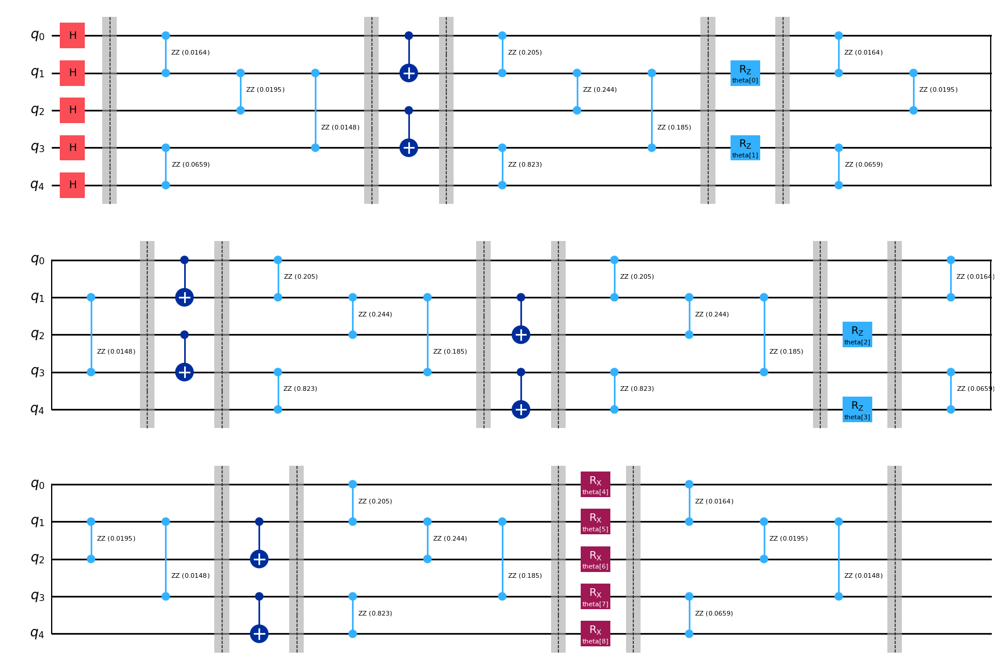

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

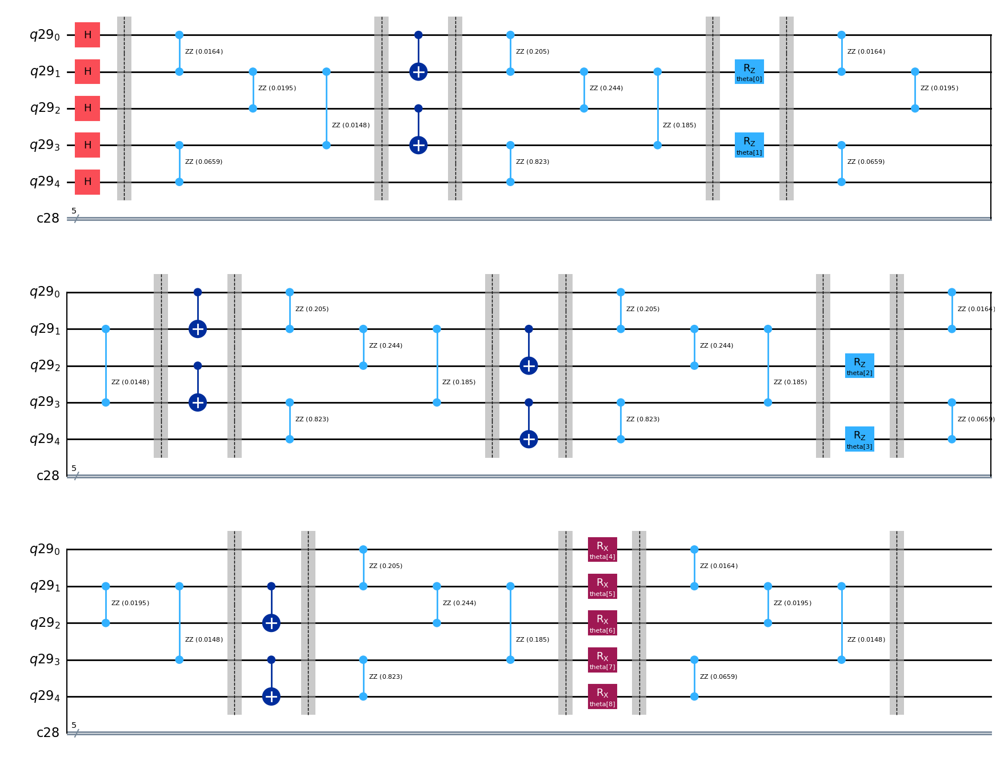

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

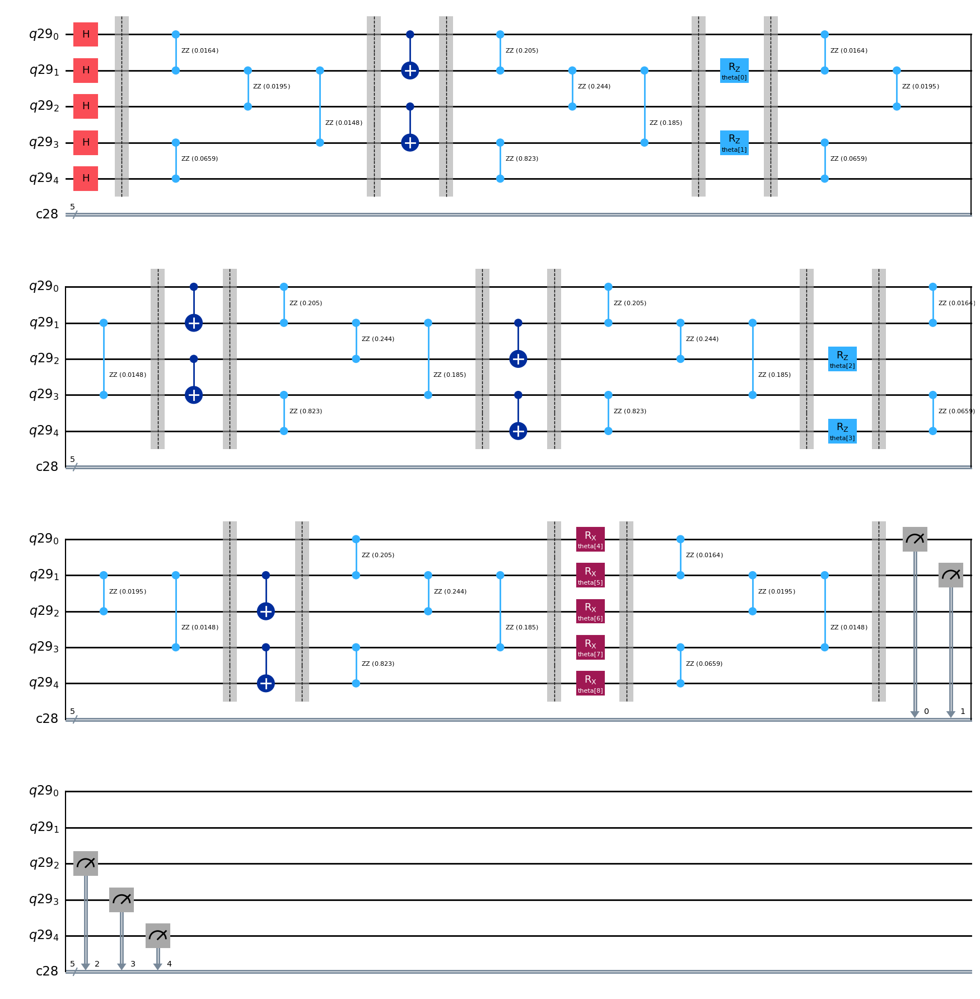

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

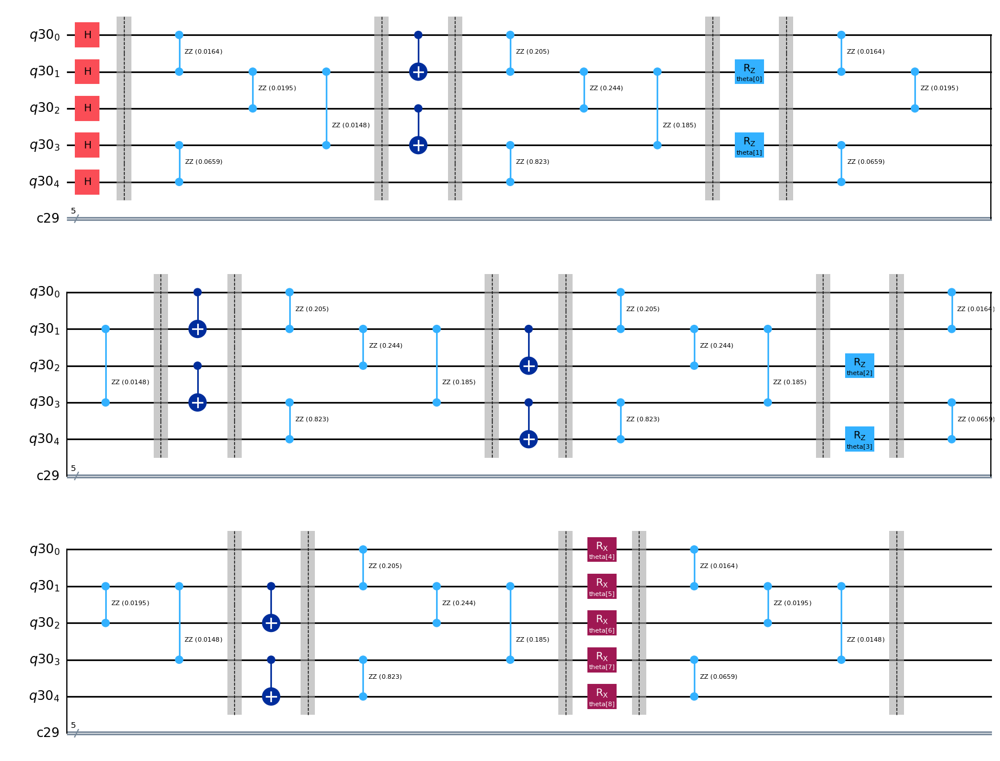

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

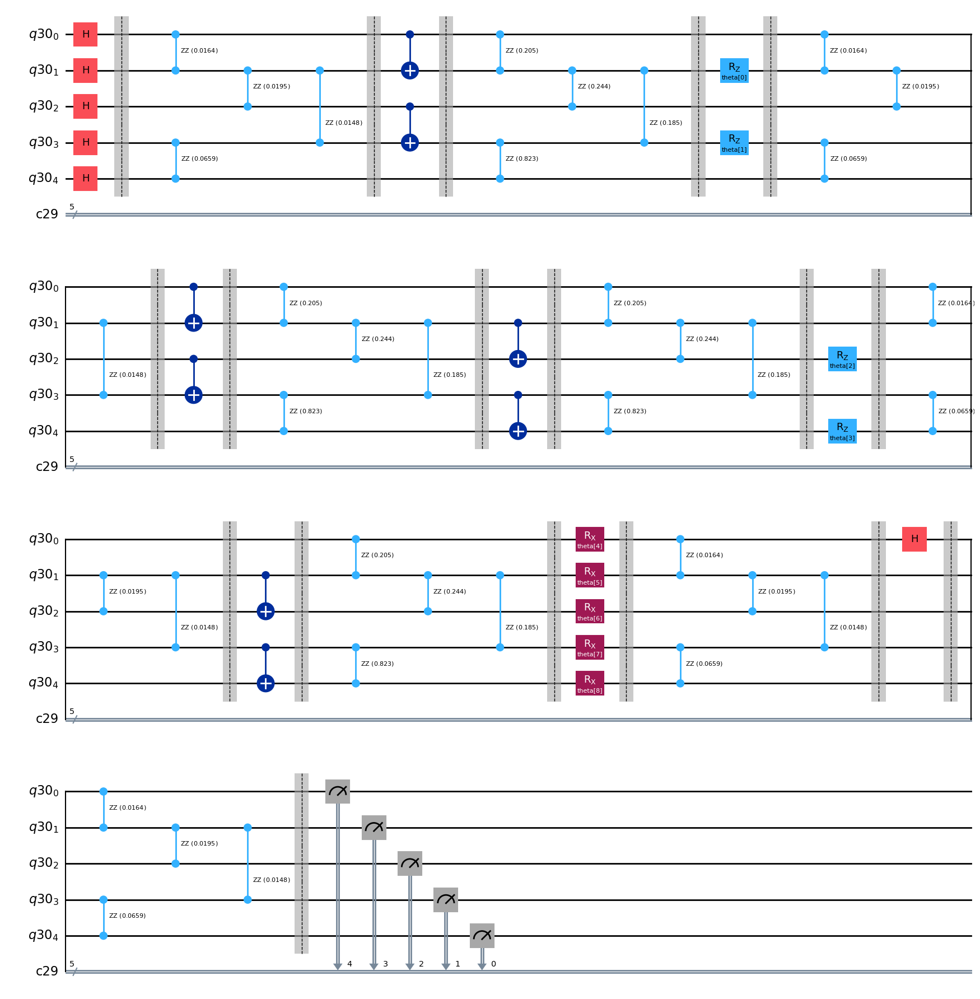

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

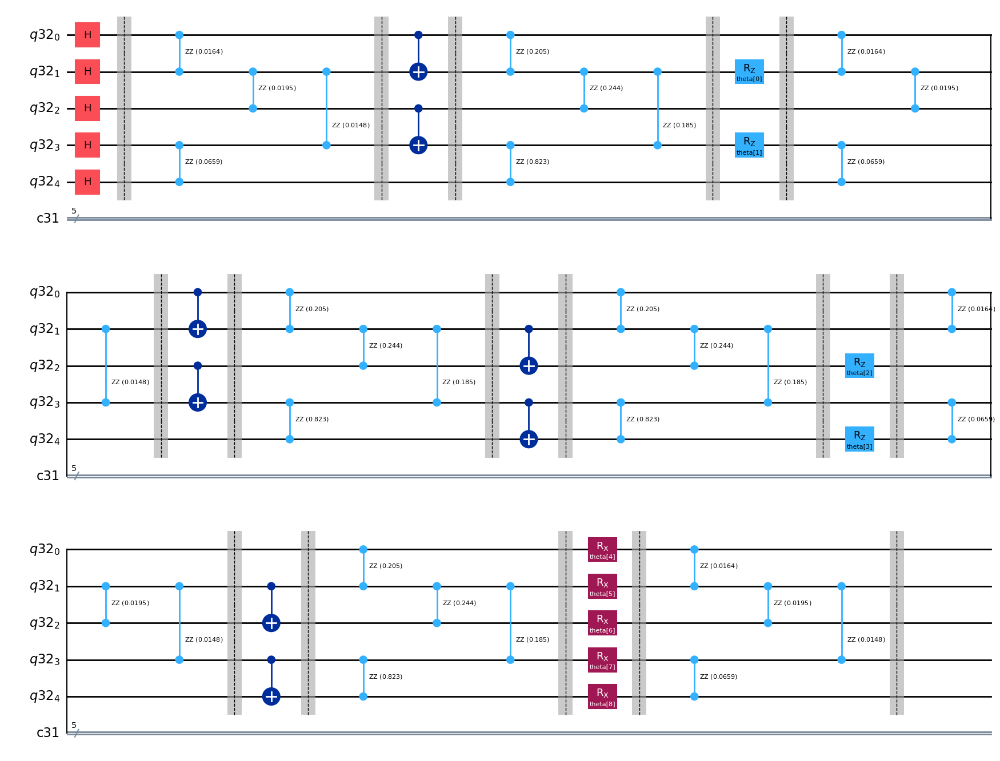

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

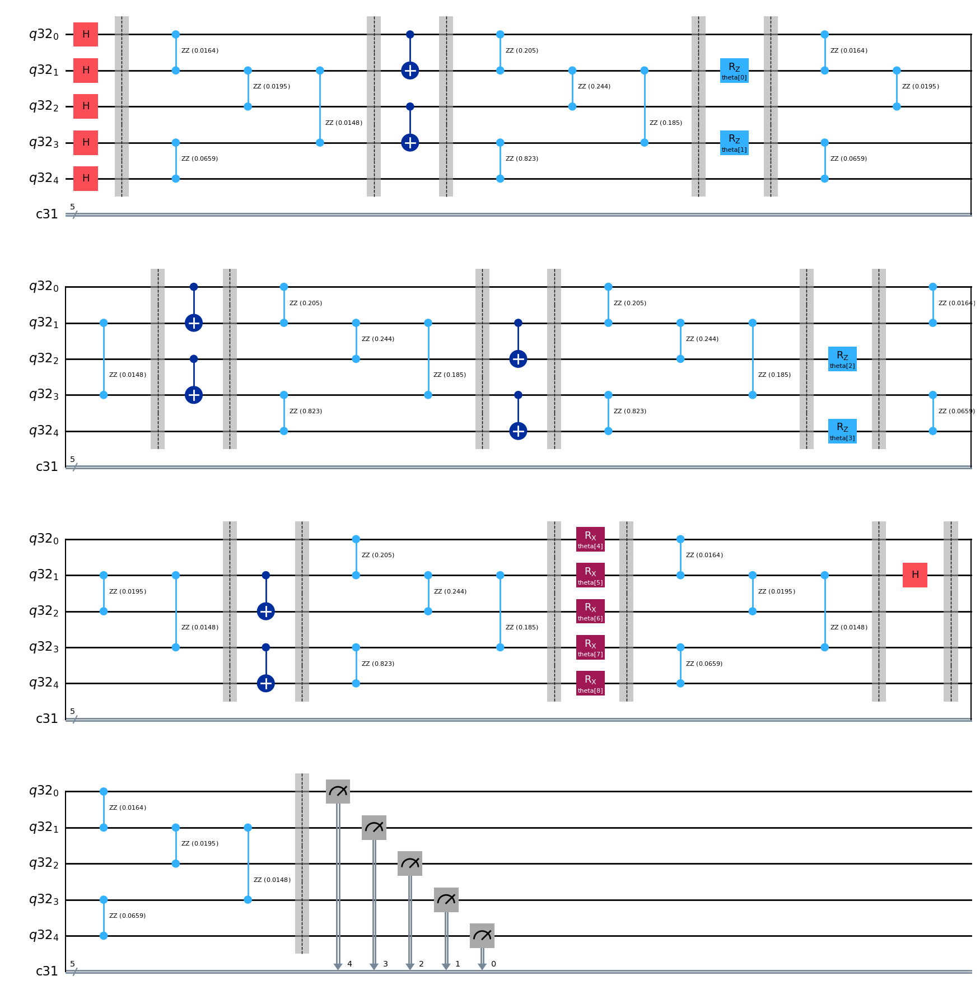

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

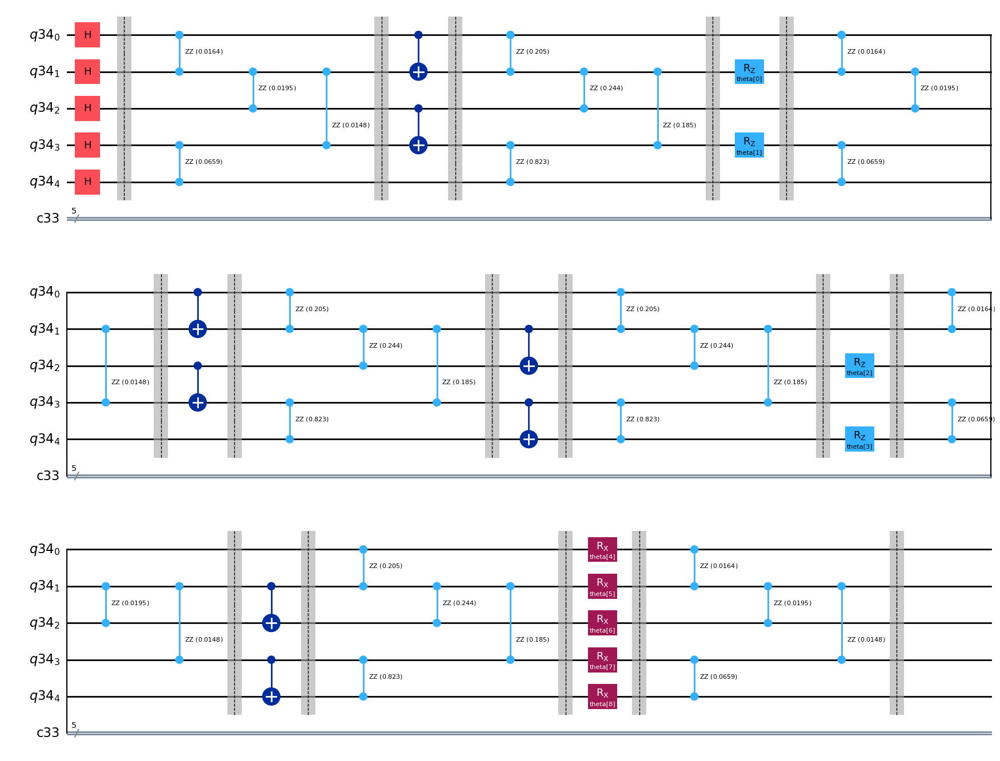

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

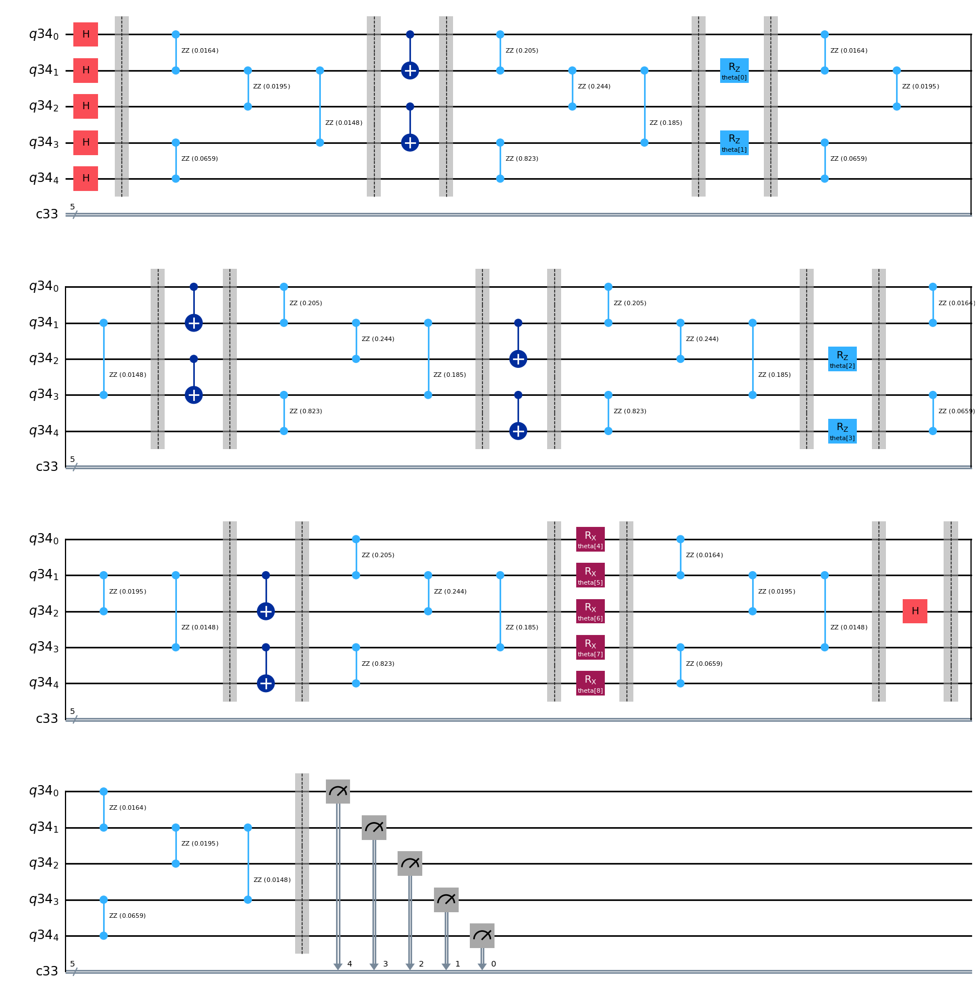

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

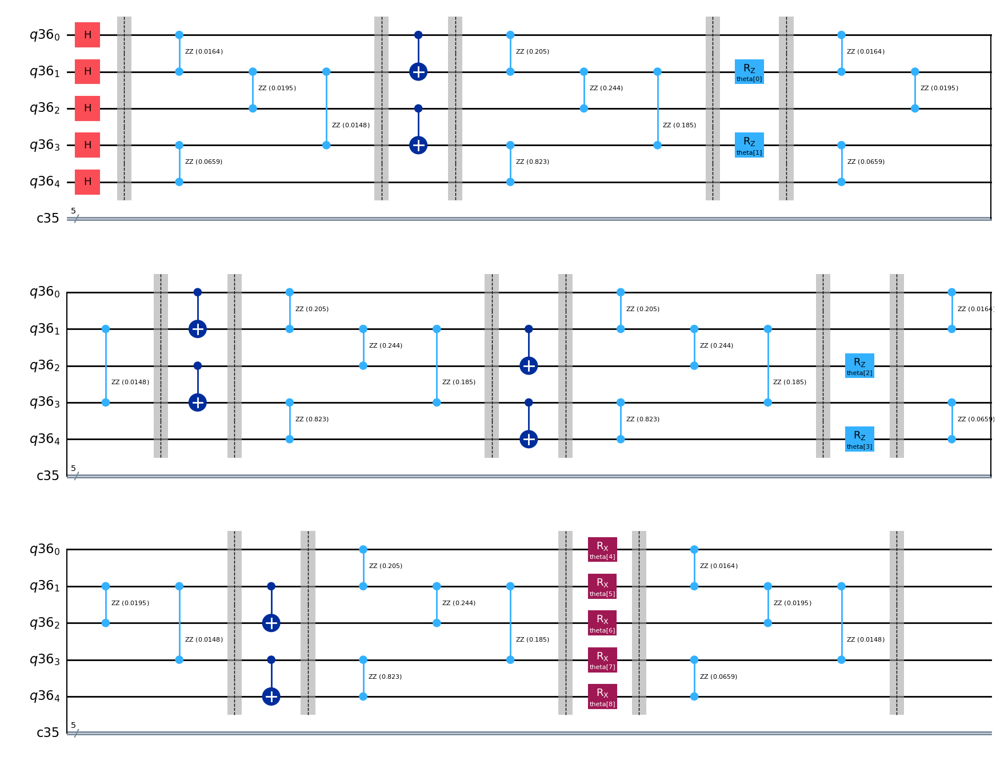

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

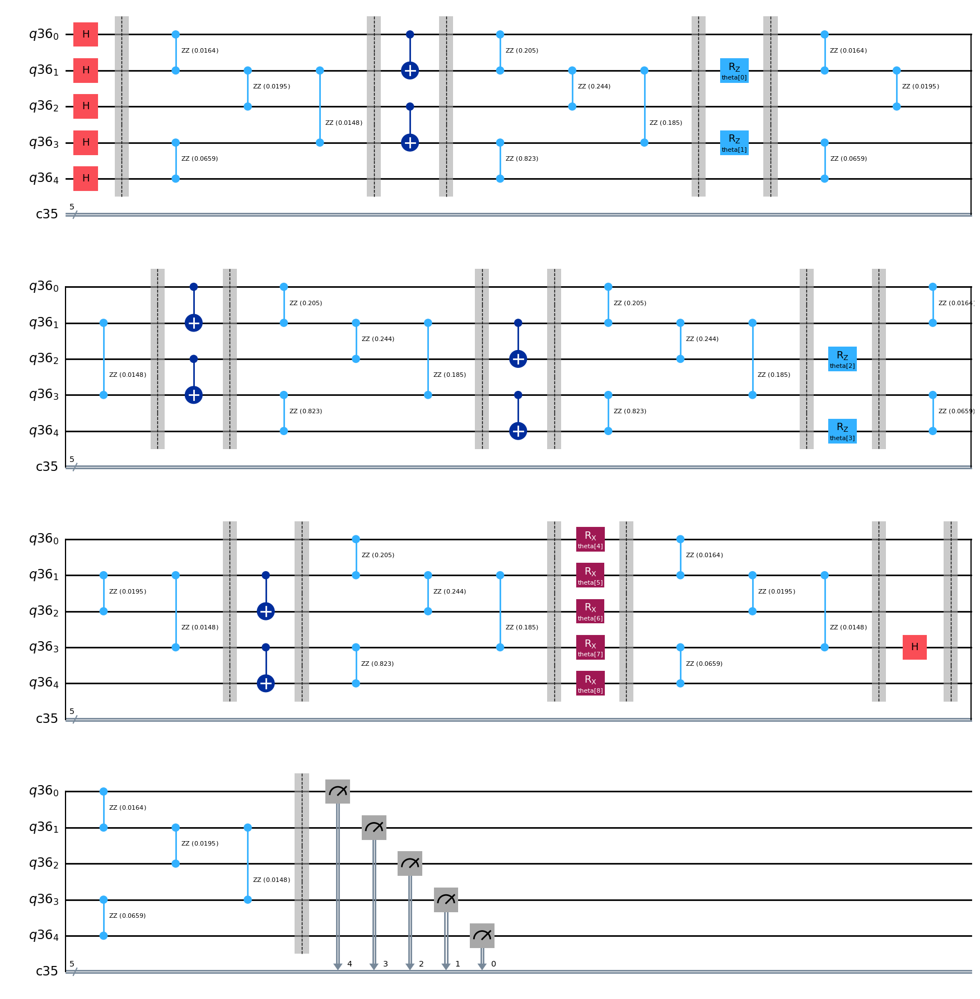

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

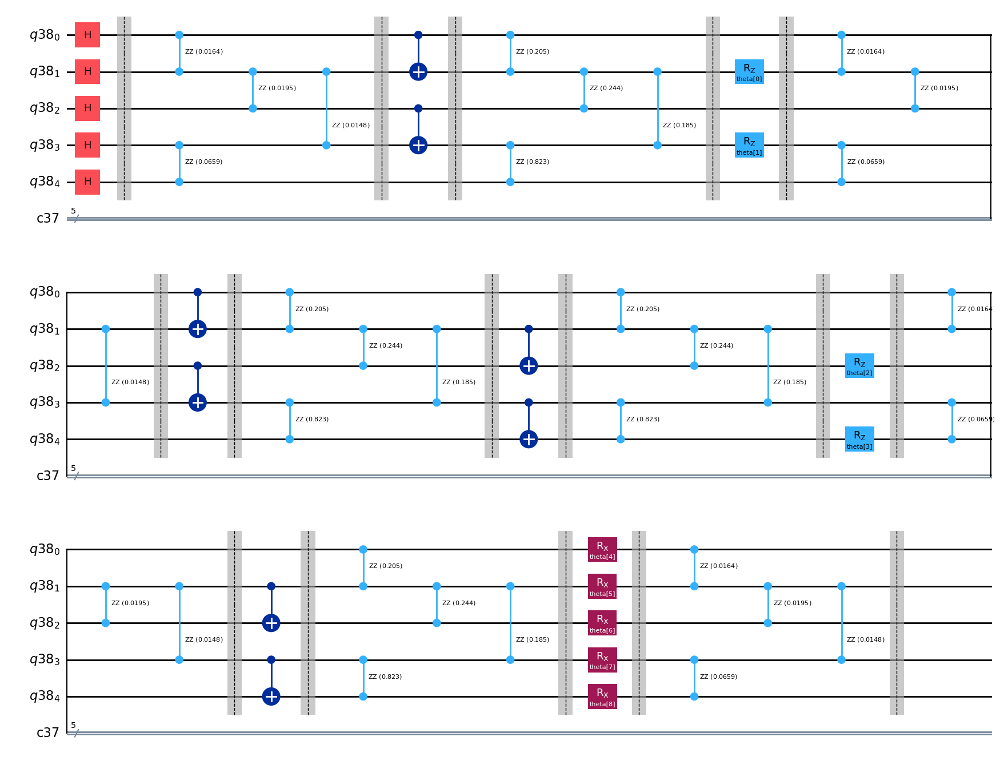

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

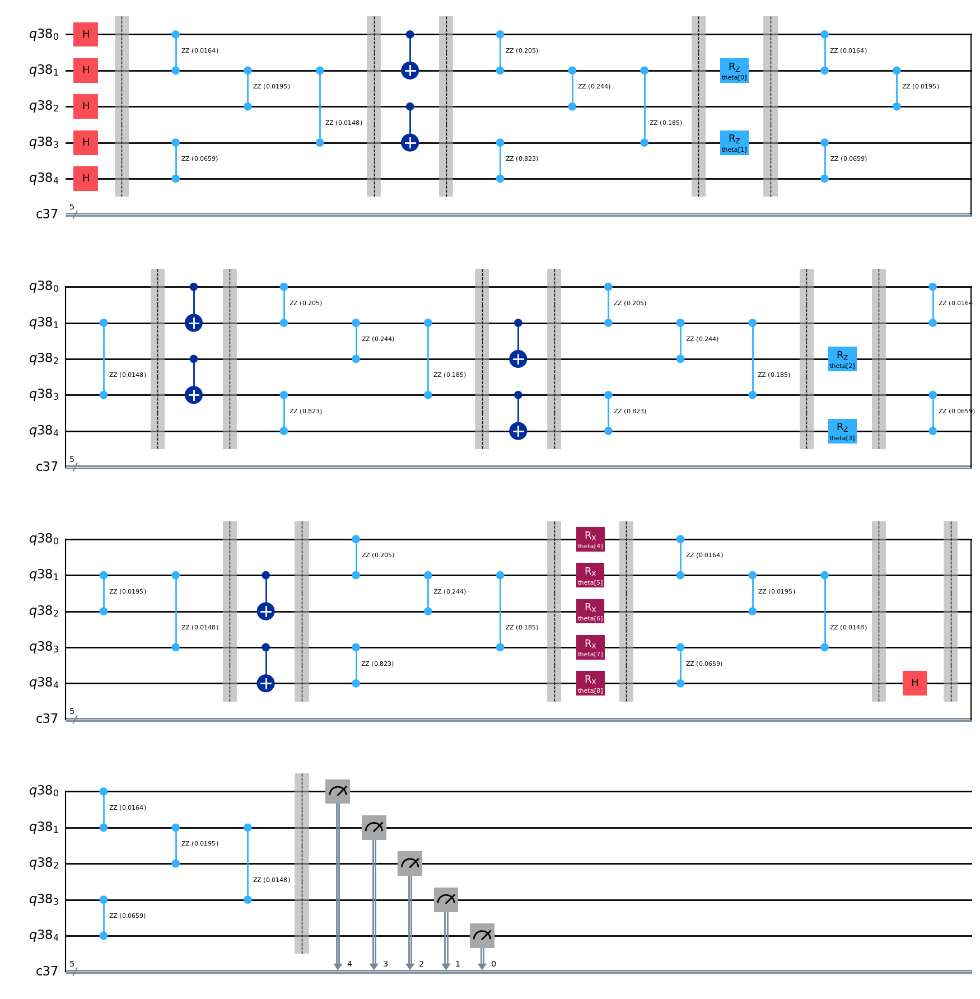

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-3.9321999999999995
-2.5502000000000002
-1.8623999999999996
-2.2144
-3.7720000000000002
-3.9786000000000006
-3.9640000000000004
-4.019399999999999
-4.0126
-2.101
-3.9644000000000004
-4.025399999999999
-4.046399999999998
-3.8730000000000007
-3.9948000000000006
-3.6086000000000005
-2.8820000000000006
-2.1300000000000003
-3.7634000000000007
-3.9583999999999997


In [ ]:
lowest_energy_vqe

-4.046399999999998

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.9321999999999995
-2.5502000000000002
-1.8623999999999996
-2.2144
-3.7720000000000002
-3.9786000000000006
-3.9640000000000004
-4.019399999999999
-4.0126
-2.101
-3.9644000000000004
-4.025399999999999
-4.046399999999998
-3.8730000000000007
-3.9948000000000006
-3.6086000000000005
-2.8820000000000006
-2.1300000000000003
-3.7634000000000007
-3.9583999999999997


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in 

         Current function value: nan
         Iterations: 49
         Function evaluations: 1204
         Gradient evaluations: 172


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 45
         Function evaluations: 1106
         Gradient evaluations: 158
Optimization terminated successfully.
         Current function value: -5.218592
         Iterations: 29
         Function evaluations: 252
         Gradient evaluations: 36


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 51
         Function evaluations: 1197
         Gradient evaluations: 171


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:99: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+4]
<ipython-input-159-942dbc8389c9>:103: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 56
         Function evaluations: 1232
         Gradient evaluations: 176
Optimization terminated successfully.
         Current function value: -4.685301
         Iterations: 79
         Function evaluations: 630
         Gradient evaluations: 90
Optimization terminated successfully.
         Current function value: -5.218592
         Iterations: 41
         Function evaluations: 420
         Gradient evaluations: 60


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 58
         Function evaluations: 1316
         Gradient evaluations: 188
Optimization terminated successfully.
         Current function value: -4.529510
         Iterations: 86
         Function evaluations: 777
         Gradient evaluations: 111
Optimization terminated successfully.
         Current function value: -4.685300
         Iterations: 78
         Function evaluations: 665
         Gradient evaluations: 95
Optimization terminated successfully.
         Current function value: -5.218592
         Iterations: 22
         Function evaluations: 196
         Gradient evaluations: 28
Optimization terminated successfully.
         Current function value: -5.218592
         Iterations: 24
         Function evaluations: 175
         Gradient evaluations: 25
Optimization terminated successfully.
         Current function value: -4.538712
         Iterations: 37
         Function evaluations: 280
         Gradient evaluations: 

<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:103: RuntimeWarning: overfl

         Current function value: nan
         Iterations: 54
         Function evaluations: 1190
         Gradient evaluations: 170


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 56
         Function evaluations: 1246
         Gradient evaluations: 178


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:103: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+4]
<ipython-input-159-942dbc8389c9>:124: RuntimeWarning: overfl

         Current function value: nan
         Iterations: 48
         Function evaluations: 1155
         Gradient evaluations: 165
Optimization terminated successfully.
         Current function value: -4.685300
         Iterations: 56
         Function evaluations: 595
         Gradient evaluations: 85


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-159-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-159-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 47
         Function evaluations: 1120
         Gradient evaluations: 160
Optimization terminated successfully.
         Current function value: -5.218592
         Iterations: 39
         Function evaluations: 329
         Gradient evaluations: 47


In [ ]:
lowest_energy_vqnhe

-5.218591654129038

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.9321999999999995
-2.5502000000000002
-1.8623999999999996
-2.2144
-3.7720000000000002
-3.9786000000000006
-3.9640000000000004
-4.019399999999999
-4.0126
-2.101
-3.9644000000000004
-4.025399999999999
-4.046399999999998
-3.8730000000000007
-3.9948000000000006
-3.6086000000000005
-2.8820000000000006
-2.1300000000000003
-3.7634000000000007
-3.9583999999999997


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.077963
         Iterations: 75
         Function evaluations: 5314
         Gradient evaluations: 166


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.557343
         Iterations: 41
         Function evaluations: 3048
         Gradient evaluations: 95


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.491304
         Iterations: 51
         Function evaluations: 4812
         Gradient evaluations: 150


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.947503
         Iterations: 26
         Function evaluations: 3368
         Gradient evaluations: 105
Optimization terminated successfully.
         Current function value: -6.638583
         Iterations: 190
         Function evaluations: 7840
         Gradient evaluations: 245


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.554762
         Iterations: 148
         Function evaluations: 11116
         Gradient evaluations: 347


<ipython-input-159-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-159-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-159-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-159-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-159-942dbc8389c9>:48: RuntimeWarning: overflow encountered in 

         Current function value: nan
         Iterations: 184
         Function evaluations: 10176
         Gradient evaluations: 318


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.591856
         Iterations: 54
         Function evaluations: 4457
         Gradient evaluations: 139


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.325238
         Iterations: 141
         Function evaluations: 8972
         Gradient evaluations: 280


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.361322
         Iterations: 159
         Function evaluations: 9803
         Gradient evaluations: 306


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.332041
         Iterations: 104
         Function evaluations: 9413
         Gradient evaluations: 294


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.283627
         Iterations: 112
         Function evaluations: 7015
         Gradient evaluations: 219


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.551379
         Iterations: 111
         Function evaluations: 6316
         Gradient evaluations: 197


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.341324
         Iterations: 178
         Function evaluations: 11206
         Gradient evaluations: 350


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.654358
         Iterations: 205
         Function evaluations: 11652
         Gradient evaluations: 364


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.665085
         Iterations: 120
         Function evaluations: 7589
         Gradient evaluations: 237


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.492033
         Iterations: 183
         Function evaluations: 11976
         Gradient evaluations: 374


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.671450
         Iterations: 276
         Function evaluations: 14315
         Gradient evaluations: 447


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.370239
         Iterations: 150
         Function evaluations: 11302
         Gradient evaluations: 353
         Current function value: -5.284042
         Iterations: 300
         Function evaluations: 13056
         Gradient evaluations: 408


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.671450251525626

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.9321999999999995
-2.5502000000000002
-1.8623999999999996
-2.2144
-3.7720000000000002
-3.9786000000000006
-3.9640000000000004
-4.019399999999999
-4.0126
-2.101
-3.9644000000000004
-4.025399999999999
-4.046399999999998
-3.8730000000000007
-3.9948000000000006
-3.6086000000000005
-2.8820000000000006
-2.1300000000000003
-3.7634000000000007
-3.9583999999999997


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.655285
         Iterations: 223
         Function evaluations: 21950
         Gradient evaluations: 385


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.567869
         Iterations: 194
         Function evaluations: 23323
         Gradient evaluations: 409


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.323357
         Iterations: 300
         Function evaluations: 21375
         Gradient evaluations: 375


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.306117
         Iterations: 33
         Function evaluations: 6332
         Gradient evaluations: 111


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.279845
         Iterations: 258
         Function evaluations: 26517
         Gradient evaluations: 465


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.603211
         Iterations: 179
         Function evaluations: 19164
         Gradient evaluations: 336


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.577094
         Iterations: 122
         Function evaluations: 12663
         Gradient evaluations: 222


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.333997
         Iterations: 244
         Function evaluations: 21100
         Gradient evaluations: 370


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.583980
         Iterations: 128
         Function evaluations: 13006
         Gradient evaluations: 228


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.321608
         Iterations: 91
         Function evaluations: 10095
         Gradient evaluations: 177


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.710779
         Iterations: 300
         Function evaluations: 22572
         Gradient evaluations: 396


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.119151
         Iterations: 156
         Function evaluations: 14763
         Gradient evaluations: 259


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.706716
         Iterations: 287
         Function evaluations: 27199
         Gradient evaluations: 477


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.329393
         Iterations: 300
         Function evaluations: 24453
         Gradient evaluations: 429


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.611296
         Iterations: 91
         Function evaluations: 9241
         Gradient evaluations: 162


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.656337
         Iterations: 300
         Function evaluations: 25935
         Gradient evaluations: 455


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.324680
         Iterations: 104
         Function evaluations: 10837
         Gradient evaluations: 190


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.711135
         Iterations: 300
         Function evaluations: 23655
         Gradient evaluations: 415
Optimization terminated successfully.
         Current function value: -4.806375
         Iterations: 76
         Function evaluations: 5928
         Gradient evaluations: 104
         Current function value: -4.670465
         Iterations: 36
         Function evaluations: 6051
         Gradient evaluations: 106


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.711134774061357

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.9321999999999995
-2.5502000000000002
-1.8623999999999996
-2.2144
-3.7720000000000002
-3.9786000000000006
-3.9640000000000004
-4.019399999999999
-4.0126
-2.101
-3.9644000000000004
-4.025399999999999
-4.046399999999998
-3.8730000000000007
-3.9948000000000006
-3.6086000000000005
-2.8820000000000006
-2.1300000000000003
-3.7634000000000007
-3.9583999999999997
Optimization terminated successfully.
         Current function value: -5.020768
         Iterations: 87
         Function evaluations: 4550
         Gradient evaluations: 175
Optimization terminated successfully.
         Current function value: -5.034333
         Iterations: 108
         Function evaluations: 3692
         Gradient evaluations: 142
Optimization terminated successfully.
         Current function value: -5.047351
         Iterations: 29
         Function evaluations: 1300
         Gradient evaluations: 50


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.309530
         Iterations: 46
         Function evaluations: 3860
         Gradient evaluations: 148
Optimization terminated successfully.
         Current function value: -4.047592
         Iterations: 10
         Function evaluations: 364
         Gradient evaluations: 14
Optimization terminated successfully.
         Current function value: -5.020768
         Iterations: 94
         Function evaluations: 4290
         Gradient evaluations: 165


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.069096
         Iterations: 42
         Function evaluations: 3593
         Gradient evaluations: 138
Optimization terminated successfully.
         Current function value: -4.047592
         Iterations: 12
         Function evaluations: 364
         Gradient evaluations: 14
Optimization terminated successfully.
         Current function value: -5.062399
         Iterations: 76
         Function evaluations: 2236
         Gradient evaluations: 86
Optimization terminated successfully.
         Current function value: -5.016920
         Iterations: 35
         Function evaluations: 1248
         Gradient evaluations: 48


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.032976
         Iterations: 78
         Function evaluations: 4300
         Gradient evaluations: 165
Optimization terminated successfully.
         Current function value: -4.336751
         Iterations: 17
         Function evaluations: 598
         Gradient evaluations: 23
Optimization terminated successfully.
         Current function value: -5.068706
         Iterations: 53
         Function evaluations: 1742
         Gradient evaluations: 67


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.259237
         Iterations: 13
         Function evaluations: 2006
         Gradient evaluations: 77


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.649971
         Iterations: 239
         Function evaluations: 9268
         Gradient evaluations: 356
Optimization terminated successfully.
         Current function value: -5.033316
         Iterations: 67
         Function evaluations: 2210
         Gradient evaluations: 85


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.308767
         Iterations: 24
         Function evaluations: 3617
         Gradient evaluations: 139


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.416418
         Iterations: 22
         Function evaluations: 2531
         Gradient evaluations: 97


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.381280
         Iterations: 54
         Function evaluations: 3496
         Gradient evaluations: 134
Optimization terminated successfully.
         Current function value: -5.006395
         Iterations: 93
         Function evaluations: 3536
         Gradient evaluations: 136


In [ ]:
lowest_energy_vqnhe

-5.069096149556308

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.9321999999999995
-2.5502000000000002
-1.8623999999999996
-2.2144
-3.7720000000000002
-3.9786000000000006
-3.9640000000000004
-4.019399999999999
-4.0126
-2.101
-3.9644000000000004
-4.025399999999999
-4.046399999999998
-3.8730000000000007
-3.9948000000000006
-3.6086000000000005
-2.8820000000000006
-2.1300000000000003
-3.7634000000000007
-3.9583999999999997


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.020155
         Iterations: 81
         Function evaluations: 13975
         Gradient evaluations: 254
Optimization terminated successfully.
         Current function value: -4.993392
         Iterations: 27
         Function evaluations: 1815
         Gradient evaluations: 33


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.047351
         Iterations: 100
         Function evaluations: 13208
         Gradient evaluations: 240


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.346196
         Iterations: 50
         Function evaluations: 9636
         Gradient evaluations: 175
Optimization terminated successfully.
         Current function value: -4.047592
         Iterations: 9
         Function evaluations: 715
         Gradient evaluations: 13
Optimization terminated successfully.
         Current function value: -5.034349
         Iterations: 40
         Function evaluations: 2420
         Gradient evaluations: 44


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.047406
         Iterations: 40
         Function evaluations: 7160
         Gradient evaluations: 130
Optimization terminated successfully.
         Current function value: -5.018060
         Iterations: 63
         Function evaluations: 4235
         Gradient evaluations: 77


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.566970
         Iterations: 90
         Function evaluations: 19365
         Gradient evaluations: 352


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.413264
         Iterations: 22
         Function evaluations: 5237
         Gradient evaluations: 95


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.043948
         Iterations: 154
         Function evaluations: 13699
         Gradient evaluations: 249
Optimization terminated successfully.
         Current function value: -4.336751
         Iterations: 18
         Function evaluations: 1210
         Gradient evaluations: 22


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.047401
         Iterations: 170
         Function evaluations: 12980
         Gradient evaluations: 236


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.246013
         Iterations: 22
         Function evaluations: 5776
         Gradient evaluations: 105
Optimization terminated successfully.
         Current function value: -4.991193
         Iterations: 52
         Function evaluations: 4950
         Gradient evaluations: 90
Optimization terminated successfully.
         Current function value: -5.047253
         Iterations: 122
         Function evaluations: 10120
         Gradient evaluations: 184
Optimization terminated successfully.
         Current function value: -4.568494
         Iterations: 94
         Function evaluations: 6930
         Gradient evaluations: 126
Optimization terminated successfully.
         Current function value: -5.022527
         Iterations: 36
         Function evaluations: 2640
         Gradient evaluations: 48
Optimization terminated successfully.
         Current function value: -4.992635
         Iterations: 68
         Function evaluations: 4840
         Gradient

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-5.047405652532624

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 4MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 4MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.004                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23216991 5.13783009]
[10.16011766 10.37023248  9.97051986]
0.00023248175262313708
[5.13810659 4.98789341]
[ 9.97039449 10.12627545  9.66838006]
0.00027545148515972784
[4.98741987 5.01558013]
[10.0032098   9.66835421  9.722896  ]
-0.33464579108670023
[5.01494009 5.28205991]
[ 9.72295425 10.29792234 10.26013341]
0.0009223445172645839


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(0.00011624087631156854,
 0.00013772574257986392,
 -0.16732289554335011,
 0.00046117225863229194)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

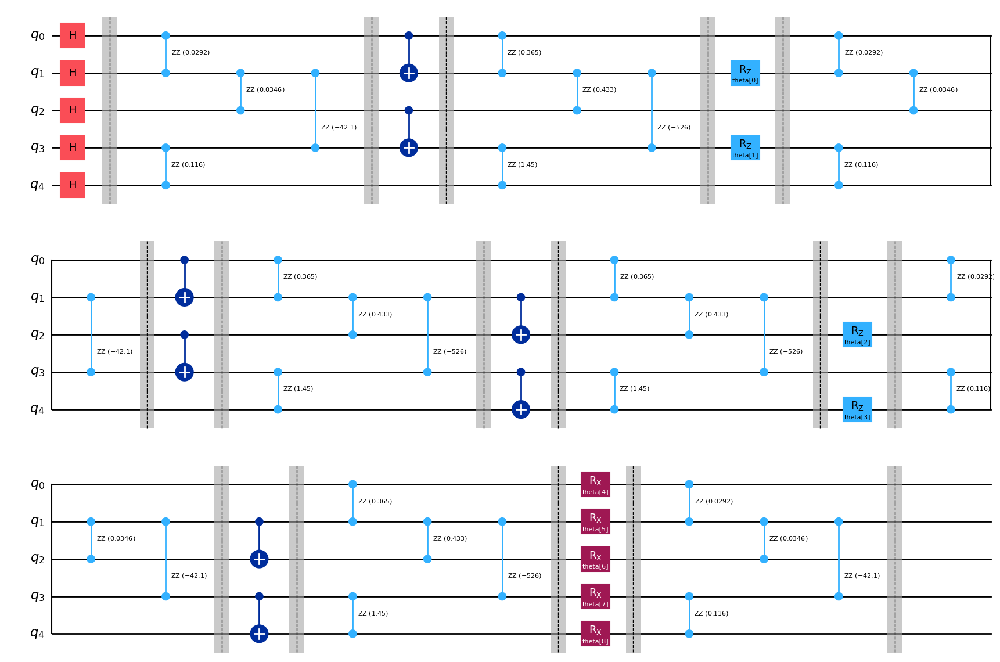

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

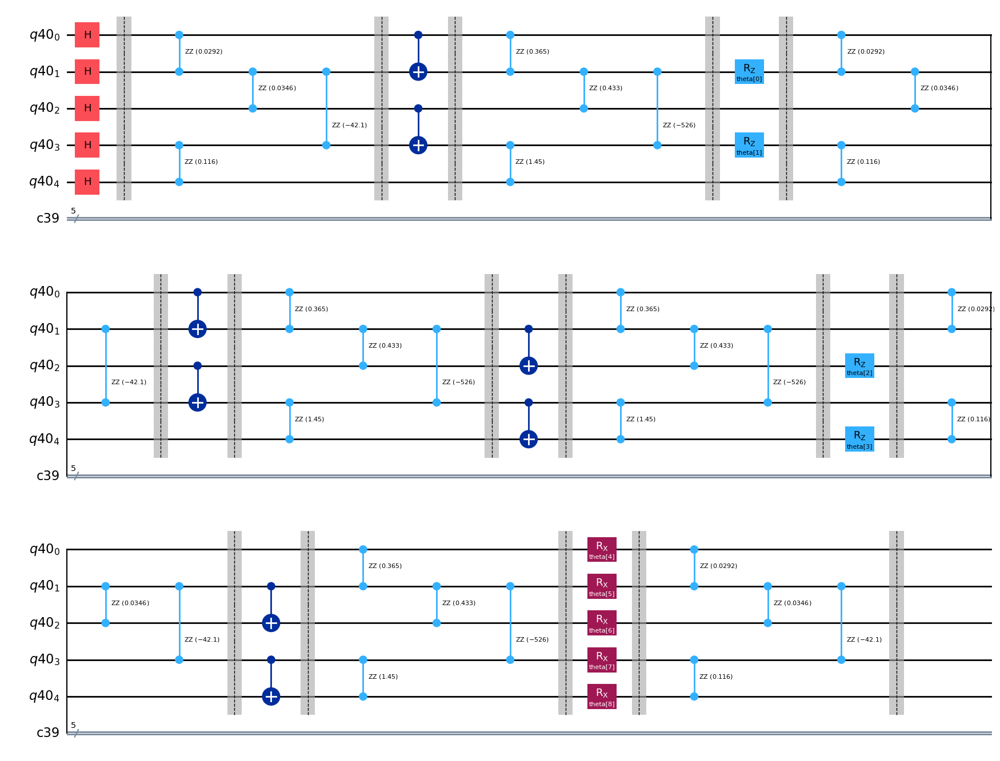

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

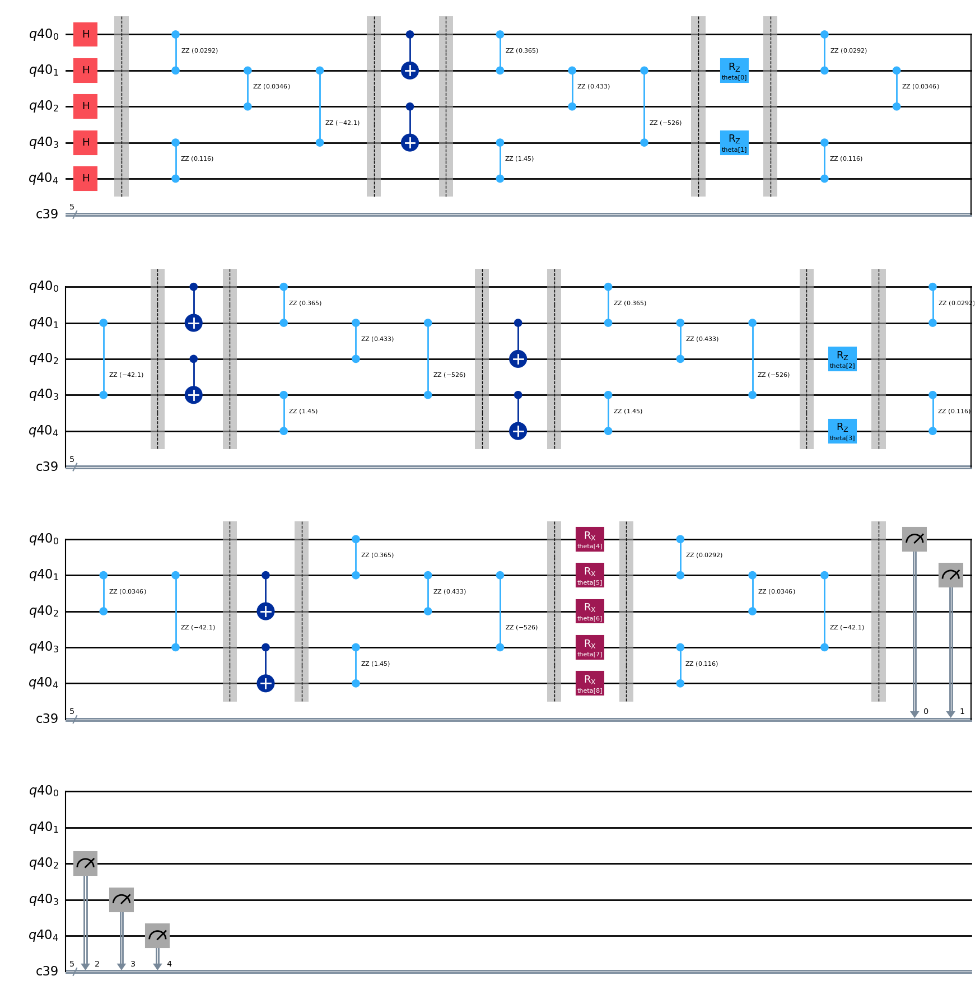

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

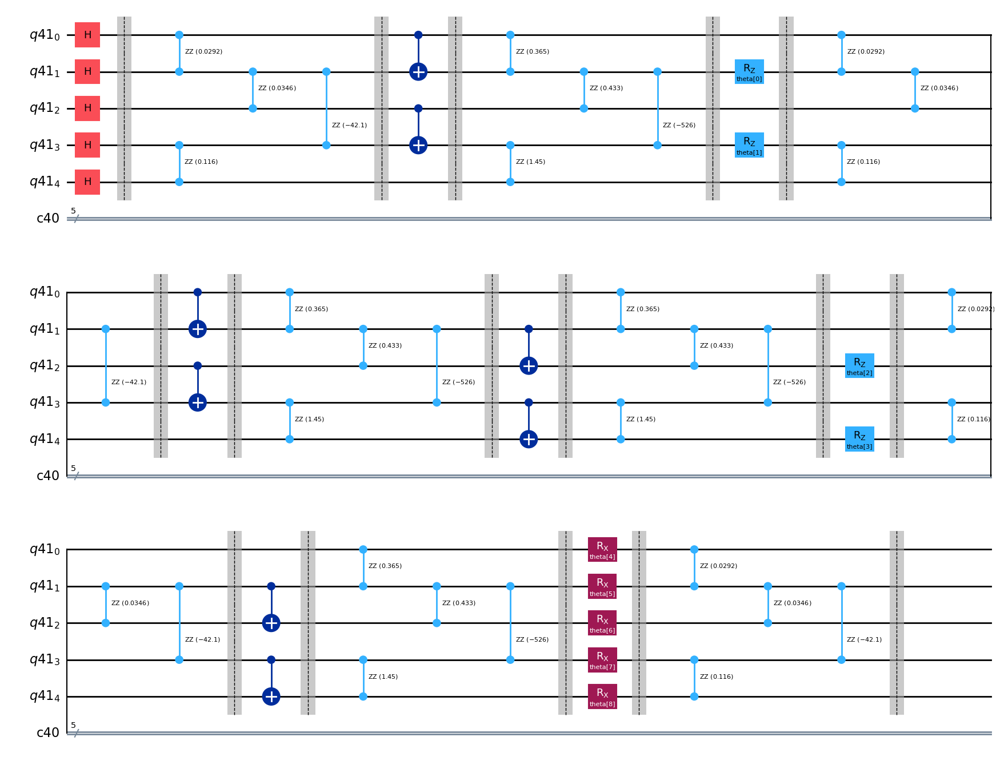

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

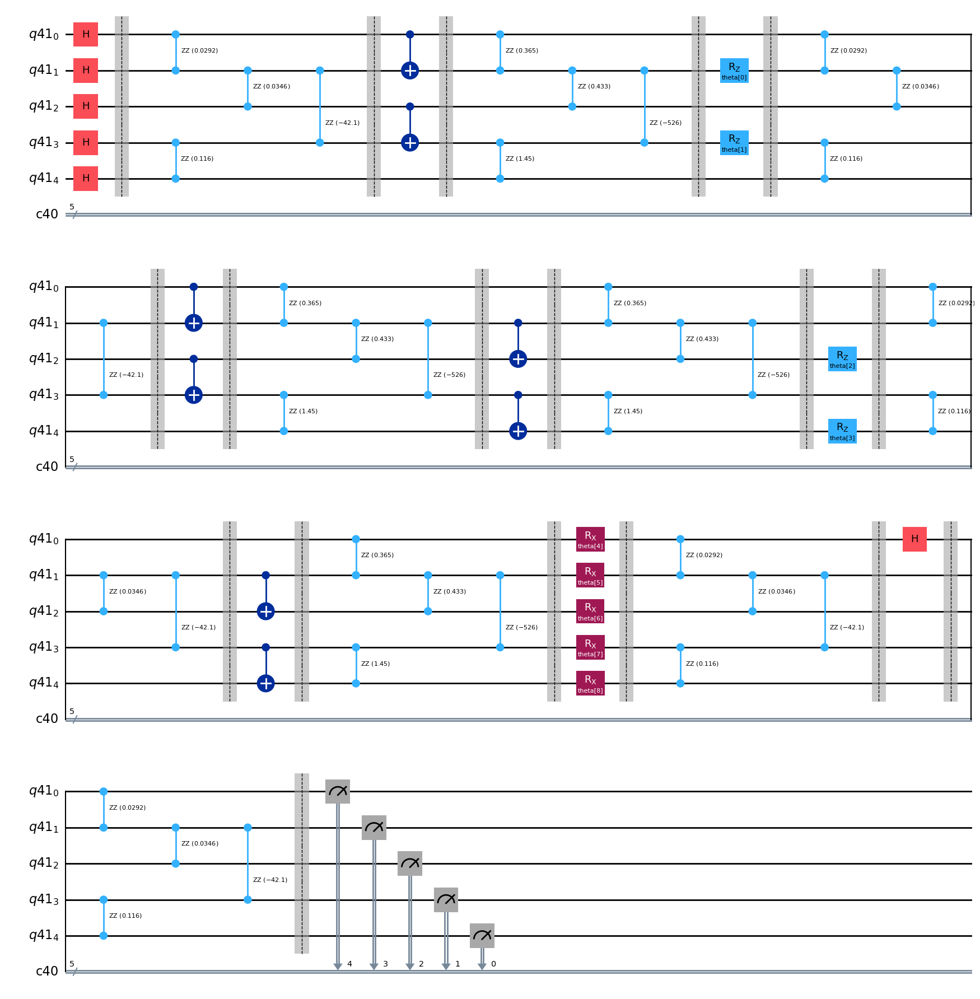

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

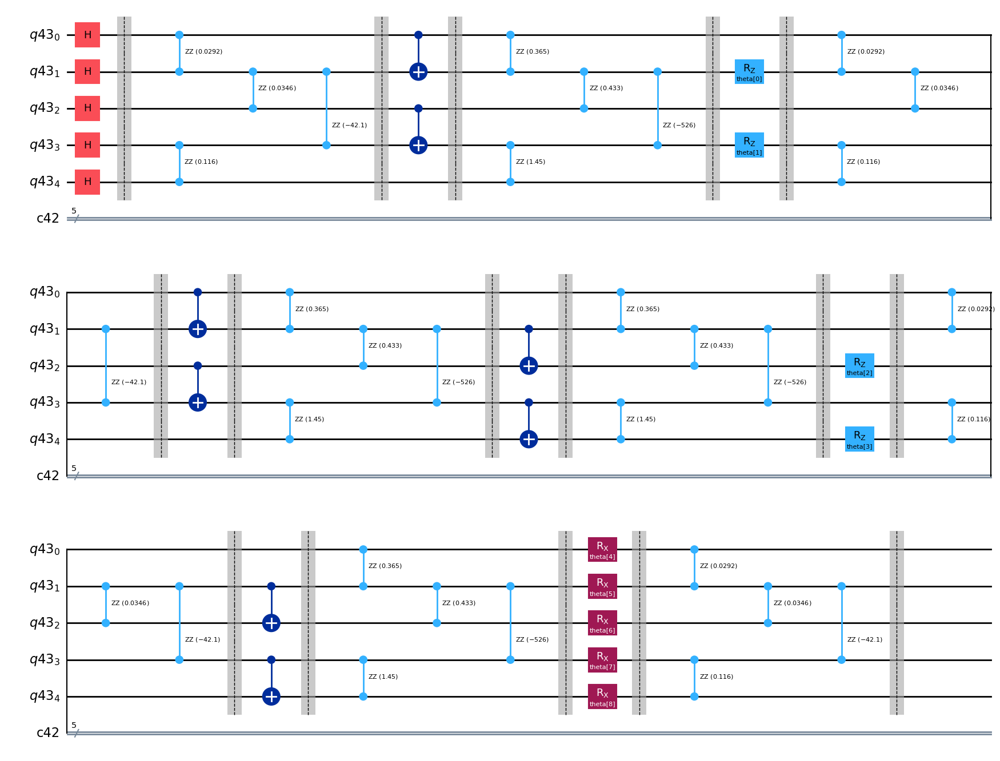

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

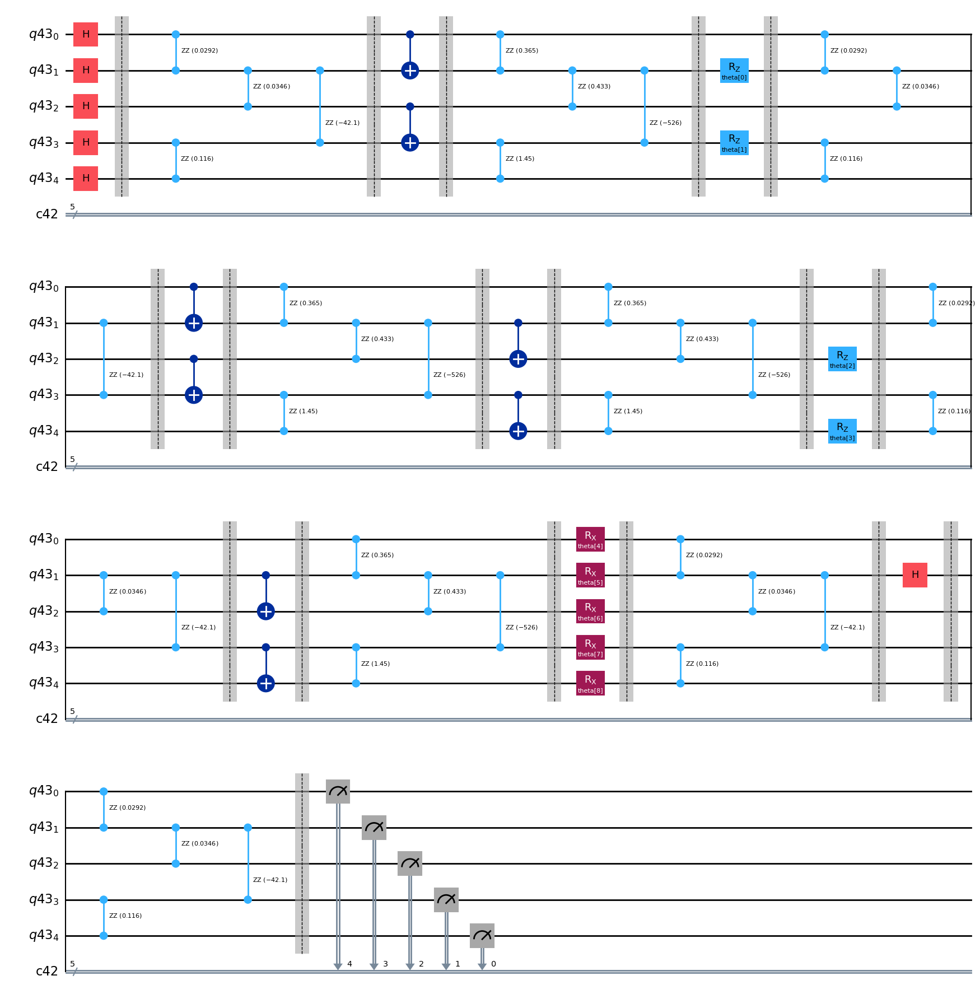

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

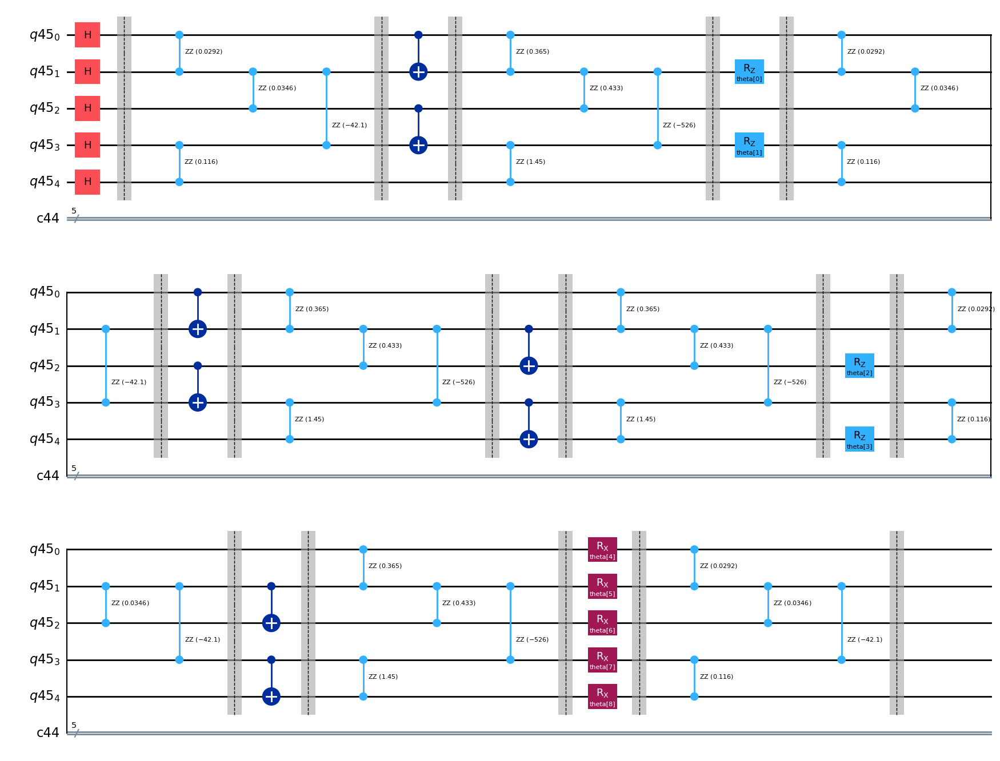

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

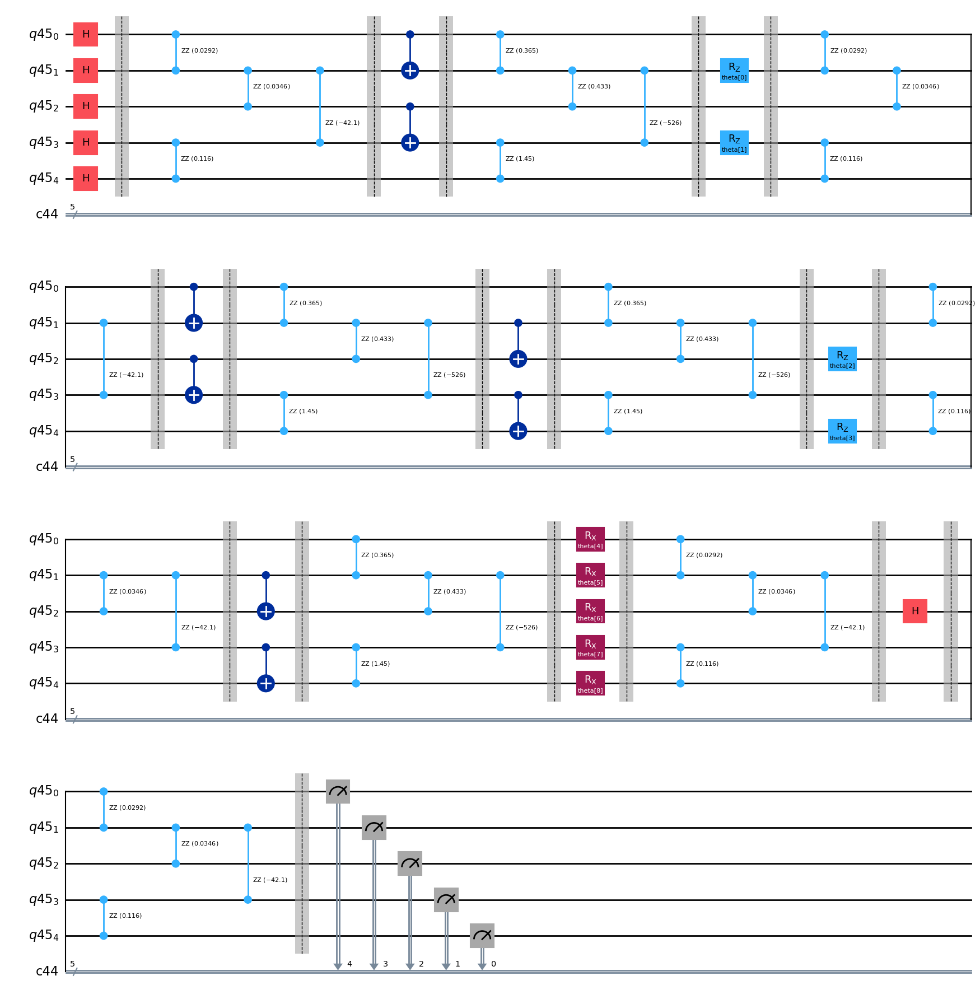

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

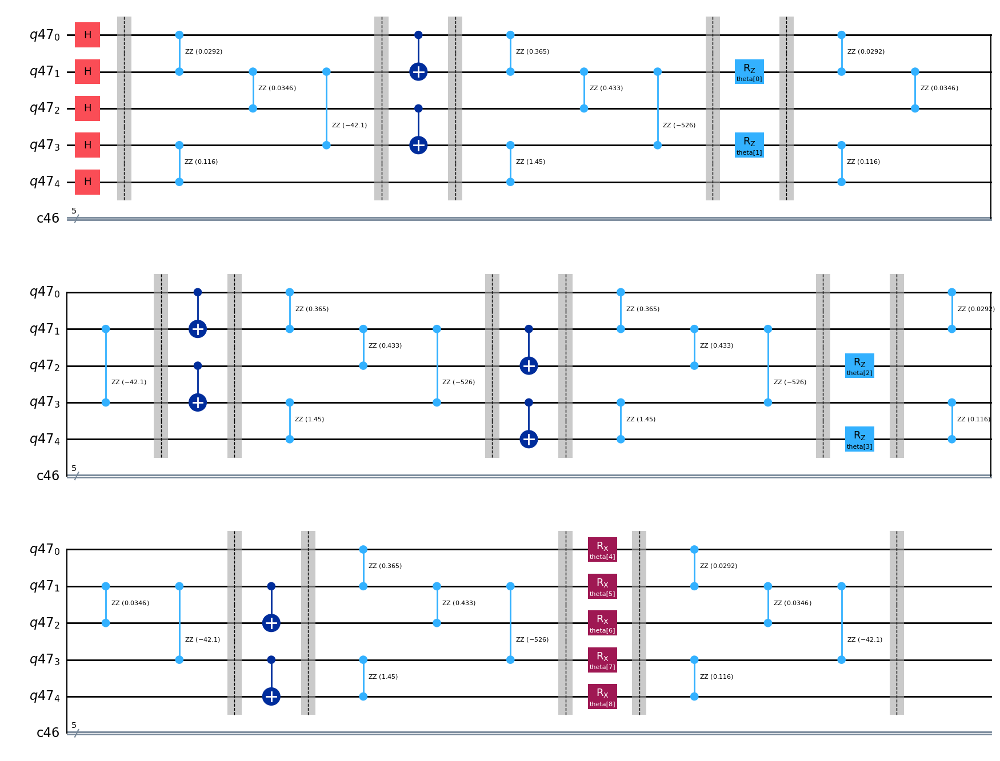

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

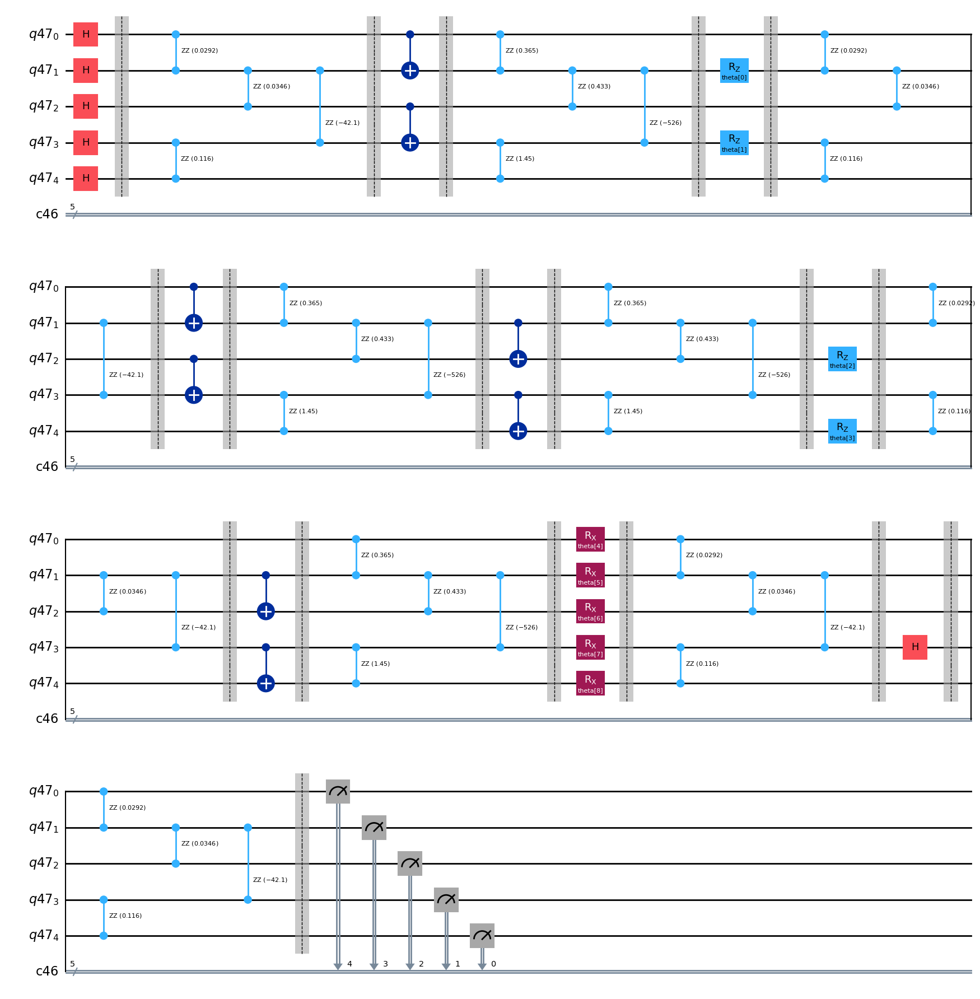

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

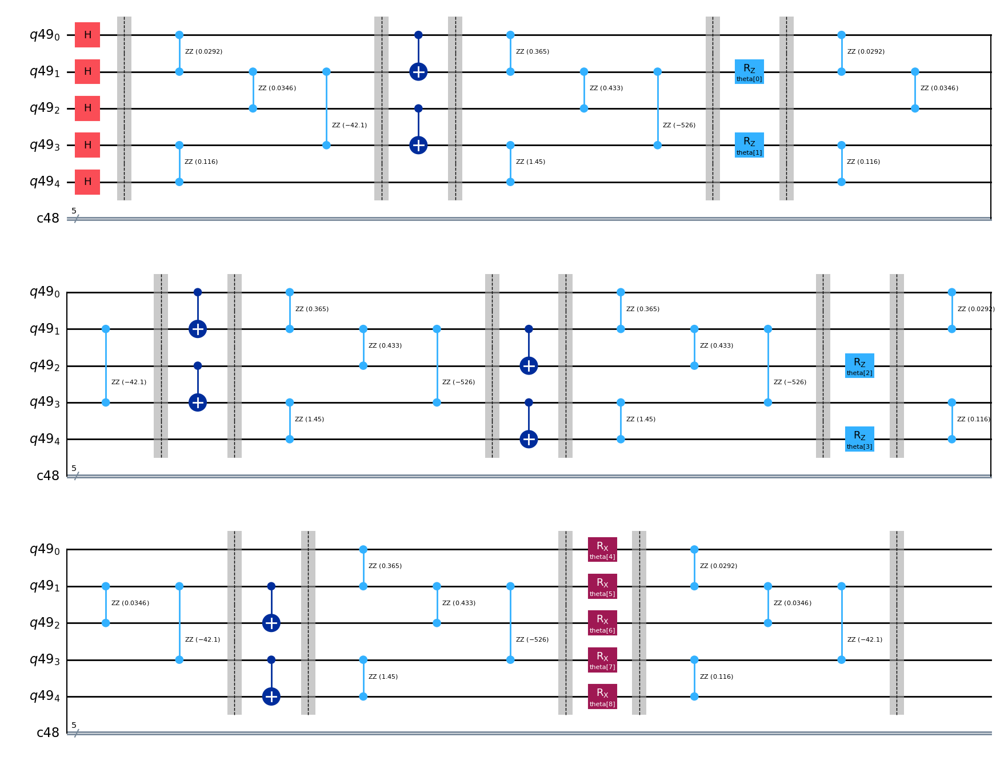

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

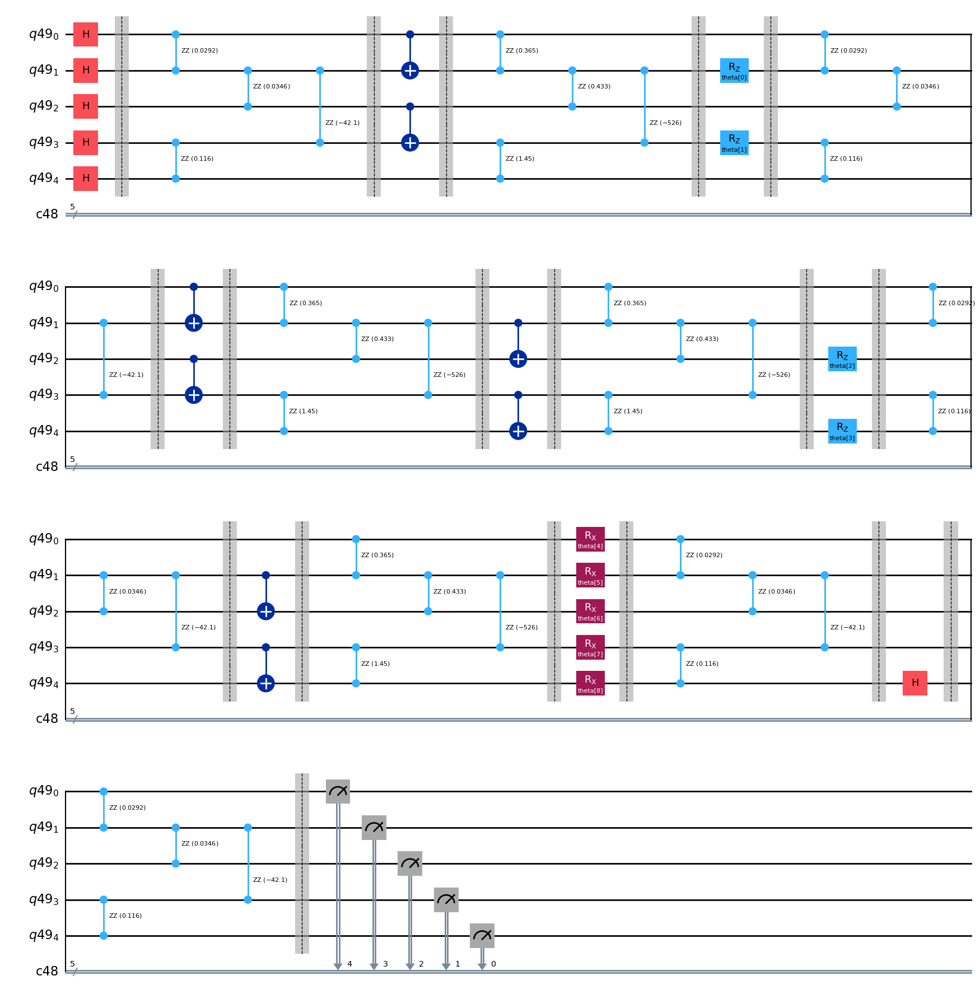

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-1.6044
-1.9784
-1.1132000000000002
-1.9793999999999998
-1.8015999999999996
-1.9656000000000002
-1.9329999999999996
-1.9542000000000006
-1.7861999999999996
-2.0040000000000004
-1.0760000000000003
-1.8578
-1.9146000000000003
-1.2841999999999996
-2.0116
-1.0961999999999998
-1.6738000000000002
-1.8768000000000002
-1.8308000000000002
-1.8542000000000005


In [ ]:
lowest_energy_vqe

-2.0116

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.6044
-1.9784
-1.1132000000000002
-1.9793999999999998
-1.8015999999999996
-1.9656000000000002
-1.9329999999999996
-1.9542000000000006
-1.7861999999999996
-2.0040000000000004
-1.0760000000000003
-1.8578
-1.9146000000000003
-1.2841999999999996
-2.0116
-1.0961999999999998
-1.6738000000000002
-1.8768000000000002
-1.8308000000000002
-1.8542000000000005


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scala

         Current function value: nan
         Iterations: 42
         Function evaluations: 1106
         Gradient evaluations: 158
Optimization terminated successfully.
         Current function value: -2.726742
         Iterations: 106
         Function evaluations: 952
         Gradient evaluations: 136
Optimization terminated successfully.
         Current function value: -4.714325
         Iterations: 63
         Function evaluations: 623
         Gradient evaluations: 89


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-201-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-201-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 45
         Function evaluations: 1148
         Gradient evaluations: 164


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-201-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-201-942dbc8389c9>:82: RuntimeWarning: invalid

         Current function value: nan
         Iterations: 64
         Function evaluations: 1267
         Gradient evaluations: 181


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-201-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-201-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 41
         Function evaluations: 1113
         Gradient evaluations: 159
Optimization terminated successfully.
         Current function value: -4.868107
         Iterations: 33
         Function evaluations: 301
         Gradient evaluations: 43


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 99
         Function evaluations: 1673
         Gradient evaluations: 239


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:54: RuntimeWarning: 

         Current function value: nan
         Iterations: 37
         Function evaluations: 1064
         Gradient evaluations: 152
Optimization terminated successfully.
         Current function value: -4.769936
         Iterations: 30
         Function evaluations: 273
         Gradient evaluations: 39
Optimization terminated successfully.
         Current function value: -3.363454
         Iterations: 75
         Function evaluations: 763
         Gradient evaluations: 109


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 67
         Function evaluations: 2037
         Gradient evaluations: 291
Optimization terminated successfully.
         Current function value: -3.365873
         Iterations: 168
         Function evaluations: 1638
         Gradient evaluations: 234
Optimization terminated successfully.
         Current function value: -4.684995
         Iterations: 67
         Function evaluations: 700
         Gradient evaluations: 100


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.058595
         Iterations: 91
         Function evaluations: 994
         Gradient evaluations: 142
Optimization terminated successfully.
         Current function value: -2.761732
         Iterations: 37
         Function evaluations: 294
         Gradient evaluations: 42


<ipython-input-201-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-201-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-201-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scala

         Current function value: nan
         Iterations: 46
         Function evaluations: 1155
         Gradient evaluations: 165
Optimization terminated successfully.
         Current function value: -3.365870
         Iterations: 107
         Function evaluations: 924
         Gradient evaluations: 132
Optimization terminated successfully.
         Current function value: -2.146122
         Iterations: 18
         Function evaluations: 140
         Gradient evaluations: 20
Optimization terminated successfully.
         Current function value: -4.868108
         Iterations: 56
         Function evaluations: 511
         Gradient evaluations: 73


In [ ]:
lowest_energy_vqnhe

-4.868108468629881

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.6044
-1.9784
-1.1132000000000002
-1.9793999999999998
-1.8015999999999996
-1.9656000000000002
-1.9329999999999996
-1.9542000000000006
-1.7861999999999996
-2.0040000000000004
-1.0760000000000003
-1.8578
-1.9146000000000003
-1.2841999999999996
-2.0116
-1.0961999999999998
-1.6738000000000002
-1.8768000000000002
-1.8308000000000002
-1.8542000000000005


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.788842
         Iterations: 72
         Function evaluations: 4682
         Gradient evaluations: 146


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.313669
         Iterations: 108
         Function evaluations: 7308
         Gradient evaluations: 228
Optimization terminated successfully.
         Current function value: -4.722822
         Iterations: 84
         Function evaluations: 3808
         Gradient evaluations: 119
Optimization terminated successfully.
         Current function value: -4.951267
         Iterations: 93
         Function evaluations: 4192
         Gradient evaluations: 131
Optimization terminated successfully.
         Current function value: -5.028116
         Iterations: 239
         Function evaluations: 11712
         Gradient evaluations: 366


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.264731
         Iterations: 193
         Function evaluations: 11819
         Gradient evaluations: 369


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.294438
         Iterations: 90
         Function evaluations: 5760
         Gradient evaluations: 180
Optimization terminated successfully.
         Current function value: -2.555192
         Iterations: 145
         Function evaluations: 6976
         Gradient evaluations: 218
Optimization terminated successfully.
         Current function value: -4.691772
         Iterations: 89
         Function evaluations: 4448
         Gradient evaluations: 139


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.675940
         Iterations: 57
         Function evaluations: 4644
         Gradient evaluations: 145


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.058595
         Iterations: 190
         Function evaluations: 10603
         Gradient evaluations: 331


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.292078
         Iterations: 68
         Function evaluations: 6057
         Gradient evaluations: 189
Optimization terminated successfully.
         Current function value: -5.015469
         Iterations: 232
         Function evaluations: 12832
         Gradient evaluations: 401


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.939097
         Iterations: 76
         Function evaluations: 5383
         Gradient evaluations: 168


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.911106
         Iterations: 110
         Function evaluations: 5632
         Gradient evaluations: 176


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.294438
         Iterations: 89
         Function evaluations: 5004
         Gradient evaluations: 156


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.093222
         Iterations: 11
         Function evaluations: 2468
         Gradient evaluations: 77


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.767148
         Iterations: 89
         Function evaluations: 4704
         Gradient evaluations: 147


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.677065
         Iterations: 69
         Function evaluations: 5675
         Gradient evaluations: 177
         Current function value: -2.440727
         Iterations: 14
         Function evaluations: 2083
         Gradient evaluations: 65


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-5.028115533365596

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.6044
-1.9784
-1.1132000000000002
-1.9793999999999998
-1.8015999999999996
-1.9656000000000002
-1.9329999999999996
-1.9542000000000006
-1.7861999999999996
-2.0040000000000004
-1.0760000000000003
-1.8578
-1.9146000000000003
-1.2841999999999996
-2.0116
-1.0961999999999998
-1.6738000000000002
-1.8768000000000002
-1.8308000000000002
-1.8542000000000005


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.803759
         Iterations: 106
         Function evaluations: 9804
         Gradient evaluations: 172


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.452463
         Iterations: 218
         Function evaluations: 16017
         Gradient evaluations: 281


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.263816
         Iterations: 85
         Function evaluations: 7125
         Gradient evaluations: 125


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.245714
         Iterations: 75
         Function evaluations: 8961
         Gradient evaluations: 157


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.926493
         Iterations: 164
         Function evaluations: 16701
         Gradient evaluations: 293
Optimization terminated successfully.
         Current function value: -4.808136
         Iterations: 89
         Function evaluations: 7923
         Gradient evaluations: 139


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.321409
         Iterations: 101
         Function evaluations: 11013
         Gradient evaluations: 193


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.581002
         Iterations: 88
         Function evaluations: 11868
         Gradient evaluations: 208
Optimization terminated successfully.
         Current function value: -3.215166
         Iterations: 73
         Function evaluations: 5187
         Gradient evaluations: 91


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.412332
         Iterations: 229
         Function evaluations: 26175
         Gradient evaluations: 459
Optimization terminated successfully.
         Current function value: -4.308031
         Iterations: 81
         Function evaluations: 10146
         Gradient evaluations: 178


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.322929
         Iterations: 4
         Function evaluations: 4458
         Gradient evaluations: 78


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.362987
         Iterations: 117
         Function evaluations: 11695
         Gradient evaluations: 205
Optimization terminated successfully.
         Current function value: -4.137759
         Iterations: 54
         Function evaluations: 5016
         Gradient evaluations: 88


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.954307
         Iterations: 154
         Function evaluations: 14427
         Gradient evaluations: 253


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.926695
         Iterations: 300
         Function evaluations: 25137
         Gradient evaluations: 441


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.898661
         Iterations: 10
         Function evaluations: 5313
         Gradient evaluations: 93


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.085932
         Iterations: 300
         Function evaluations: 25536
         Gradient evaluations: 448
Optimization terminated successfully.
         Current function value: -2.677585
         Iterations: 116
         Function evaluations: 10488
         Gradient evaluations: 184
         Current function value: -4.807577
         Iterations: 109
         Function evaluations: 12092
         Gradient evaluations: 212


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-5.08593241473634

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.6044
-1.9784
-1.1132000000000002
-1.9793999999999998
-1.8015999999999996
-1.9656000000000002
-1.9329999999999996
-1.9542000000000006
-1.7861999999999996
-2.0040000000000004
-1.0760000000000003
-1.8578
-1.9146000000000003
-1.2841999999999996
-2.0116
-1.0961999999999998
-1.6738000000000002
-1.8768000000000002
-1.8308000000000002
-1.8542000000000005
Optimization terminated successfully.
         Current function value: -3.902935
         Iterations: 74
         Function evaluations: 3042
         Gradient evaluations: 117


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.933760
         Iterations: 153
         Function evaluations: 7884
         Gradient evaluations: 303
Optimization terminated successfully.
         Current function value: -3.930904
         Iterations: 76
         Function evaluations: 2600
         Gradient evaluations: 100


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.824575
         Iterations: 13
         Function evaluations: 2322
         Gradient evaluations: 89
Optimization terminated successfully.
         Current function value: -2.035523
         Iterations: 15
         Function evaluations: 416
         Gradient evaluations: 16
Optimization terminated successfully.
         Current function value: -3.902614
         Iterations: 49
         Function evaluations: 1742
         Gradient evaluations: 67


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.958294
         Iterations: 49
         Function evaluations: 2506
         Gradient evaluations: 96
Optimization terminated successfully.
         Current function value: -2.035523
         Iterations: 14
         Function evaluations: 390
         Gradient evaluations: 15


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.850094
         Iterations: 50
         Function evaluations: 4894
         Gradient evaluations: 188
Optimization terminated successfully.
         Current function value: -3.817115
         Iterations: 4
         Function evaluations: 260
         Gradient evaluations: 10
Optimization terminated successfully.
         Current function value: -3.618457
         Iterations: 47
         Function evaluations: 1690
         Gradient evaluations: 65
Optimization terminated successfully.
         Current function value: -2.855446
         Iterations: 26
         Function evaluations: 962
         Gradient evaluations: 37
Optimization terminated successfully.
         Current function value: -3.875244
         Iterations: 35
         Function evaluations: 1820
         Gradient evaluations: 70
Optimization terminated successfully.
         Current function value: -2.035523
         Iterations: 15
         Function evaluations: 416
         Gradient evaluat

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-3.9582942861769554

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.6044
-1.9784
-1.1132000000000002
-1.9793999999999998
-1.8015999999999996
-1.9656000000000002
-1.9329999999999996
-1.9542000000000006
-1.7861999999999996
-2.0040000000000004
-1.0760000000000003
-1.8578
-1.9146000000000003
-1.2841999999999996
-2.0116
-1.0961999999999998
-1.6738000000000002
-1.8768000000000002
-1.8308000000000002
-1.8542000000000005


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.902797
         Iterations: 46
         Function evaluations: 7705
         Gradient evaluations: 140
Optimization terminated successfully.
         Current function value: -3.625571
         Iterations: 49
         Function evaluations: 3355
         Gradient evaluations: 61


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.718451
         Iterations: 24
         Function evaluations: 6222
         Gradient evaluations: 113


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.921164
         Iterations: 40
         Function evaluations: 6824
         Gradient evaluations: 124
Optimization terminated successfully.
         Current function value: -2.035523
         Iterations: 11
         Function evaluations: 660
         Gradient evaluations: 12


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.902935
         Iterations: 69
         Function evaluations: 6930
         Gradient evaluations: 126
Optimization terminated successfully.
         Current function value: -3.915337
         Iterations: 49
         Function evaluations: 3520
         Gradient evaluations: 64
Optimization terminated successfully.
         Current function value: -3.821571
         Iterations: 28
         Function evaluations: 2200
         Gradient evaluations: 40
Optimization terminated successfully.
         Current function value: -2.011600
         Iterations: 1
         Function evaluations: 110
         Gradient evaluations: 2


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.321733
         Iterations: 8
         Function evaluations: 4355
         Gradient evaluations: 79


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.905899
         Iterations: 89
         Function evaluations: 8535
         Gradient evaluations: 155
Optimization terminated successfully.
         Current function value: -2.786434
         Iterations: 17
         Function evaluations: 1650
         Gradient evaluations: 30


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.941384
         Iterations: 104
         Function evaluations: 11064
         Gradient evaluations: 201


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.661642
         Iterations: 12
         Function evaluations: 4683
         Gradient evaluations: 85
Optimization terminated successfully.
         Current function value: -3.685738
         Iterations: 153
         Function evaluations: 14795
         Gradient evaluations: 269


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.896625
         Iterations: 72
         Function evaluations: 9747
         Gradient evaluations: 177


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.792348
         Iterations: 67
         Function evaluations: 10295
         Gradient evaluations: 187


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.621836
         Iterations: 216
         Function evaluations: 17007
         Gradient evaluations: 309
Optimization terminated successfully.
         Current function value: -3.024345
         Iterations: 50
         Function evaluations: 4345
         Gradient evaluations: 79
         Current function value: -2.663620
         Iterations: 16
         Function evaluations: 5124
         Gradient evaluations: 93


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-3.9413835091054192

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 5MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 5MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.005                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23226521 5.13773479]
[10.16003217 10.37036306  9.97047477]
0.0003630638566862743
[5.13816648 4.98783352]
[ 9.97027925 10.12643004  9.66834071]
0.0004300374654215844
[4.98710382 5.01589618]
[10.00332768  9.6683002   9.72283212]
-0.33469979662851834
[5.0149064 5.2820936]
[ 9.72292289 10.29842297 10.25966414]
0.0014229718621754373


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(0.00018153192834313714,
 0.0002150187327107922,
 -0.16734989831425917,
 0.0007114859310877186)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

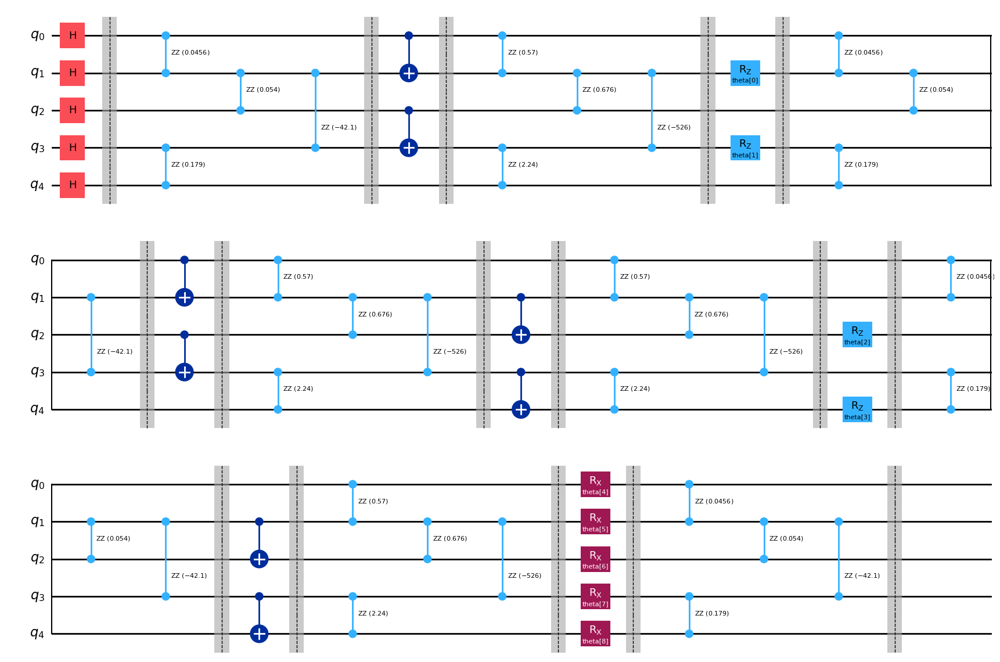

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

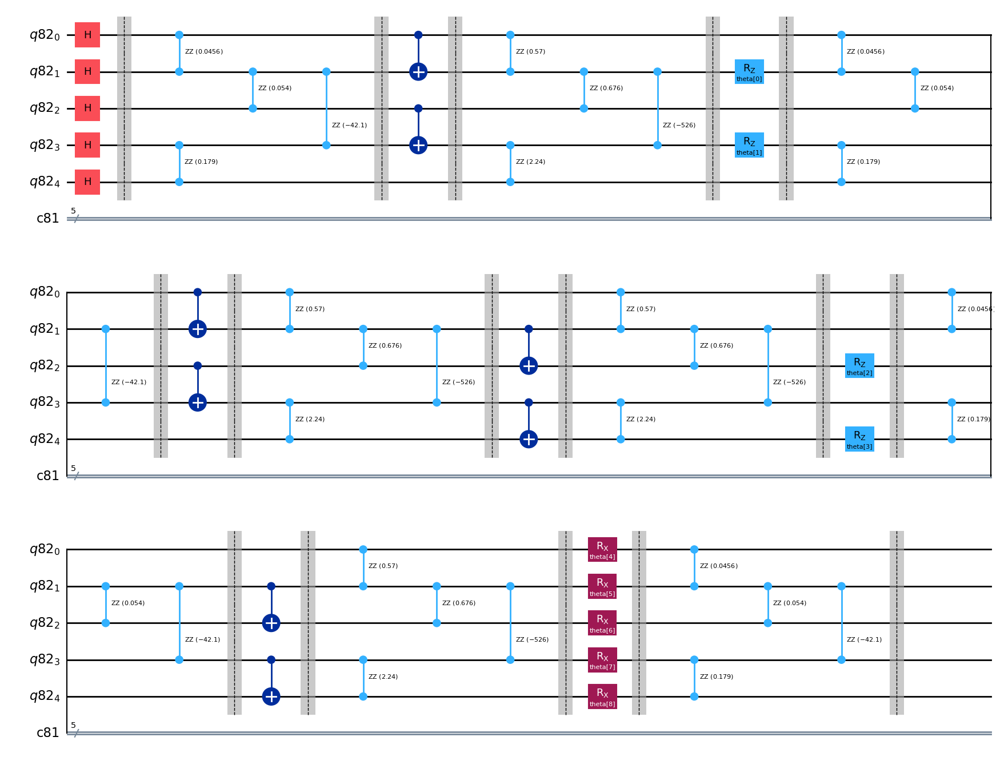

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

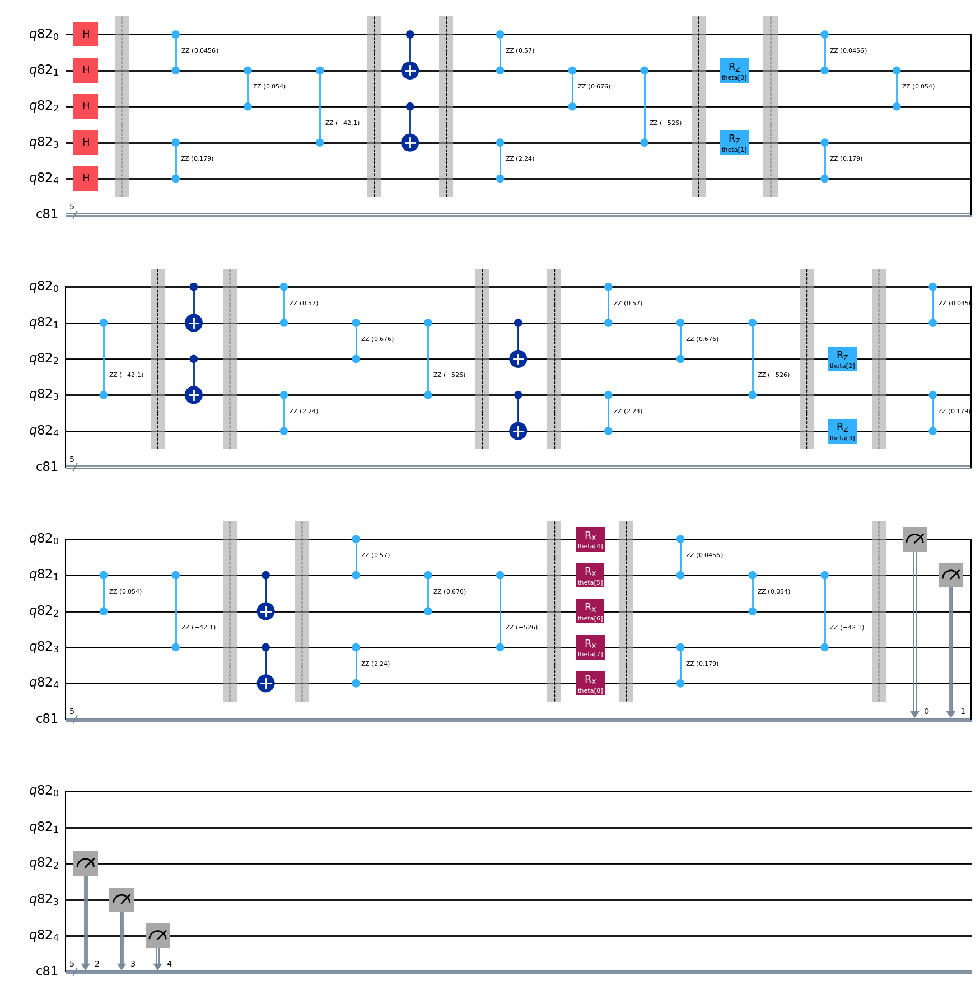

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

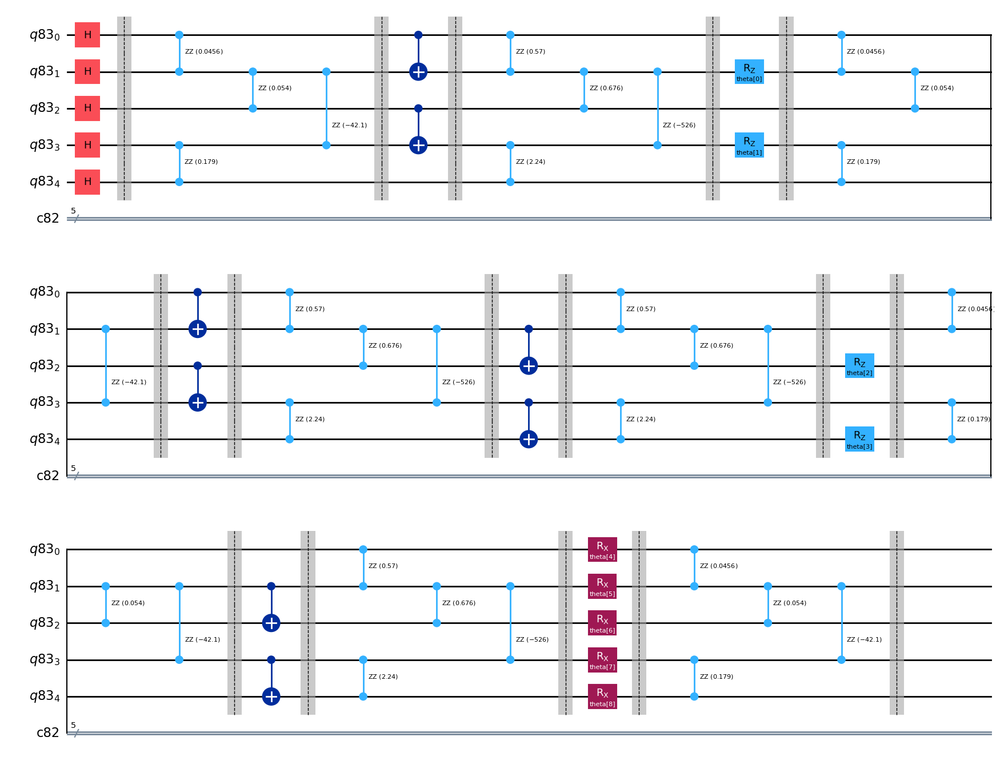

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

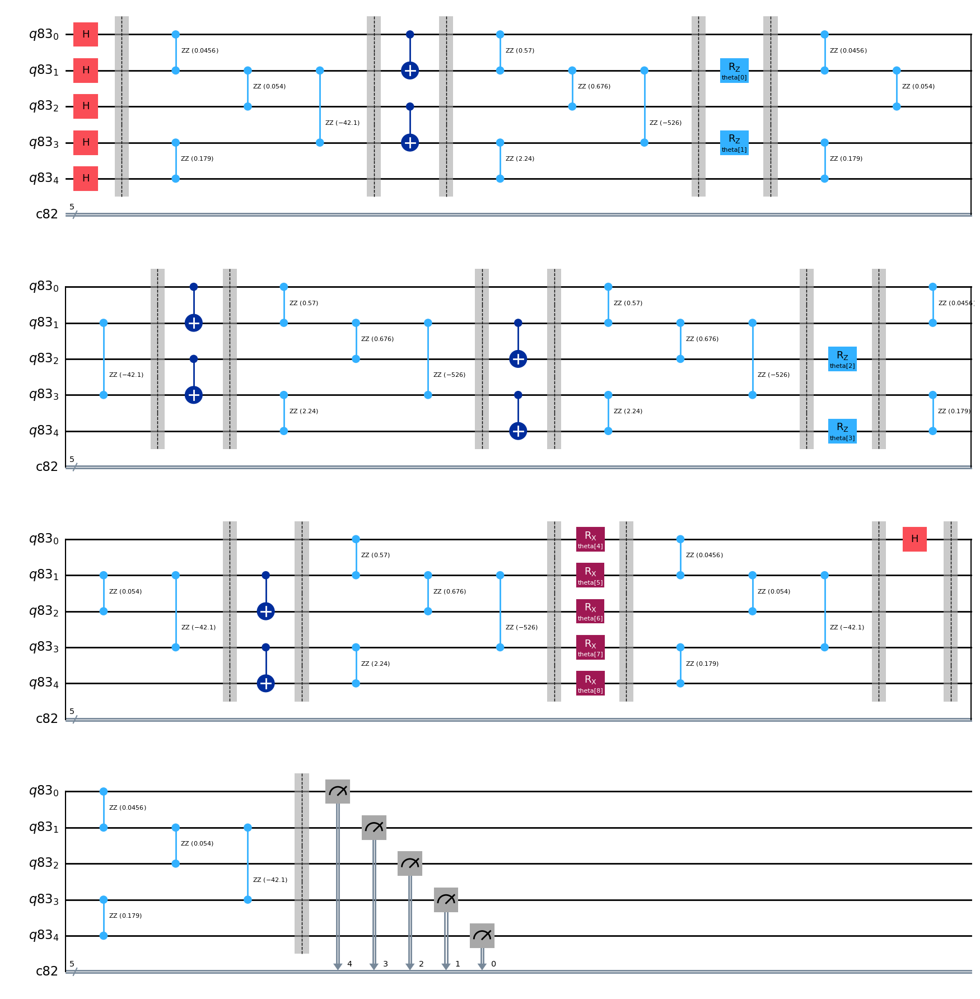

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

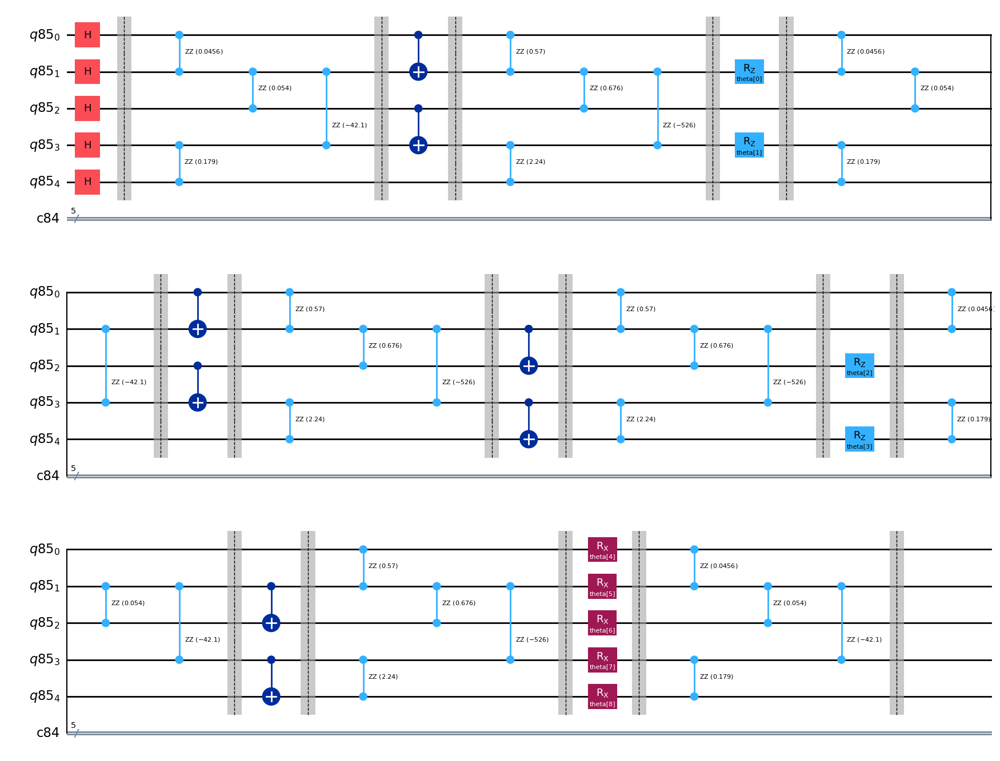

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

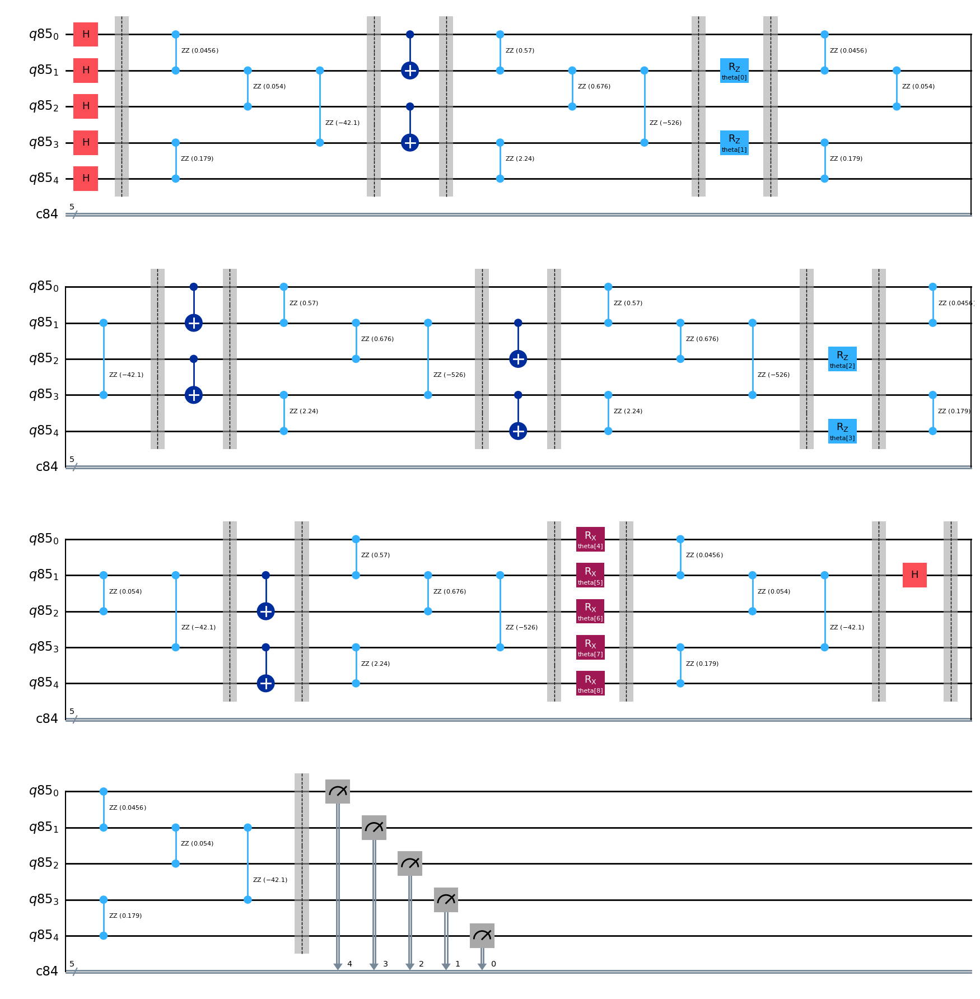

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

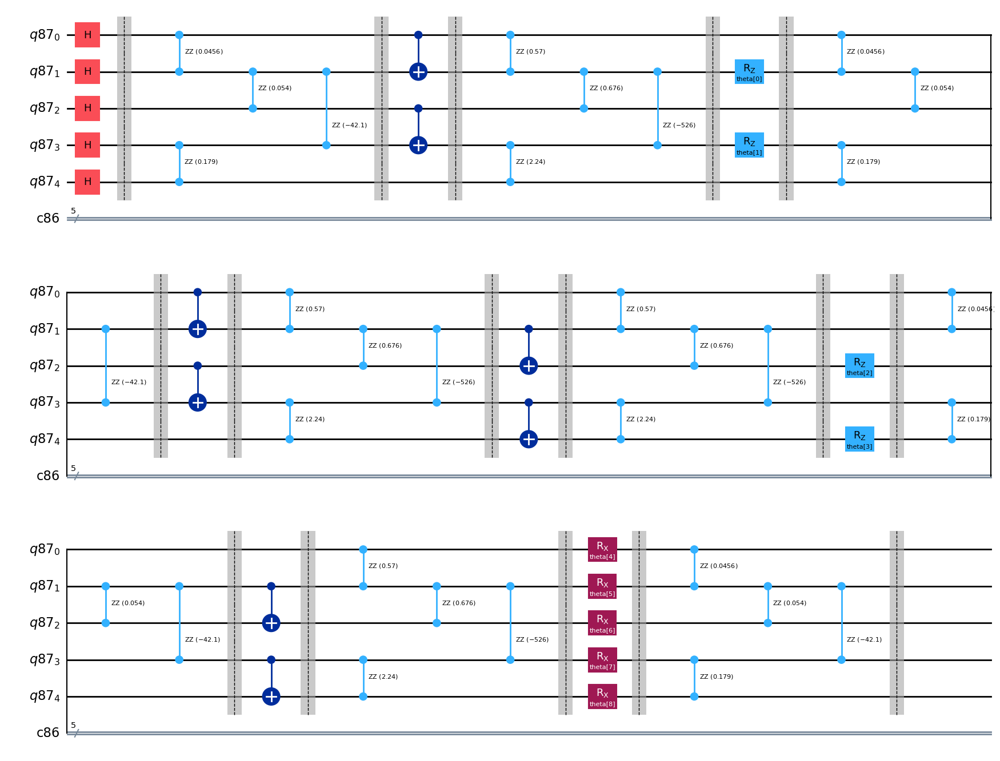

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

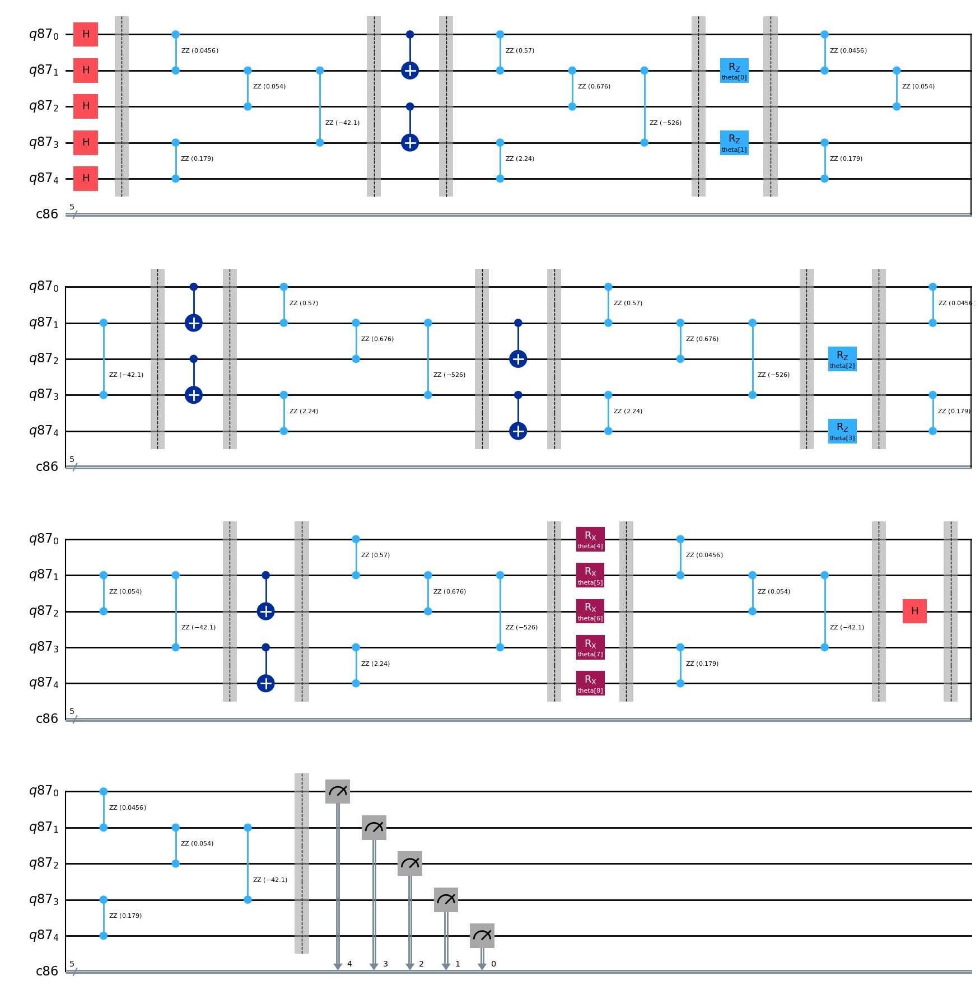

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

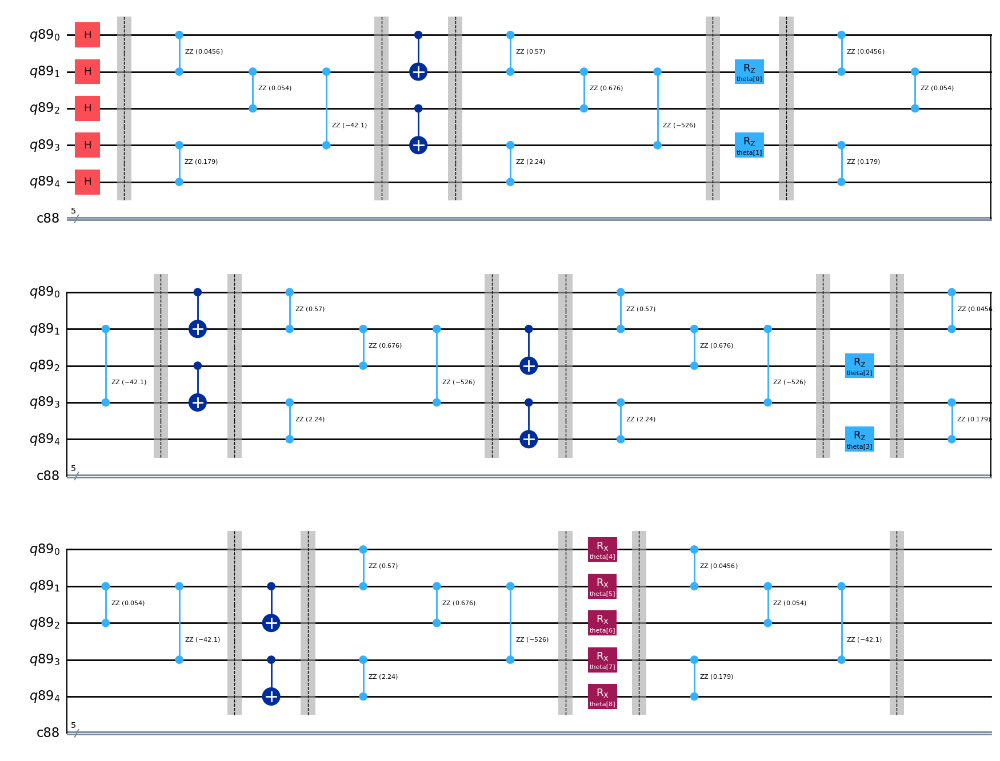

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

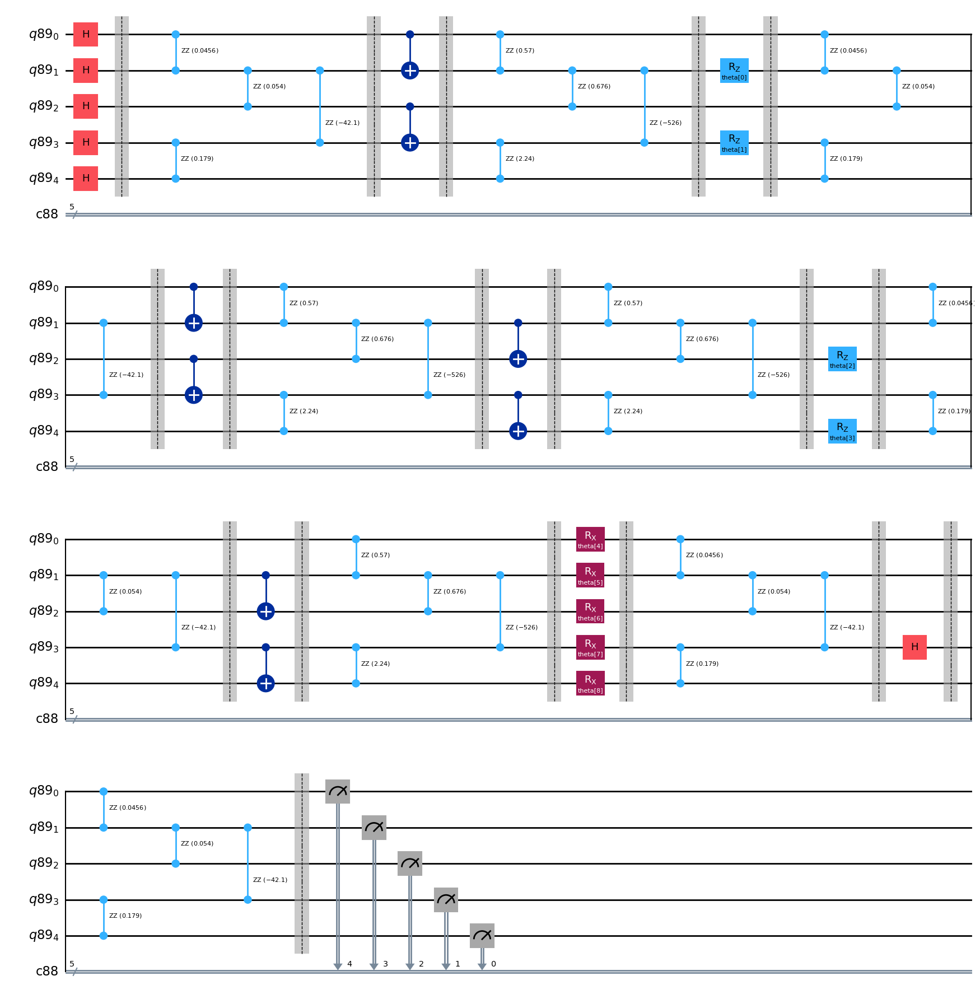

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

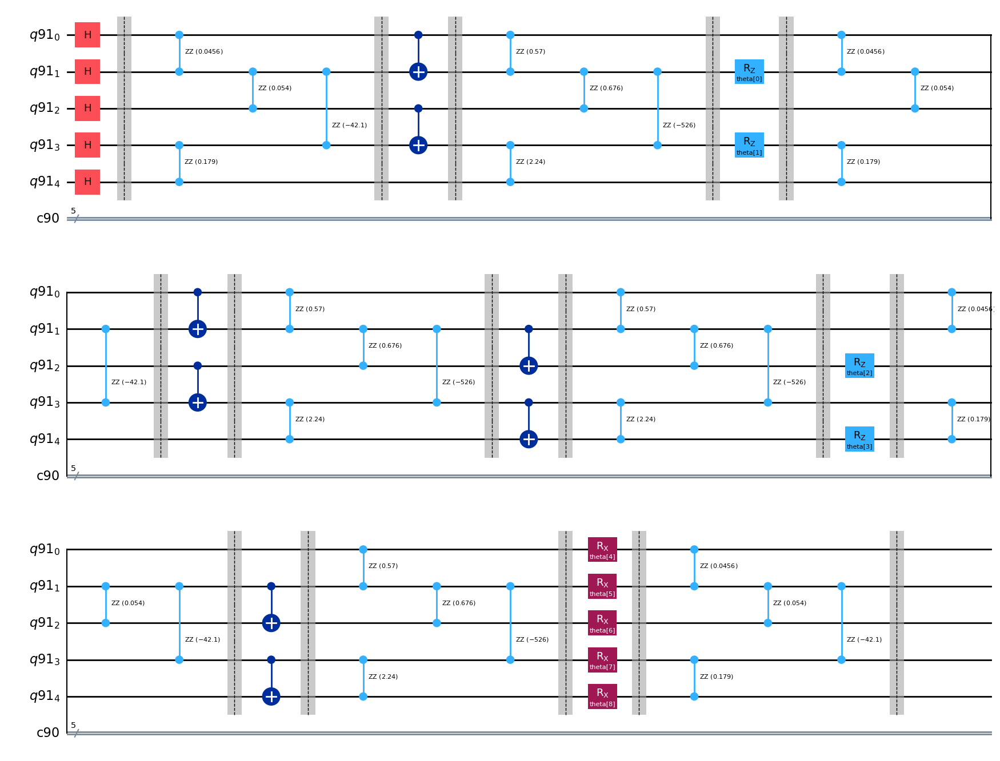

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

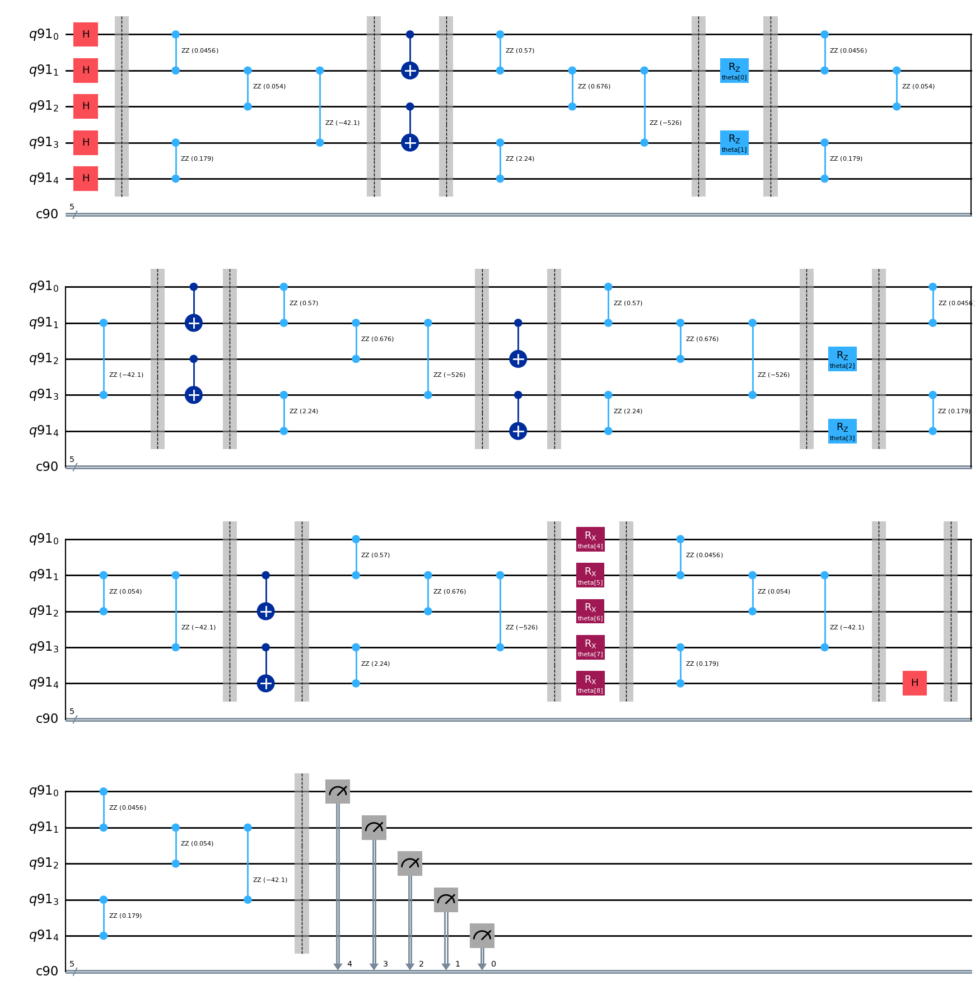

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-2.9062
-2.4902
-3.1823999999999995
-2.8798000000000004
-2.9663999999999993
-2.8354
-3.068599999999998
-2.3694
-2.7491999999999996
-2.9206000000000008
-2.7948000000000004
-3.186599999999999
-2.2842000000000002
-3.0075999999999987
-2.8952000000000004
-3.1216
-2.734000000000001
-2.1486000000000005
-2.8962
-2.9213999999999998


In [ ]:
lowest_energy_vqe

-3.186599999999999

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.9062
-2.4902
-3.1823999999999995
-2.8798000000000004
-2.9663999999999993
-2.8354
-3.068599999999998
-2.3694
-2.7491999999999996
-2.9206000000000008
-2.7948000000000004
-3.186599999999999
-2.2842000000000002
-3.0075999999999987
-2.8952000000000004
-3.1216
-2.734000000000001
-2.1486000000000005
-2.8962
-2.9213999999999998


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.772143
         Iterations: 282
         Function evaluations: 3071
         Gradient evaluations: 437


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar pow

         Current function value: nan
         Iterations: 53
         Function evaluations: 1211
         Gradient evaluations: 173


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 73
         Function evaluations: 1407
         Gradient evaluations: 201


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 88
         Function evaluations: 1505
         Gradient evaluations: 215


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 74
         Function evaluations: 1365
         Gradient evaluations: 195
Optimization terminated successfully.
         Current function value: -4.194581
         Iterations: 38
         Function evaluations: 301
         Gradient evaluations: 43


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 91
         Function evaluations: 1526
         Gradient evaluations: 218


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 87
         Function evaluations: 1554
         Gradient evaluations: 222


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.824619
         Iterations: 275
         Function evaluations: 2868
         Gradient evaluations: 408


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar pow

         Current function value: nan
         Iterations: 38
         Function evaluations: 1078
         Gradient evaluations: 154
Optimization terminated successfully.
         Current function value: -42.457947
         Iterations: 85
         Function evaluations: 938
         Gradient evaluations: 134


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-339-942dbc8389c9>:123: RuntimeWarning: ov

         Current function value: nan
         Iterations: 83
         Function evaluations: 1456
         Gradient evaluations: 208
Optimization terminated successfully.
         Current function value: -3.648982
         Iterations: 49
         Function evaluations: 364
         Gradient evaluations: 52


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-339-942dbc8389c9>:107: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+4]
<ipython-input-339-942dbc8389c9>:123: RuntimeWarning: overf

         Current function value: nan
         Iterations: 49
         Function evaluations: 1176
         Gradient evaluations: 168


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:54: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:82: RuntimeWarning: overf

         Current function value: nan
         Iterations: 37
         Function evaluations: 1043
         Gradient evaluations: 149


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:123: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
<ipython-input-339-942dbc

         Current function value: nan
         Iterations: 69
         Function evaluations: 1358
         Gradient evaluations: 194


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.772144
         Iterations: 300
         Function evaluations: 2898
         Gradient evaluations: 414


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 102
         Function evaluations: 1687
         Gradient evaluations: 241


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 31
         Function evaluations: 1008
         Gradient evaluations: 144


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 34
         Function evaluations: 1050
         Gradient evaluations: 150


<ipython-input-336-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-339-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:69: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-339-942dbc8389c9>:82: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-339-942dbc8389c9>:86: RuntimeW

In [ ]:
lowest_energy_vqnhe

-42.457947018142036

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.9062
-2.4902
-3.1823999999999995
-2.8798000000000004
-2.9663999999999993
-2.8354
-3.068599999999998
-2.3694
-2.7491999999999996
-2.9206000000000008
-2.7948000000000004
-3.186599999999999
-2.2842000000000002
-3.0075999999999987
-2.8952000000000004
-3.1216
-2.734000000000001
-2.1486000000000005
-2.8962
-2.9213999999999998


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.390936
         Iterations: 59
         Function evaluations: 3328
         Gradient evaluations: 104
Optimization terminated successfully.
         Current function value: -4.687154
         Iterations: 118
         Function evaluations: 5856
         Gradient evaluations: 183


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.746321
         Iterations: 124
         Function evaluations: 7336
         Gradient evaluations: 229


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -17.176591
         Iterations: 29
         Function evaluations: 4236
         Gradient evaluations: 132


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -42.567724
         Iterations: 60
         Function evaluations: 4428
         Gradient evaluations: 138


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.596531
         Iterations: 72
         Function evaluations: 4780
         Gradient evaluations: 149
Optimization terminated successfully.
         Current function value: -4.084833
         Iterations: 142
         Function evaluations: 6976
         Gradient evaluations: 218


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.032247
         Iterations: 14
         Function evaluations: 2252
         Gradient evaluations: 70


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -11.914247
         Iterations: 7
         Function evaluations: 3852
         Gradient evaluations: 120


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -58.934970
         Iterations: 58
         Function evaluations: 5792
         Gradient evaluations: 181
Optimization terminated successfully.
         Current function value: -7.733213
         Iterations: 90
         Function evaluations: 5152
         Gradient evaluations: 161
Optimization terminated successfully.
         Current function value: -4.523210
         Iterations: 93
         Function evaluations: 4288
         Gradient evaluations: 134


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -21.936070
         Iterations: 8
         Function evaluations: 2596
         Gradient evaluations: 81


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.983931
         Iterations: 300
         Function evaluations: 14752
         Gradient evaluations: 461
Optimization terminated successfully.
         Current function value: -8.896198
         Iterations: 104
         Function evaluations: 4416
         Gradient evaluations: 138


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scala

         Current function value: -13.471846
         Iterations: 122
         Function evaluations: 5700
         Gradient evaluations: 178


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.709936
         Iterations: 37
         Function evaluations: 5292
         Gradient evaluations: 165
Optimization terminated successfully.
         Current function value: -13.560138
         Iterations: 250
         Function evaluations: 10176
         Gradient evaluations: 318


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.062770
         Iterations: 98
         Function evaluations: 5548
         Gradient evaluations: 173
Optimization terminated successfully.
         Current function value: -9.907704
         Iterations: 18
         Function evaluations: 960
         Gradient evaluations: 30


In [ ]:
lowest_energy_vqnhe

-58.93496965617631

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.9062
-2.4902
-3.1823999999999995
-2.8798000000000004
-2.9663999999999993
-2.8354
-3.068599999999998
-2.3694
-2.7491999999999996
-2.9206000000000008
-2.7948000000000004
-3.186599999999999
-2.2842000000000002
-3.0075999999999987
-2.8952000000000004
-3.1216
-2.734000000000001
-2.1486000000000005
-2.8962
-2.9213999999999998


<ipython-input-339-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-339-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-339-942dbc8389c9>:48: RuntimeWarning: overflow encountered in 

         Current function value: nan
         Iterations: 10
         Function evaluations: 8379
         Gradient evaluations: 147


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -55.950153
         Iterations: 92
         Function evaluations: 11696
         Gradient evaluations: 205


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -9.973743
         Iterations: 59
         Function evaluations: 7593
         Gradient evaluations: 133


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -58.808232
         Iterations: 122
         Function evaluations: 19961
         Gradient evaluations: 350


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.907977
         Iterations: 172
         Function evaluations: 16883
         Gradient evaluations: 296


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -45.011500
         Iterations: 5
         Function evaluations: 5598
         Gradient evaluations: 98


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.084833
         Iterations: 106
         Function evaluations: 10614
         Gradient evaluations: 186


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.193743
         Iterations: 272
         Function evaluations: 30335
         Gradient evaluations: 532


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -58.534235
         Iterations: 71
         Function evaluations: 10265
         Gradient evaluations: 180


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.871397
         Iterations: 101
         Function evaluations: 12604
         Gradient evaluations: 221


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.460268
         Iterations: 27
         Function evaluations: 4221
         Gradient evaluations: 74
Optimization terminated successfully.
         Current function value: -5.099136
         Iterations: 125
         Function evaluations: 12825
         Gradient evaluations: 225


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -58.761939
         Iterations: 187
         Function evaluations: 22811
         Gradient evaluations: 400


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -13.464773
         Iterations: 158
         Function evaluations: 14547
         Gradient evaluations: 255


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.094662
         Iterations: 31
         Function evaluations: 6676
         Gradient evaluations: 117


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.399418
         Iterations: 67
         Function evaluations: 7702
         Gradient evaluations: 135


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -13.541280
         Iterations: 246
         Function evaluations: 26112
         Gradient evaluations: 458


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -11.630277
         Iterations: 48
         Function evaluations: 9414
         Gradient evaluations: 165


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.589732
         Iterations: 19
         Function evaluations: 10899
         Gradient evaluations: 191
         Current function value: -12.605876
         Iterations: 108
         Function evaluations: 15058
         Gradient evaluations: 264


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-58.80823231554212

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.9062
-2.4902
-3.1823999999999995
-2.8798000000000004
-2.9663999999999993
-2.8354
-3.068599999999998
-2.3694
-2.7491999999999996
-2.9206000000000008
-2.7948000000000004
-3.186599999999999
-2.2842000000000002
-3.0075999999999987
-2.8952000000000004
-3.1216
-2.734000000000001
-2.1486000000000005
-2.8962
-2.9213999999999998


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.386128
         Iterations: 40
         Function evaluations: 3233
         Gradient evaluations: 124


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.875784
         Iterations: 105
         Function evaluations: 5237
         Gradient evaluations: 201
Optimization terminated successfully.
         Current function value: -6.799522
         Iterations: 73
         Function evaluations: 6422
         Gradient evaluations: 247


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.342038
         Iterations: 25
         Function evaluations: 2111
         Gradient evaluations: 81
Optimization terminated successfully.
         Current function value: -3.601941
         Iterations: 27
         Function evaluations: 2315
         Gradient evaluations: 89


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.375030
         Iterations: 55
         Function evaluations: 6069
         Gradient evaluations: 233
Optimization terminated successfully.
         Current function value: -6.109034
         Iterations: 56
         Function evaluations: 2418
         Gradient evaluations: 93
Optimization terminated successfully.
         Current function value: -3.231646
         Iterations: 12
         Function evaluations: 338
         Gradient evaluations: 13


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.357692
         Iterations: 43
         Function evaluations: 3909
         Gradient evaluations: 150


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.997049
         Iterations: 300
         Function evaluations: 10452
         Gradient evaluations: 402
Optimization terminated successfully.
         Current function value: -4.459927
         Iterations: 197
         Function evaluations: 7696
         Gradient evaluations: 296
Optimization terminated successfully.
         Current function value: -3.611011
         Iterations: 34
         Function evaluations: 2054
         Gradient evaluations: 79
Optimization terminated successfully.
         Current function value: -3.850529
         Iterations: 58
         Function evaluations: 2366
         Gradient evaluations: 91
Optimization terminated successfully.
         Current function value: -3.231646
         Iterations: 11
         Function evaluations: 312
         Gradient evaluations: 12
Optimization terminated successfully.
         Current function value: -4.064678
         Iterations: 45
         Function evaluations: 1638
         Gradient 

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.102795
         Iterations: 158
         Function evaluations: 10410
         Gradient evaluations: 400


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.769531
         Iterations: 63
         Function evaluations: 2964
         Gradient evaluations: 114


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.712131
         Iterations: 300
         Function evaluations: 13546
         Gradient evaluations: 521


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.372355
         Iterations: 30
         Function evaluations: 2686
         Gradient evaluations: 103
         Current function value: -5.940639
         Iterations: 285
         Function evaluations: 13142
         Gradient evaluations: 505


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.87578377377039

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.9062
-2.4902
-3.1823999999999995
-2.8798000000000004
-2.9663999999999993
-2.8354
-3.068599999999998
-2.3694
-2.7491999999999996
-2.9206000000000008
-2.7948000000000004
-3.186599999999999
-2.2842000000000002
-3.0075999999999987
-2.8952000000000004
-3.1216
-2.734000000000001
-2.1486000000000005
-2.8962
-2.9213999999999998
Optimization terminated successfully.
         Current function value: -4.461731
         Iterations: 37
         Function evaluations: 2695
         Gradient evaluations: 49


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.862495
         Iterations: 41
         Function evaluations: 8588
         Gradient evaluations: 156


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.358237
         Iterations: 152
         Function evaluations: 12936
         Gradient evaluations: 235
Optimization terminated successfully.
         Current function value: -3.611027
         Iterations: 57
         Function evaluations: 4290
         Gradient evaluations: 78
Optimization terminated successfully.
         Current function value: -3.231646
         Iterations: 16
         Function evaluations: 1045
         Gradient evaluations: 19


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.433430
         Iterations: 79
         Function evaluations: 7315
         Gradient evaluations: 133


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.800208
         Iterations: 95
         Function evaluations: 10516
         Gradient evaluations: 191


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.726101
         Iterations: 16
         Function evaluations: 5952
         Gradient evaluations: 108
Optimization terminated successfully.
         Current function value: -3.186600
         Iterations: 1
         Function evaluations: 110
         Gradient evaluations: 2


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.432439
         Iterations: 89
         Function evaluations: 7975
         Gradient evaluations: 145


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.815007
         Iterations: 87
         Function evaluations: 16896
         Gradient evaluations: 307


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.545027
         Iterations: 18
         Function evaluations: 6005
         Gradient evaluations: 109


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.848489
         Iterations: 138
         Function evaluations: 11275
         Gradient evaluations: 205


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.336702
         Iterations: 14
         Function evaluations: 4903
         Gradient evaluations: 89


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.425895
         Iterations: 51
         Function evaluations: 6937
         Gradient evaluations: 126


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.022596
         Iterations: 20
         Function evaluations: 5011
         Gradient evaluations: 91


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.536672
         Iterations: 8
         Function evaluations: 4020
         Gradient evaluations: 73


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.465817
         Iterations: 143
         Function evaluations: 14465
         Gradient evaluations: 263


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.186492
         Iterations: 129
         Function evaluations: 11561
         Gradient evaluations: 210
Optimization terminated successfully.
         Current function value: -3.356755
         Iterations: 23
         Function evaluations: 1705
         Gradient evaluations: 31


In [ ]:
lowest_energy_vqnhe

-6.86249521077695

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 6MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 6MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.006                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23238143 5.13761857]
[10.15992788 10.37052248  9.97041964]
0.00052248031572244
[5.13823962 4.98776038]
[ 9.97013876 10.12661863  9.66829261]
0.0006186307278044367
[4.98672671 5.01627329]
[10.00347163  9.66823408  9.72275429]
-0.3347659234697993
[5.01486524 5.28213476]
[ 9.72288456 10.2990188  10.25910664]
0.0020187980951194007


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(0.00026124015786122,
 0.00030931536390221837,
 -0.16738296173489964,
 0.0010093990475597003)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

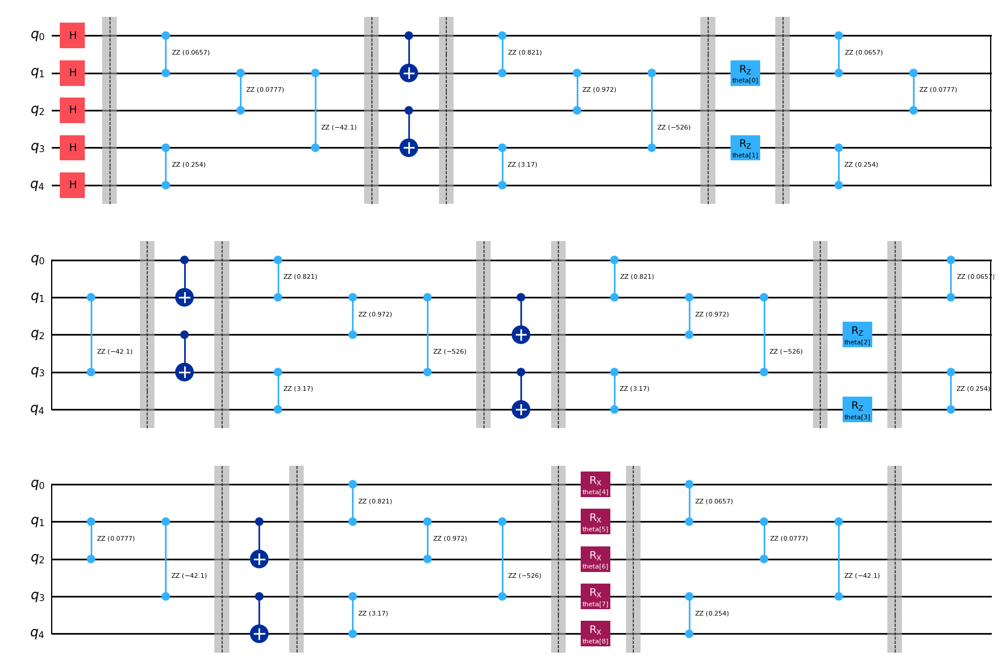

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

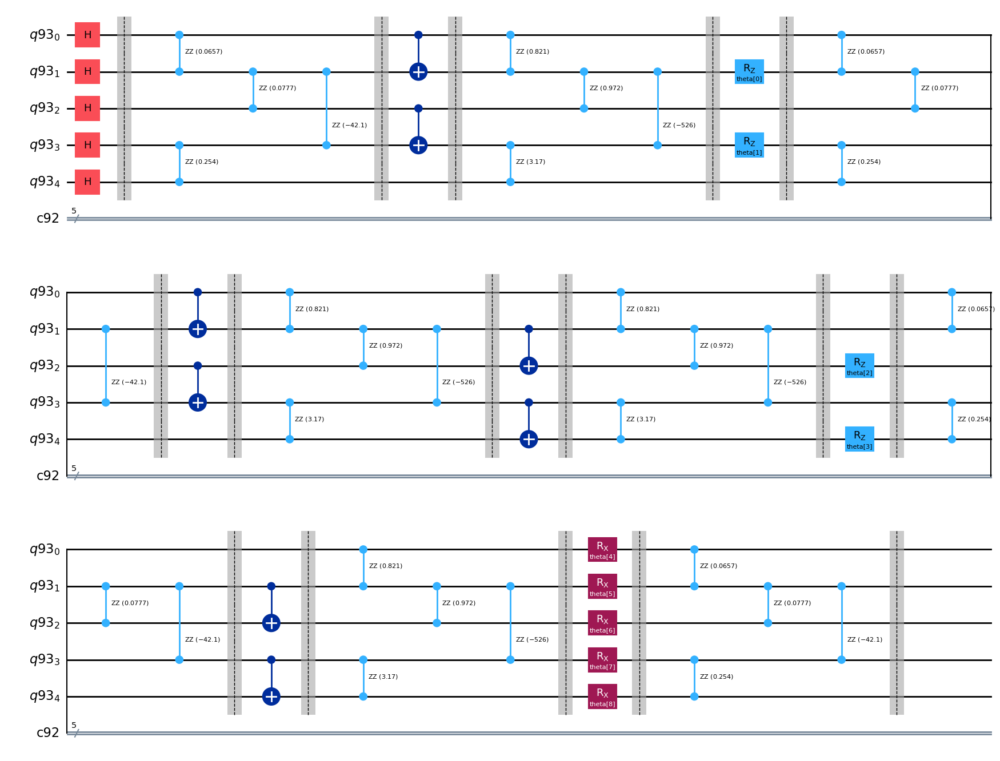

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

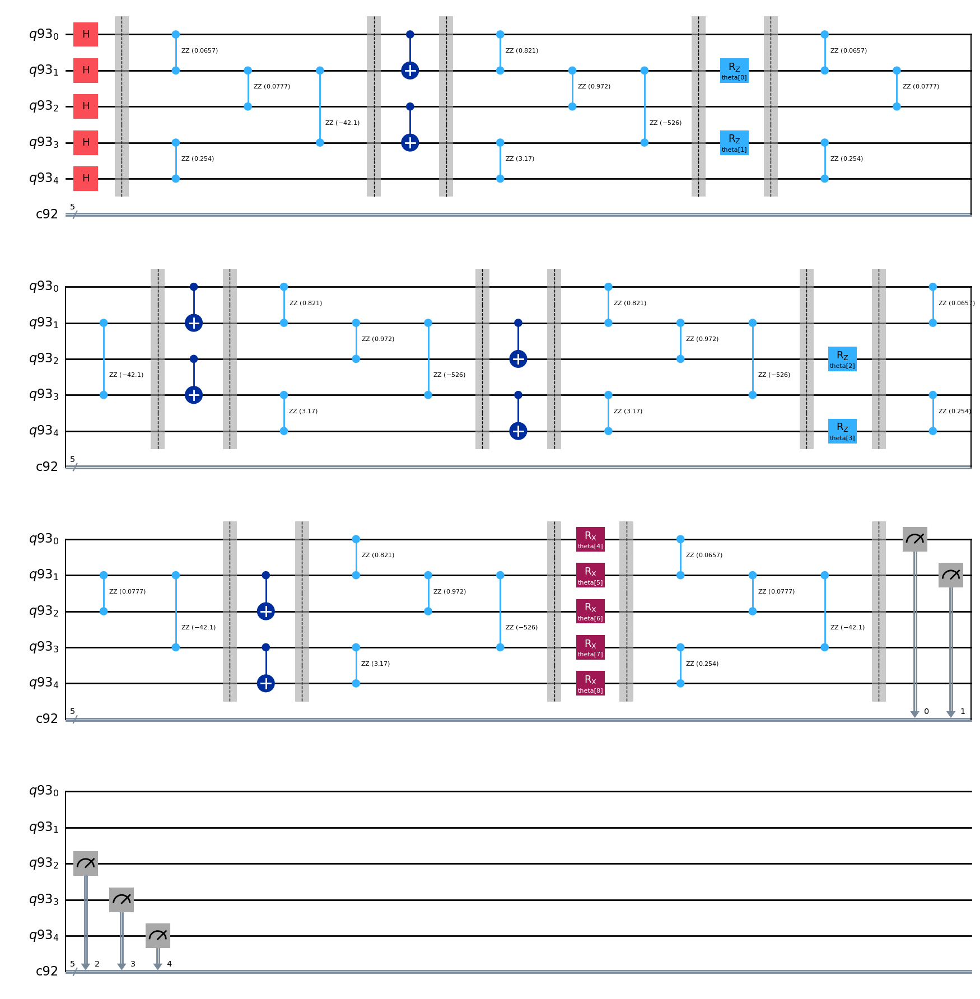

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

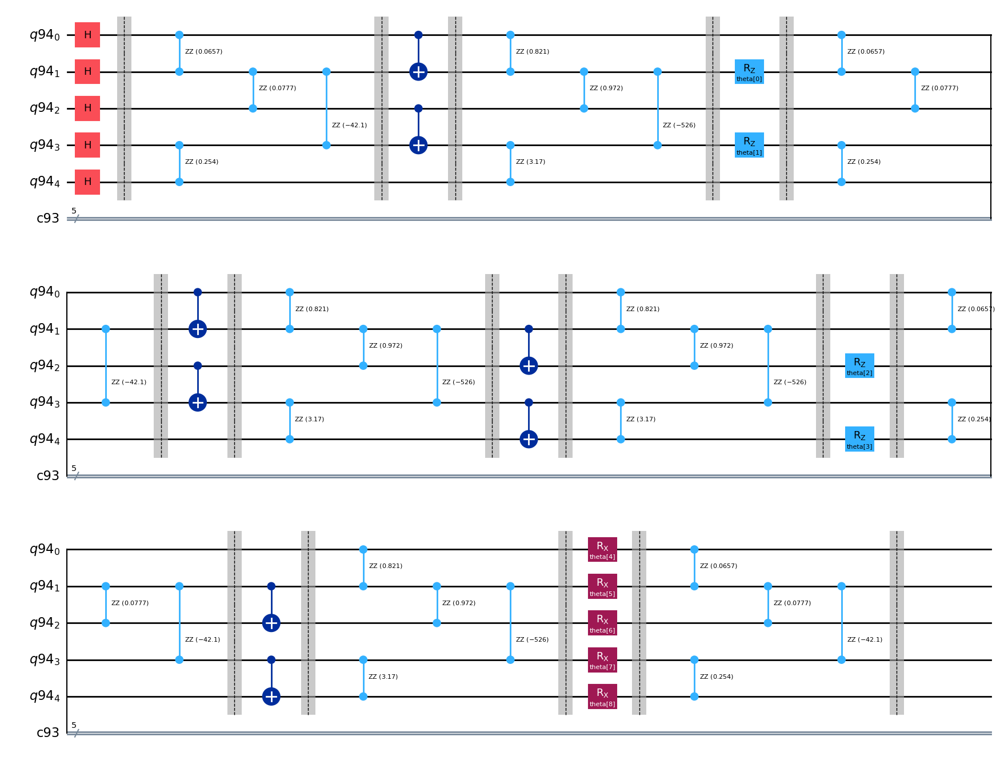

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

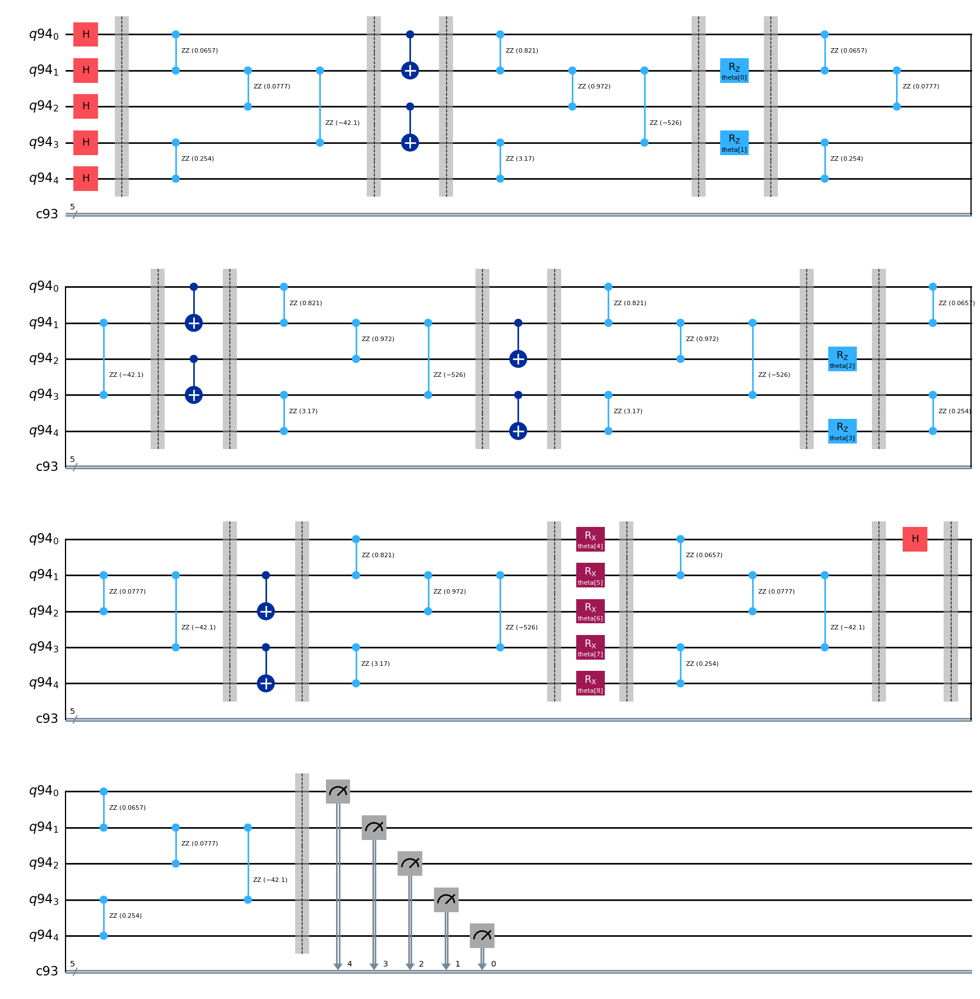

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

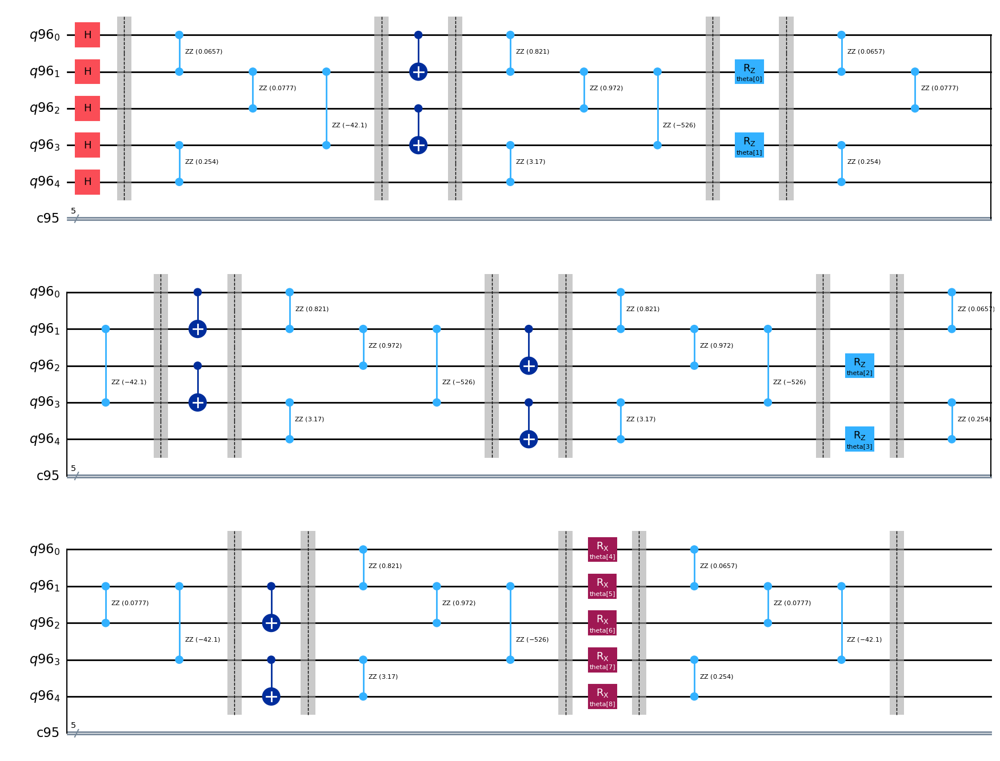

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

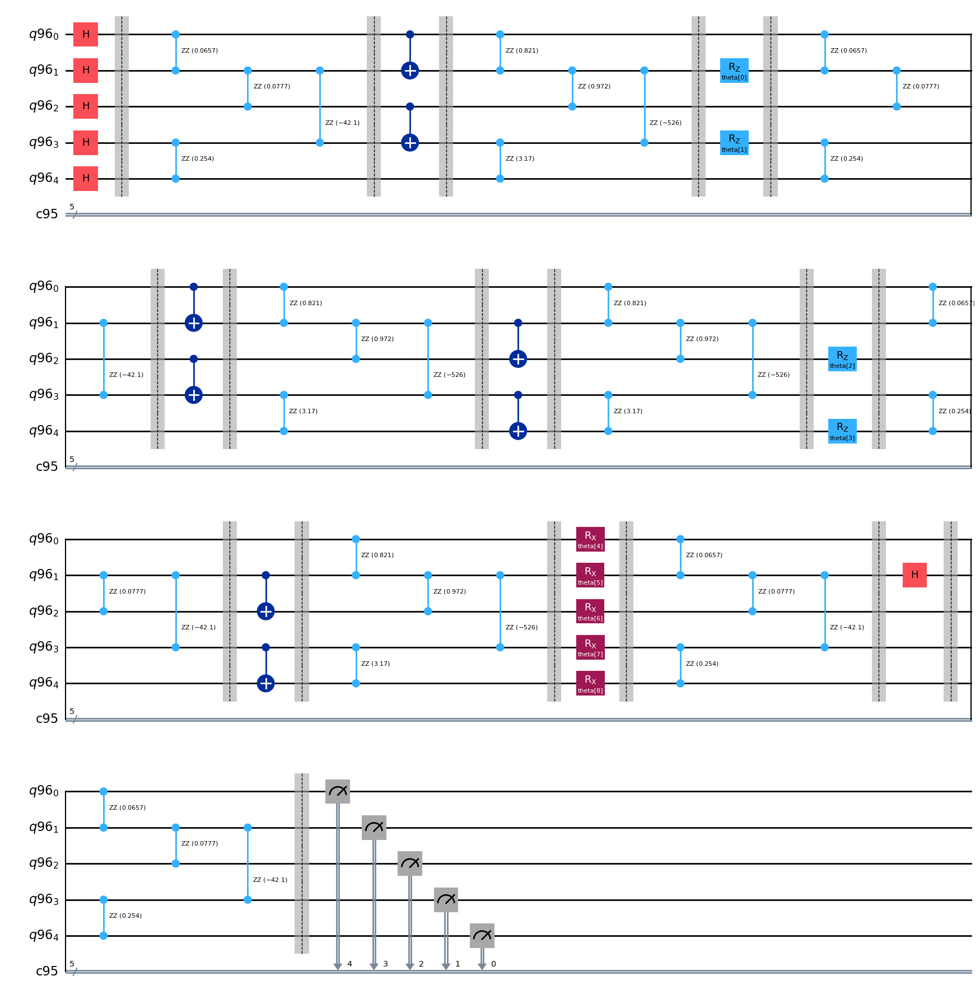

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

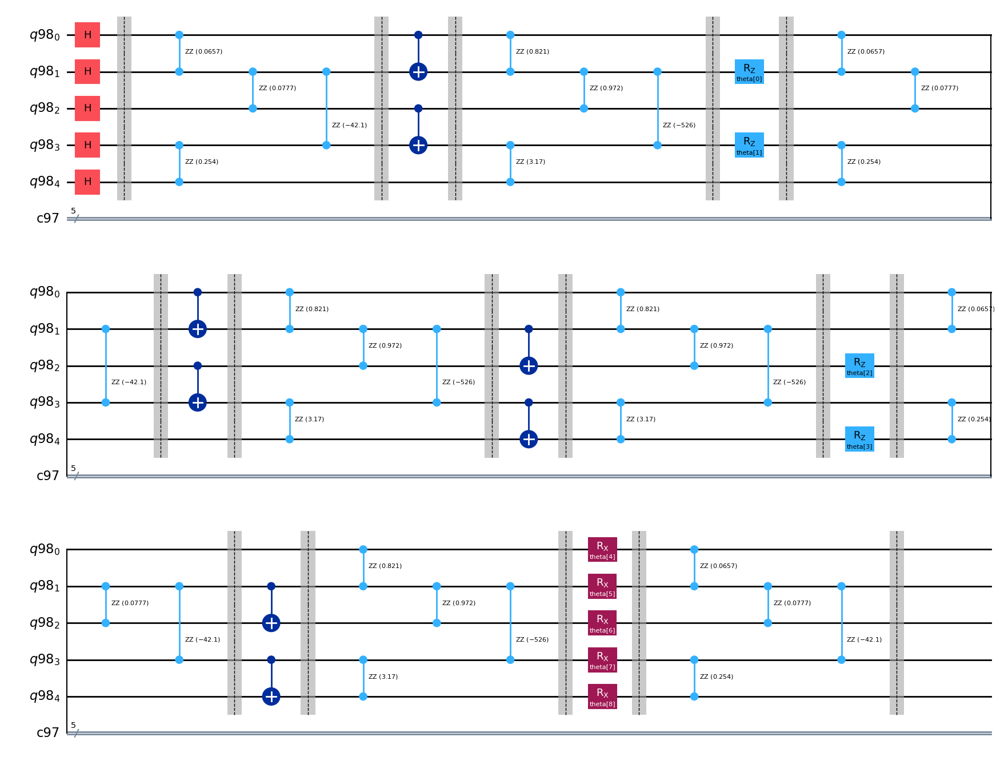

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

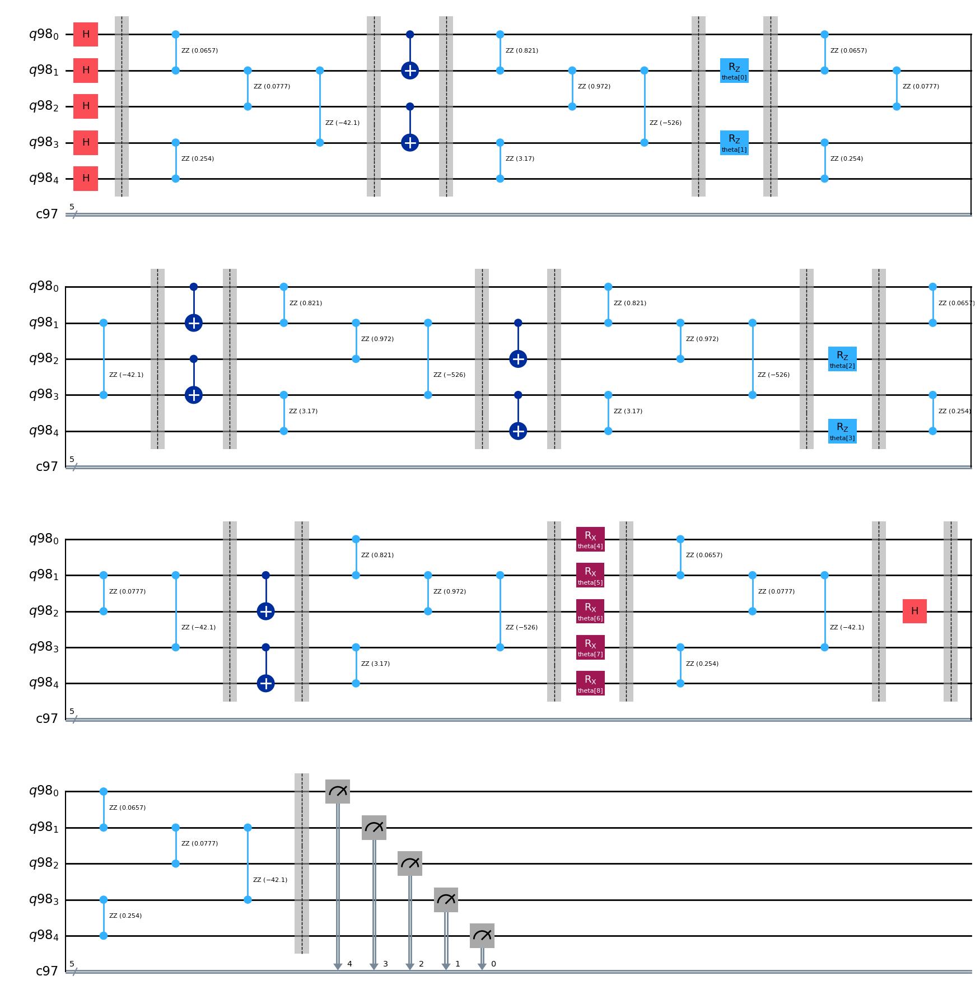

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

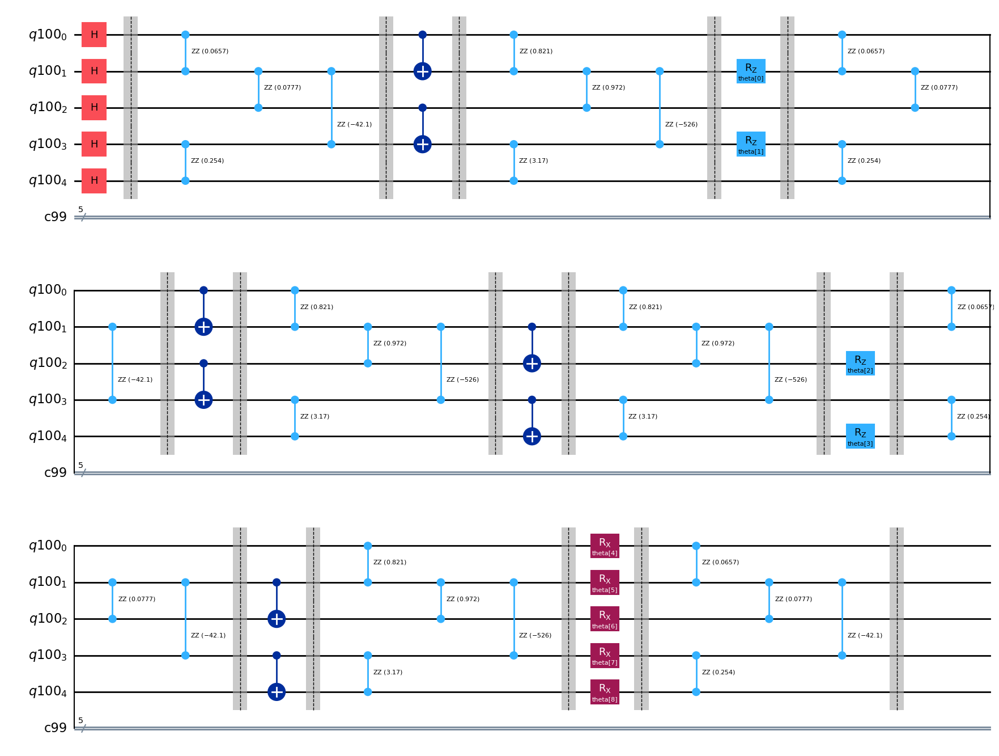

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

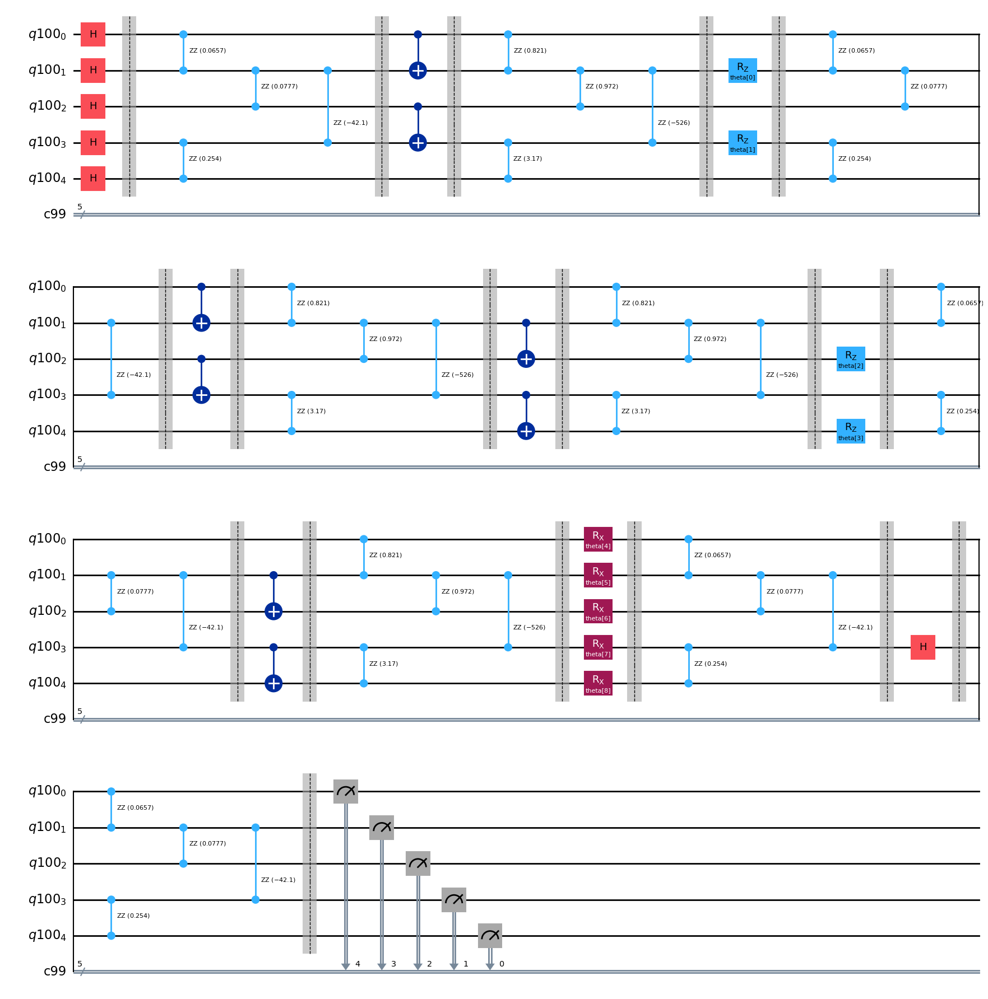

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

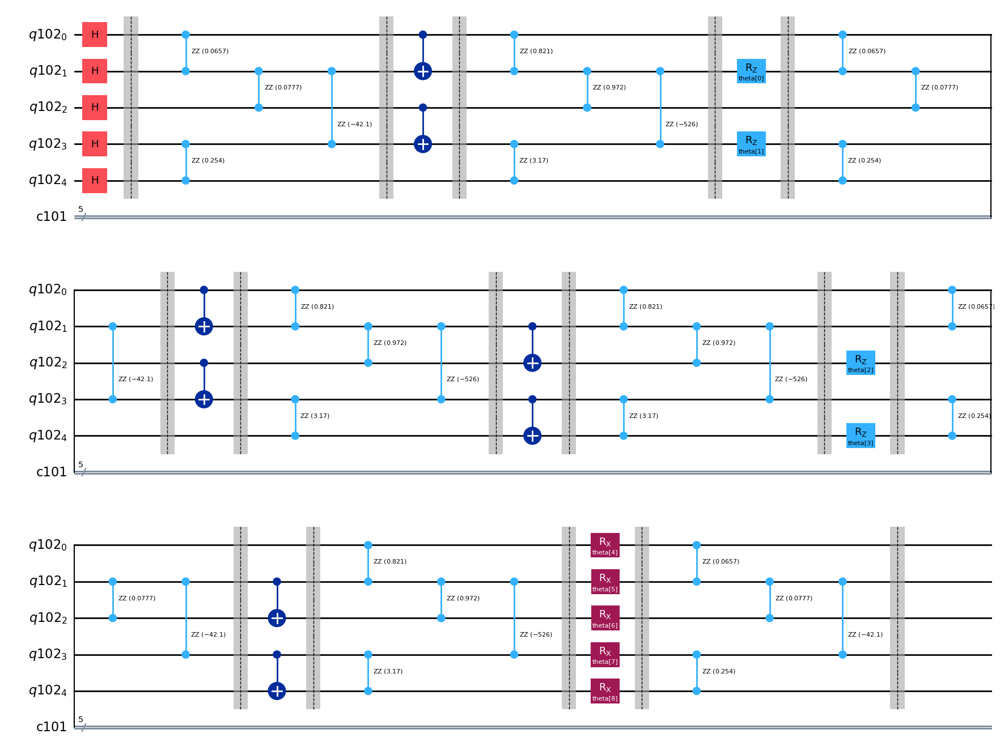

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

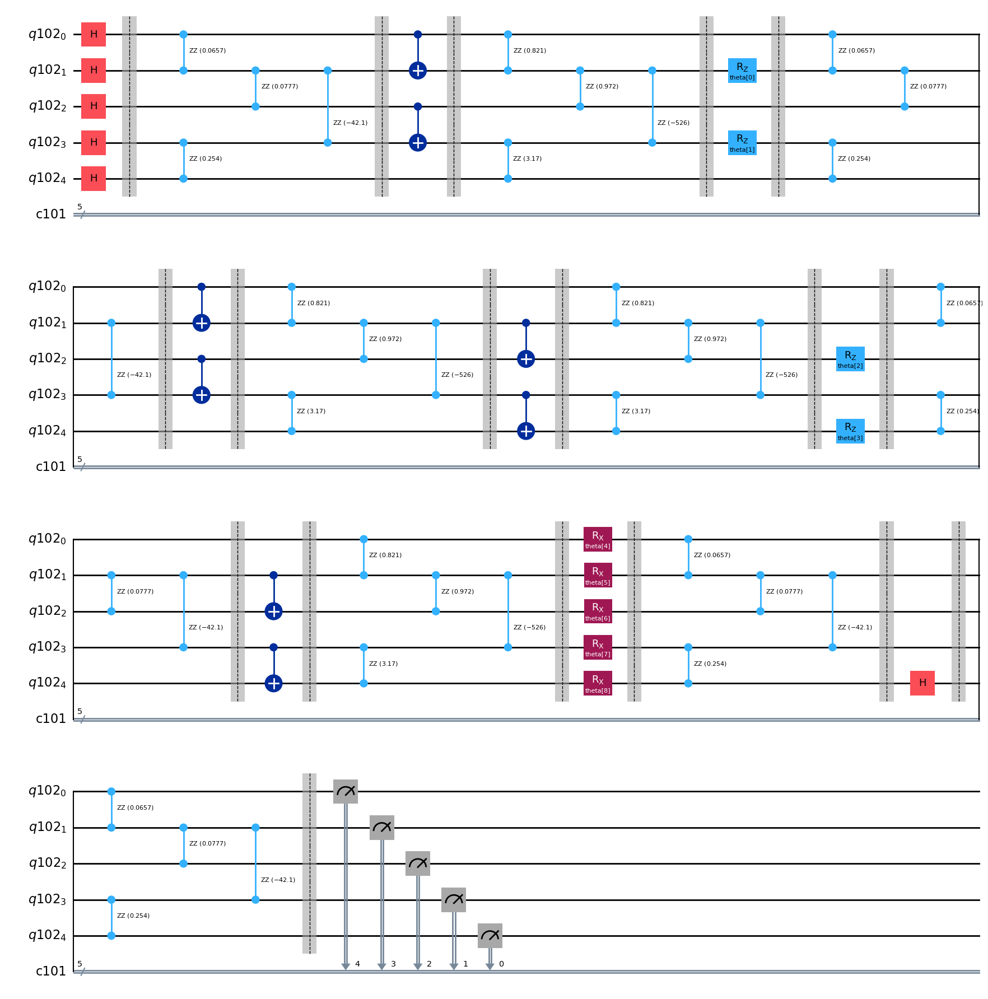

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-3.4646000000000003
-2.474600000000001
-3.502600000000001
-2.998999999999999
-3.463799999999999
-3.463399999999999
-3.6108000000000007
-3.3735999999999997
-3.4320000000000004
-3.0732
-3.4974
-3.502600000000001
-2.7238
-3.5250000000000004
-3.4165999999999994
-3.4338000000000015
-3.0194
-3.5598000000000005
-3.6485999999999996
-3.3842


In [ ]:
lowest_energy_vqe

-3.6485999999999996

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.4646000000000003
-2.474600000000001
-3.502600000000001
-2.998999999999999
-3.463799999999999
-3.463399999999999
-3.6108000000000007
-3.3735999999999997
-3.4320000000000004
-3.0732
-3.4974
-3.502600000000001
-2.7238
-3.5250000000000004
-3.4165999999999994
-3.4338000000000015
-3.0194
-3.5598000000000005
-3.6485999999999996
-3.3842


<ipython-input-378-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:54: R

         Current function value: nan
         Iterations: 19
         Function evaluations: 1050
         Gradient evaluations: 150
Optimization terminated successfully.
         Current function value: -5.395860
         Iterations: 43
         Function evaluations: 441
         Gradient evaluations: 63


<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-381-942dbc8389c9>:103: RuntimeWarning: overflow

         Current function value: nan
         Iterations: 34
         Function evaluations: 2058
         Gradient evaluations: 294
Optimization terminated successfully.
         Current function value: -5.684147
         Iterations: 48
         Function evaluations: 448
         Gradient evaluations: 64


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.448388
         Iterations: 300
         Function evaluations: 2814
         Gradient evaluations: 402


<ipython-input-381-942dbc8389c9>:82: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-381-942dbc8389c9>:136: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]
<ipython-input-381-942dbc8389c9>:99: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+4]
<ipython-input-378-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ip

         Current function value: nan
         Iterations: 35
         Function evaluations: 1218
         Gradient evaluations: 174
Optimization terminated successfully.
         Current function value: -5.400954
         Iterations: 52
         Function evaluations: 518
         Gradient evaluations: 74


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.684147
         Iterations: 42
         Function evaluations: 537
         Gradient evaluations: 75
Optimization terminated successfully.
         Current function value: -5.669170
         Iterations: 66
         Function evaluations: 504
         Gradient evaluations: 72


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.684147
         Iterations: 65
         Function evaluations: 880
         Gradient evaluations: 124
Optimization terminated successfully.
         Current function value: -6.431752
         Iterations: 40
         Function evaluations: 336
         Gradient evaluations: 48
Optimization terminated successfully.
         Current function value: -5.355188
         Iterations: 57
         Function evaluations: 448
         Gradient evaluations: 64
Optimization terminated successfully.
         Current function value: -5.684147
         Iterations: 39
         Function evaluations: 322
         Gradient evaluations: 46


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.169592
         Iterations: 300
         Function evaluations: 2786
         Gradient evaluations: 398


<ipython-input-378-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:9: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - pr

         Current function value: nan
         Iterations: 32
         Function evaluations: 1246
         Gradient evaluations: 178
Optimization terminated successfully.
         Current function value: -5.684147
         Iterations: 49
         Function evaluations: 413
         Gradient evaluations: 59


<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = n

         Current function value: nan
         Iterations: 86
         Function evaluations: 1687
         Gradient evaluations: 241
Optimization terminated successfully.
         Current function value: -5.684147
         Iterations: 43
         Function evaluations: 308
         Gradient evaluations: 44


<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-381-942dbc8389c9>:82: RuntimeWarning: ove

         Current function value: nan
         Iterations: 36
         Function evaluations: 1078
         Gradient evaluations: 154
         Current function value: -28.169608
         Iterations: 300
         Function evaluations: 2695
         Gradient evaluations: 385


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-28.448387903780223

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.4646000000000003
-2.474600000000001
-3.502600000000001
-2.998999999999999
-3.463799999999999
-3.463399999999999
-3.6108000000000007
-3.3735999999999997
-3.4320000000000004
-3.0732
-3.4974
-3.502600000000001
-2.7238
-3.5250000000000004
-3.4165999999999994
-3.4338000000000015
-3.0194
-3.5598000000000005
-3.6485999999999996
-3.3842


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -17.826906
         Iterations: 185
         Function evaluations: 9929
         Gradient evaluations: 310
Optimization terminated successfully.
         Current function value: -5.135173
         Iterations: 47
         Function evaluations: 2400
         Gradient evaluations: 75


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -9.328196
         Iterations: 88
         Function evaluations: 5797
         Gradient evaluations: 181


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -27.344254
         Iterations: 27
         Function evaluations: 2411
         Gradient evaluations: 75


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.984188
         Iterations: 21
         Function evaluations: 2182
         Gradient evaluations: 68
Optimization terminated successfully.
         Current function value: -7.449584
         Iterations: 158
         Function evaluations: 6560
         Gradient evaluations: 205


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.511682
         Iterations: 154
         Function evaluations: 9696
         Gradient evaluations: 303


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.255190
         Iterations: 57
         Function evaluations: 4966
         Gradient evaluations: 155
Optimization terminated successfully.
         Current function value: -5.368319
         Iterations: 84
         Function evaluations: 4928
         Gradient evaluations: 154


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.208002
         Iterations: 118
         Function evaluations: 5728
         Gradient evaluations: 179


<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:48: RuntimeWarning: overflow encountered in 

         Current function value: nan
         Iterations: 35
         Function evaluations: 9569
         Gradient evaluations: 299


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.000757
         Iterations: 59
         Function evaluations: 7916
         Gradient evaluations: 247


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.415959
         Iterations: 136
         Function evaluations: 8332
         Gradient evaluations: 260


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -26.191197
         Iterations: 73
         Function evaluations: 5670
         Gradient evaluations: 177


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -9198580.570418
         Iterations: 61
         Function evaluations: 9610
         Gradient evaluations: 300


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.405522
         Iterations: 128
         Function evaluations: 7744
         Gradient evaluations: 242


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -11.892879
         Iterations: 80
         Function evaluations: 5415
         Gradient evaluations: 169


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -47.405951
         Iterations: 262
         Function evaluations: 15399
         Gradient evaluations: 481
Optimization terminated successfully.
         Current function value: -6.260458
         Iterations: 94
         Function evaluations: 5952
         Gradient evaluations: 186
         Current function value: -28.622243
         Iterations: 300
         Function evaluations: 15552
         Gradient evaluations: 486


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-9198580.570417544

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.4646000000000003
-2.474600000000001
-3.502600000000001
-2.998999999999999
-3.463799999999999
-3.463399999999999
-3.6108000000000007
-3.3735999999999997
-3.4320000000000004
-3.0732
-3.4974
-3.502600000000001
-2.7238
-3.5250000000000004
-3.4165999999999994
-3.4338000000000015
-3.0194
-3.5598000000000005
-3.6485999999999996
-3.3842


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -22.670112
         Iterations: 30
         Function evaluations: 7308
         Gradient evaluations: 128


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.519030
         Iterations: 83
         Function evaluations: 12381
         Gradient evaluations: 217


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.487348
         Iterations: 84
         Function evaluations: 17448
         Gradient evaluations: 306


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.145968
         Iterations: 28
         Function evaluations: 9815
         Gradient evaluations: 172


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.536621
         Iterations: 8
         Function evaluations: 2856
         Gradient evaluations: 50


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.625020
         Iterations: 300
         Function evaluations: 33117
         Gradient evaluations: 581


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.069391
         Iterations: 145
         Function evaluations: 14544
         Gradient evaluations: 255


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.010429
         Iterations: 142
         Function evaluations: 18992
         Gradient evaluations: 333


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.383814
         Iterations: 56
         Function evaluations: 8497
         Gradient evaluations: 149


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.721817
         Iterations: 67
         Function evaluations: 7529
         Gradient evaluations: 132


<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = n

         Current function value: nan
         Iterations: 90
         Function evaluations: 14820
         Gradient evaluations: 260


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -25.898959
         Iterations: 72
         Function evaluations: 10443
         Gradient evaluations: 183


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -13.309173
         Iterations: 28
         Function evaluations: 7926
         Gradient evaluations: 139


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.628241
         Iterations: 300
         Function evaluations: 25992
         Gradient evaluations: 456


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.569296
         Iterations: 152
         Function evaluations: 13224
         Gradient evaluations: 232


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.645169
         Iterations: 133
         Function evaluations: 9531
         Gradient evaluations: 167


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -28.620892
         Iterations: 287
         Function evaluations: 29253
         Gradient evaluations: 513


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.362012
         Iterations: 129
         Function evaluations: 14319
         Gradient evaluations: 251


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -26.188448
         Iterations: 66
         Function evaluations: 8504
         Gradient evaluations: 149
         Current function value: -6.459287
         Iterations: 129
         Function evaluations: 14375
         Gradient evaluations: 252


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-28.628240745002135

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.4646000000000003
-2.474600000000001
-3.502600000000001
-2.998999999999999
-3.463799999999999
-3.463399999999999
-3.6108000000000007
-3.3735999999999997
-3.4320000000000004
-3.0732
-3.4974
-3.502600000000001
-2.7238
-3.5250000000000004
-3.4165999999999994
-3.4338000000000015
-3.0194
-3.5598000000000005
-3.6485999999999996
-3.3842


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.209116
         Iterations: 97
         Function evaluations: 3328
         Gradient evaluations: 128


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.329709
         Iterations: 111
         Function evaluations: 4768
         Gradient evaluations: 183


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.223034
         Iterations: 70
         Function evaluations: 3198
         Gradient evaluations: 123


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.294821
         Iterations: 50
         Function evaluations: 3520
         Gradient evaluations: 135
Optimization terminated successfully.
         Current function value: -3.674755
         Iterations: 16
         Function evaluations: 442
         Gradient evaluations: 17


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.202085
         Iterations: 36
         Function evaluations: 3154
         Gradient evaluations: 121
Optimization terminated successfully.
         Current function value: -6.419545
         Iterations: 59
         Function evaluations: 2418
         Gradient evaluations: 93
Optimization terminated successfully.
         Current function value: -3.674755
         Iterations: 15
         Function evaluations: 416
         Gradient evaluations: 16


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.240060
         Iterations: 7
         Function evaluations: 2163
         Gradient evaluations: 83
Optimization terminated successfully.
         Current function value: -5.195030
         Iterations: 72
         Function evaluations: 2964
         Gradient evaluations: 114


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.104961
         Iterations: 13
         Function evaluations: 2242
         Gradient evaluations: 86
Optimization terminated successfully.
         Current function value: -4.353566
         Iterations: 25
         Function evaluations: 936
         Gradient evaluations: 36


<ipython-input-378-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:54: R

         Current function value: nan
         Iterations: 97
         Function evaluations: 8086
         Gradient evaluations: 311
Optimization terminated successfully.
         Current function value: -3.674755
         Iterations: 13
         Function evaluations: 390
         Gradient evaluations: 15


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.921868
         Iterations: 13
         Function evaluations: 2844
         Gradient evaluations: 109


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.516640
         Iterations: 202
         Function evaluations: 7889
         Gradient evaluations: 303


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.441816
         Iterations: 109
         Function evaluations: 4690
         Gradient evaluations: 180


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.419052
         Iterations: 59
         Function evaluations: 5238
         Gradient evaluations: 201


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.274913
         Iterations: 9
         Function evaluations: 2632
         Gradient evaluations: 101
         Current function value: -4.959569
         Iterations: 101
         Function evaluations: 5706
         Gradient evaluations: 219


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-6.41954454221737

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-3.4646000000000003
-2.474600000000001
-3.502600000000001
-2.998999999999999
-3.463799999999999
-3.463399999999999
-3.6108000000000007
-3.3735999999999997
-3.4320000000000004
-3.0732
-3.4974
-3.502600000000001
-2.7238
-3.5250000000000004
-3.4165999999999994
-3.4338000000000015
-3.0194
-3.5598000000000005
-3.6485999999999996
-3.3842


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.199173
         Iterations: 38
         Function evaluations: 5893
         Gradient evaluations: 107
Optimization terminated successfully.
         Current function value: -5.136330
         Iterations: 29
         Function evaluations: 2145
         Gradient evaluations: 39


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.191021
         Iterations: 14
         Function evaluations: 5452
         Gradient evaluations: 99
Optimization terminated successfully.
         Current function value: -3.674755
         Iterations: 14
         Function evaluations: 825
         Gradient evaluations: 15
Optimization terminated successfully.
         Current function value: -3.674755
         Iterations: 12
         Function evaluations: 715
         Gradient evaluations: 13


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.209117
         Iterations: 56
         Function evaluations: 5292
         Gradient evaluations: 96


<ipython-input-381-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-381-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-381-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = n

         Current function value: nan
         Iterations: 77
         Function evaluations: 16610
         Gradient evaluations: 302


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.127909
         Iterations: 46
         Function evaluations: 5567
         Gradient evaluations: 101


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.035079
         Iterations: 19
         Function evaluations: 5897
         Gradient evaluations: 107


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.304116
         Iterations: 46
         Function evaluations: 11232
         Gradient evaluations: 204
Optimization terminated successfully.
         Current function value: -5.216843
         Iterations: 64
         Function evaluations: 7095
         Gradient evaluations: 129
Optimization terminated successfully.
         Current function value: -4.304160
         Iterations: 15
         Function evaluations: 1375
         Gradient evaluations: 25


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.384627
         Iterations: 107
         Function evaluations: 12167
         Gradient evaluations: 221
Optimization terminated successfully.
         Current function value: -4.280941
         Iterations: 12
         Function evaluations: 770
         Gradient evaluations: 14


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.212176
         Iterations: 72
         Function evaluations: 11727
         Gradient evaluations: 213


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.516521
         Iterations: 112
         Function evaluations: 8690
         Gradient evaluations: 158


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.870625
         Iterations: 30
         Function evaluations: 7763
         Gradient evaluations: 141
Optimization terminated successfully.
         Current function value: -5.121736
         Iterations: 35
         Function evaluations: 2585
         Gradient evaluations: 47
Optimization terminated successfully.
         Current function value: -4.874037
         Iterations: 67
         Function evaluations: 4785
         Gradient evaluations: 87
Optimization terminated successfully.
         Current function value: -4.280941
         Iterations: 34
         Function evaluations: 2255
         Gradient evaluations: 41


In [ ]:
lowest_energy_vqnhe

-6.3846272878712185

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 7MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 7MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.007                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23251842 5.13748158]
[10.15980491 10.37071062  9.97035447]
0.0007106218201018422
[5.13832596 4.98767404]
[ 9.96997321 10.12684103  9.66823576]
0.0008410272895007509
[4.98629309 5.01670691]
[10.00364158  9.66815576  9.72266266]
-0.33484424331813223
[5.01481661 5.28218339]
[ 9.72283926 10.2997021  10.25846864]
0.0027020972217579597


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(0.0003553109100509211,
 0.00042051364475037545,
 -0.16742212165906611,
 0.0013510486108789799)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

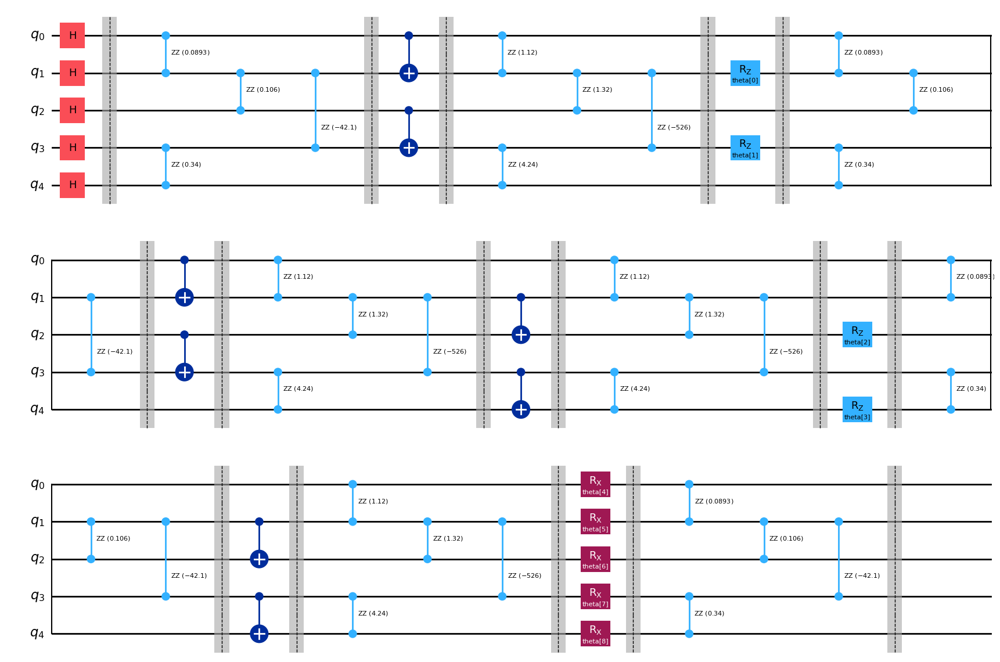

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

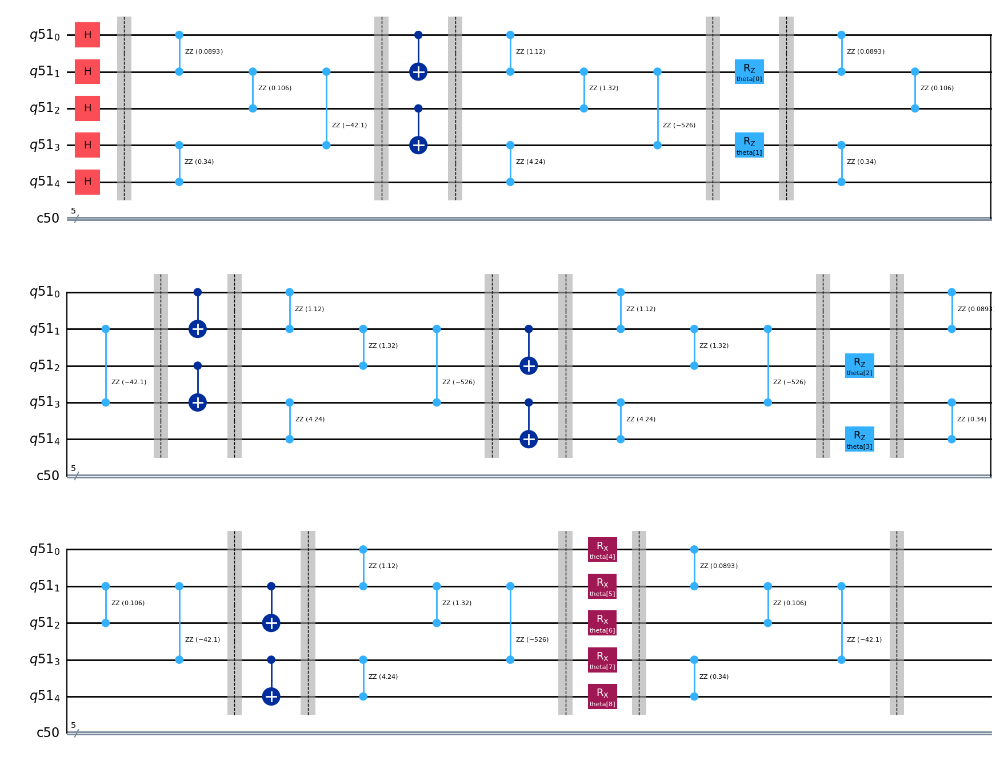

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

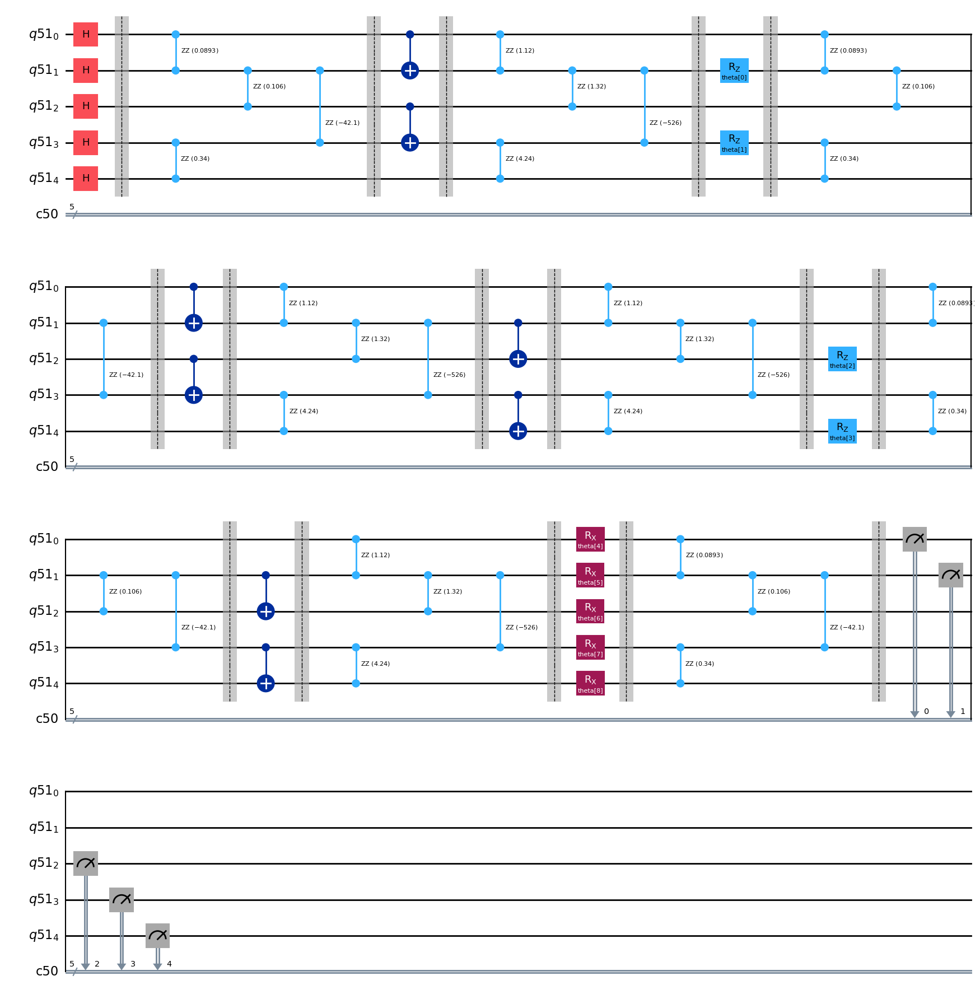

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

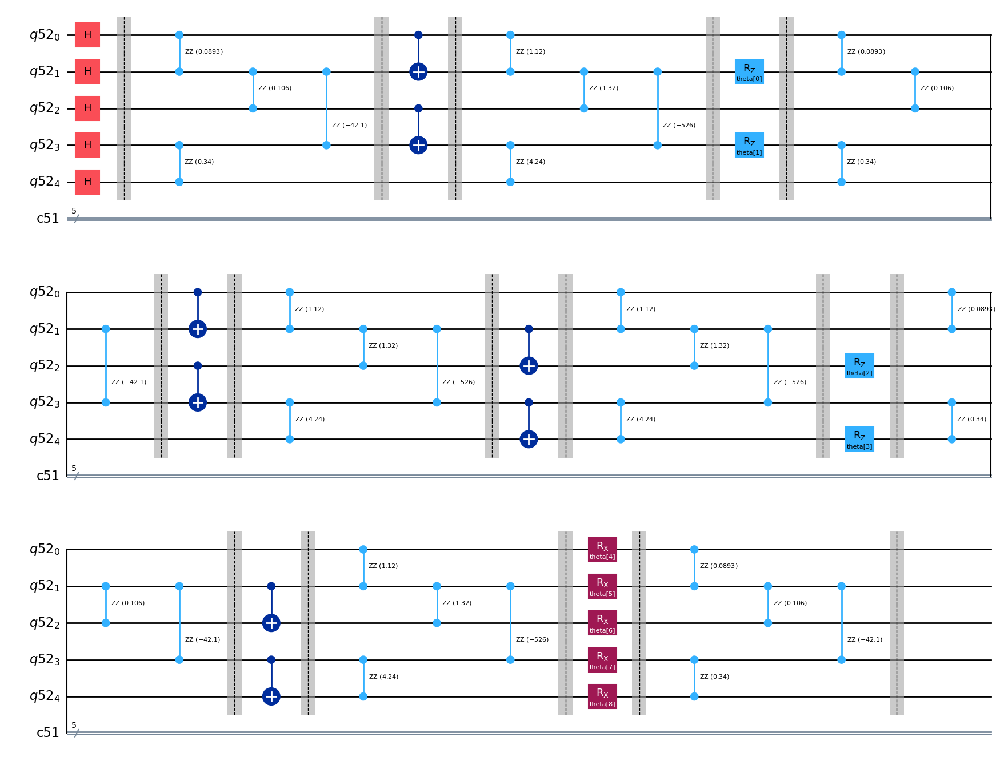

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

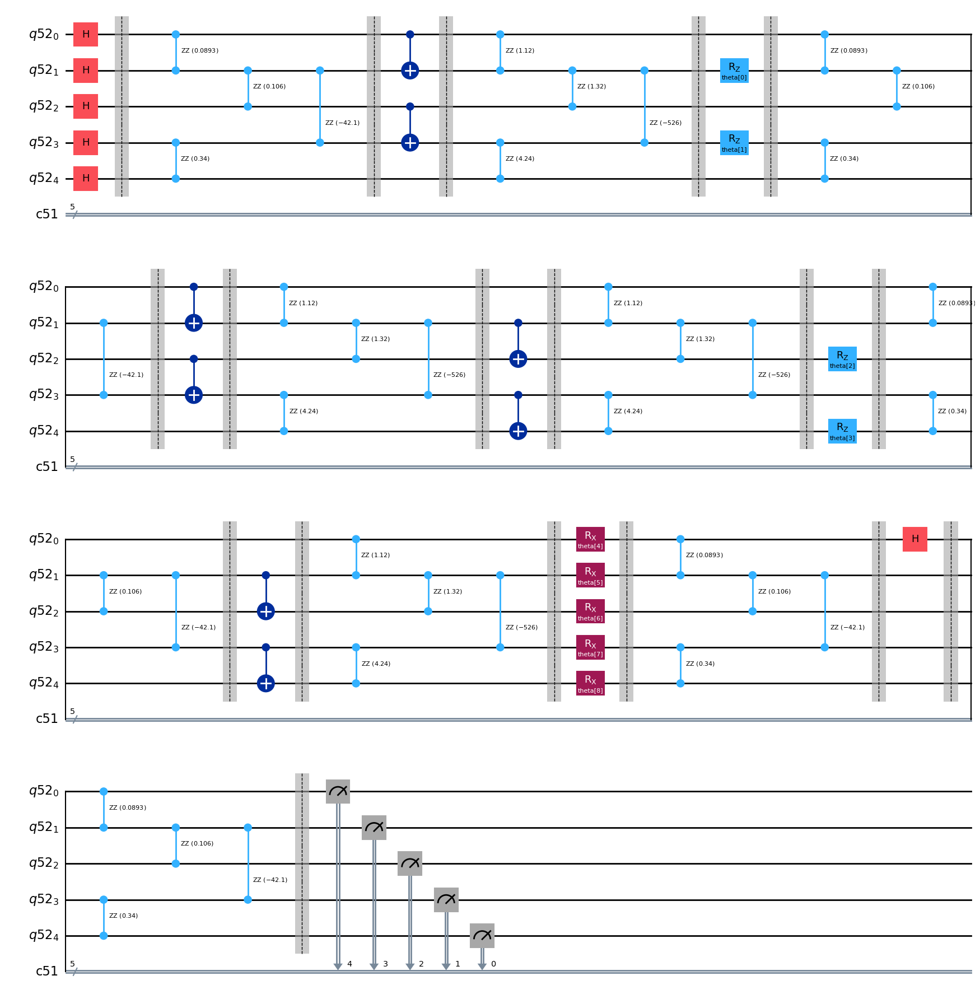

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

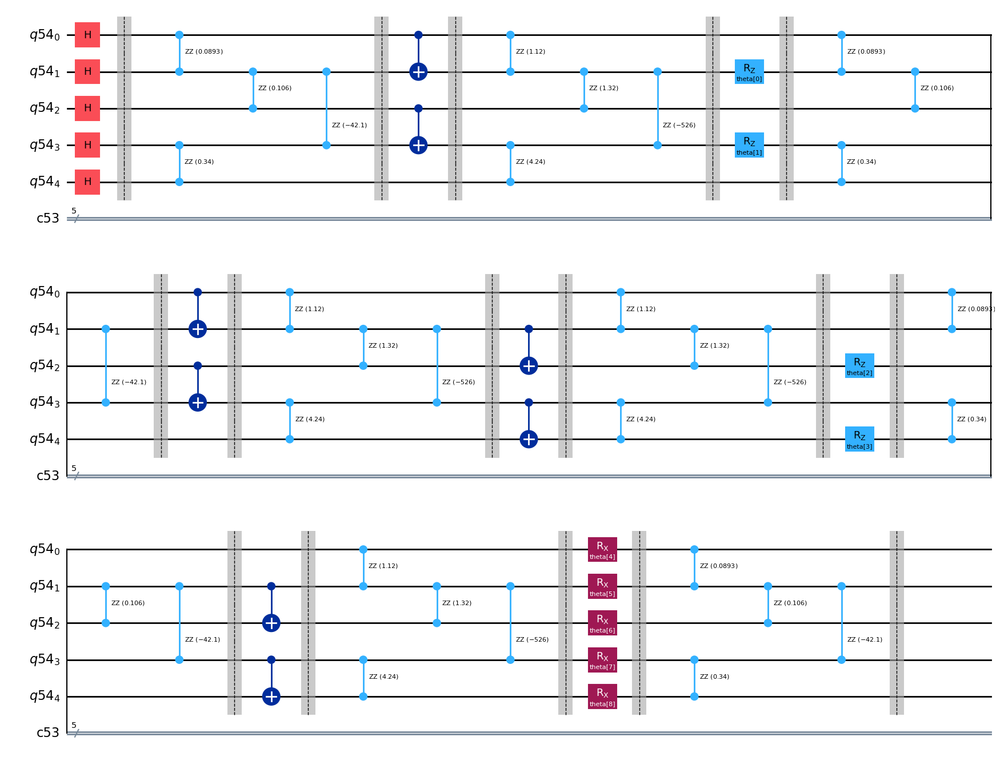

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

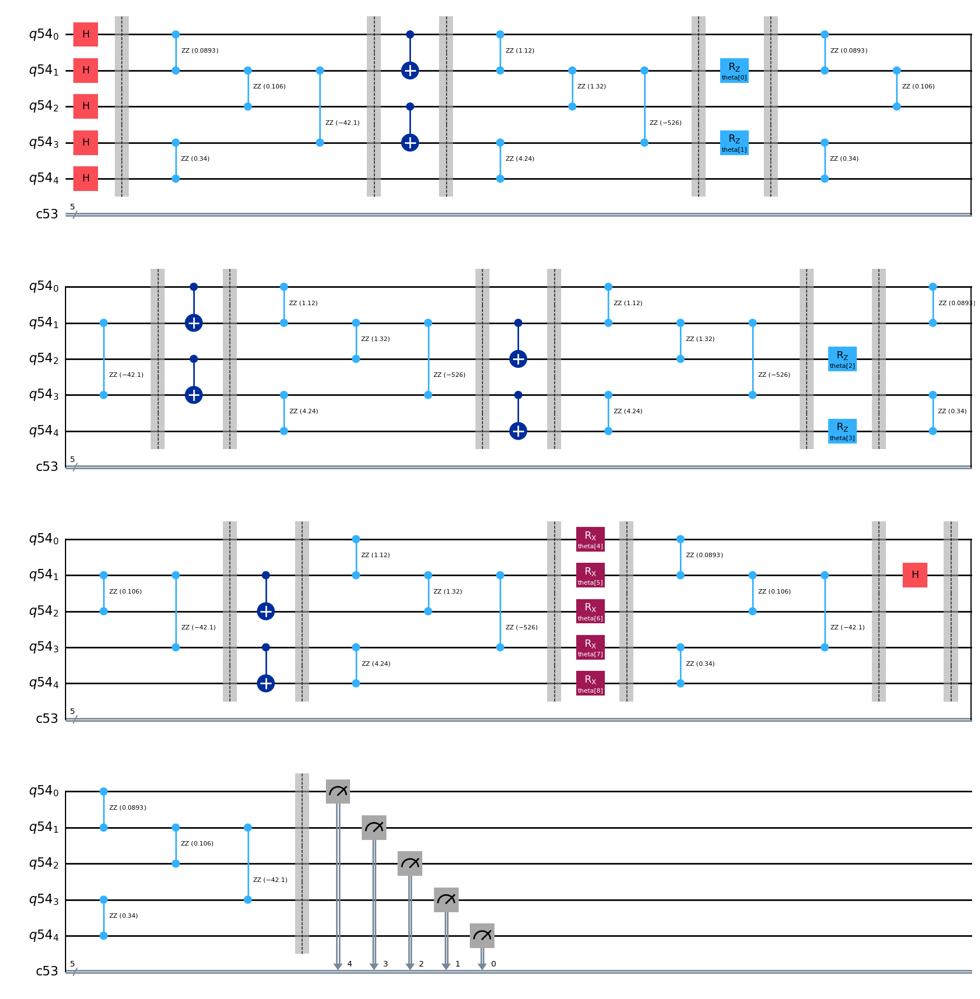

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

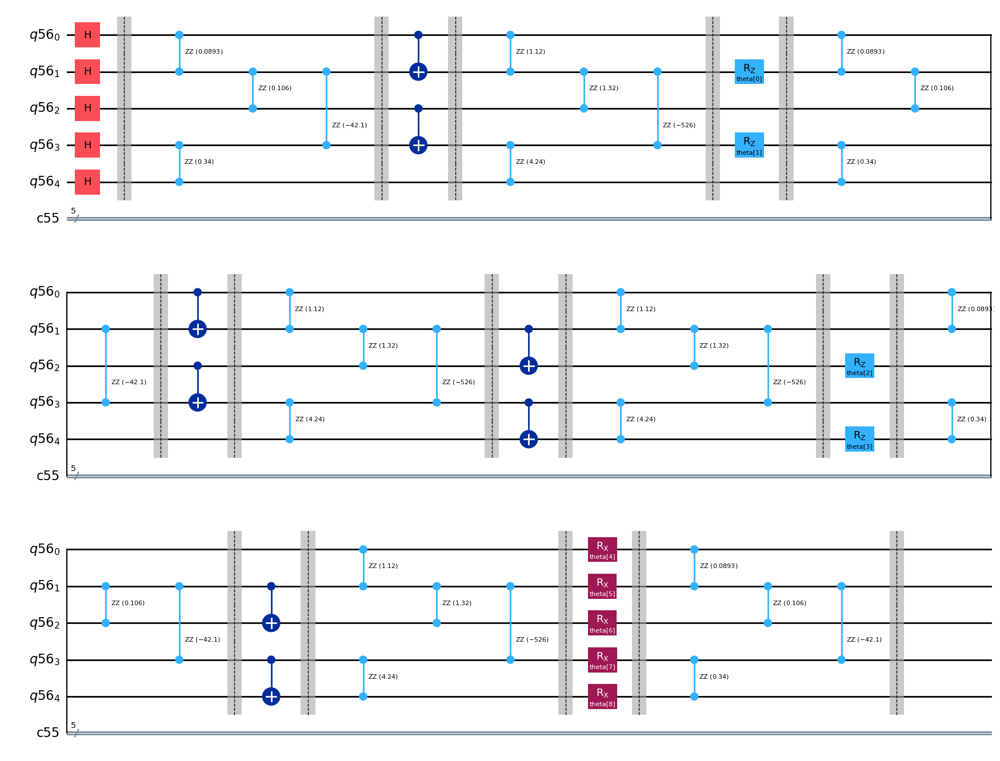

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

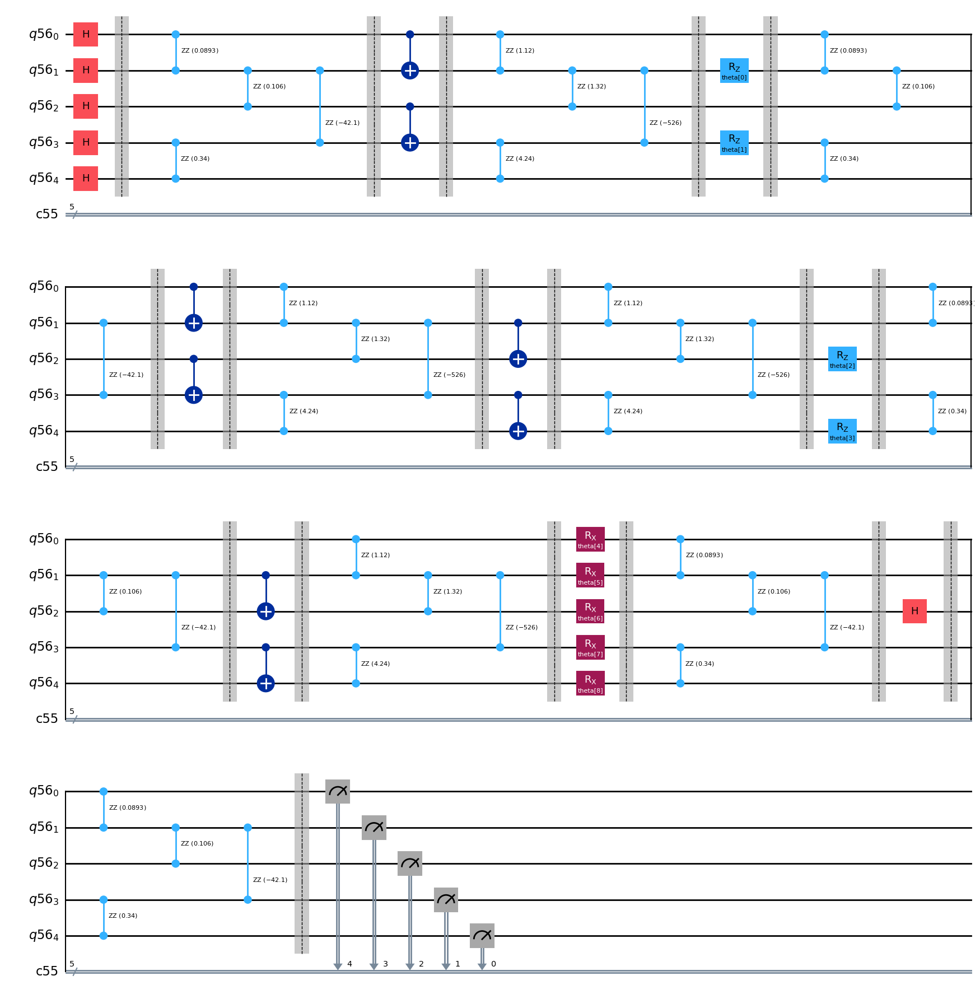

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

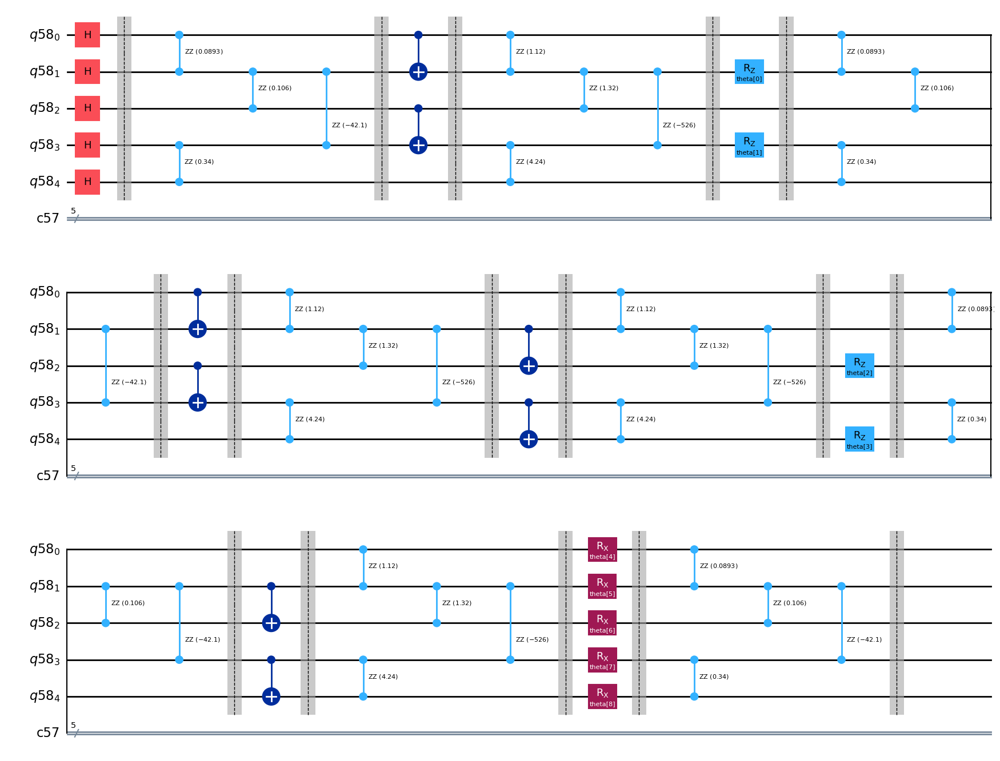

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

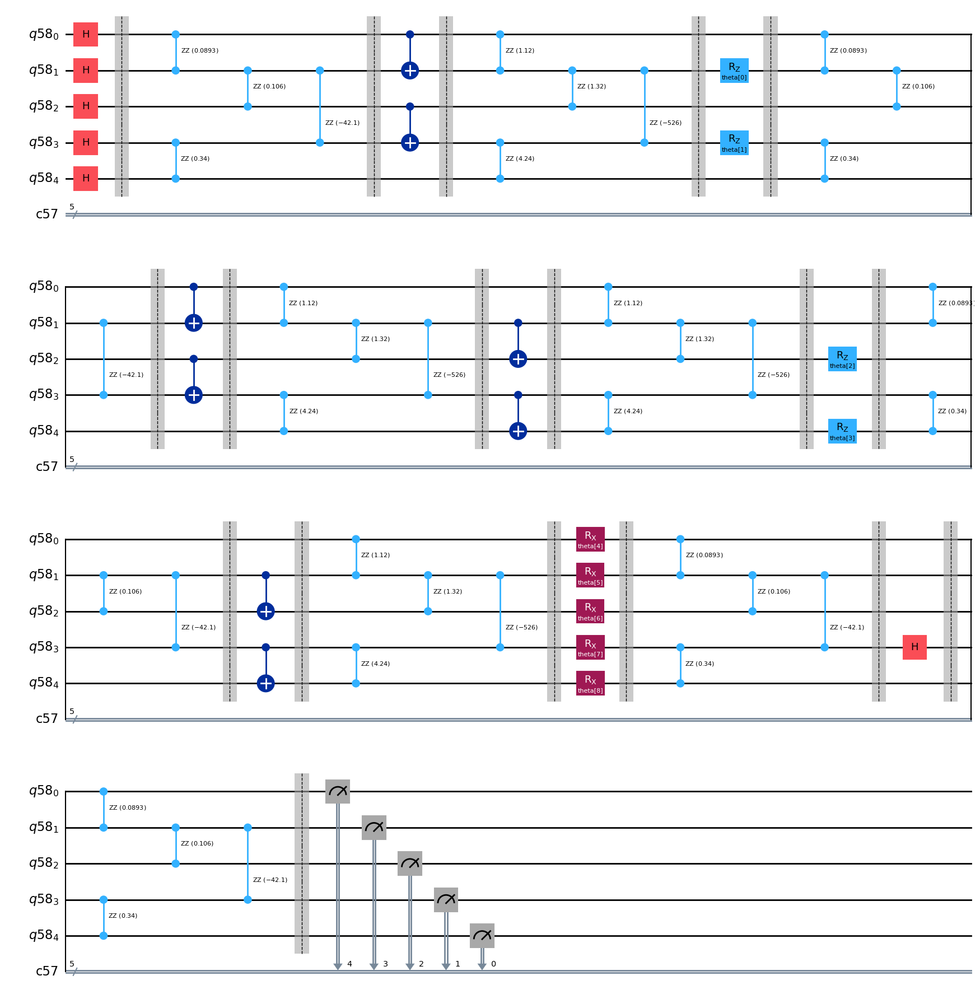

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

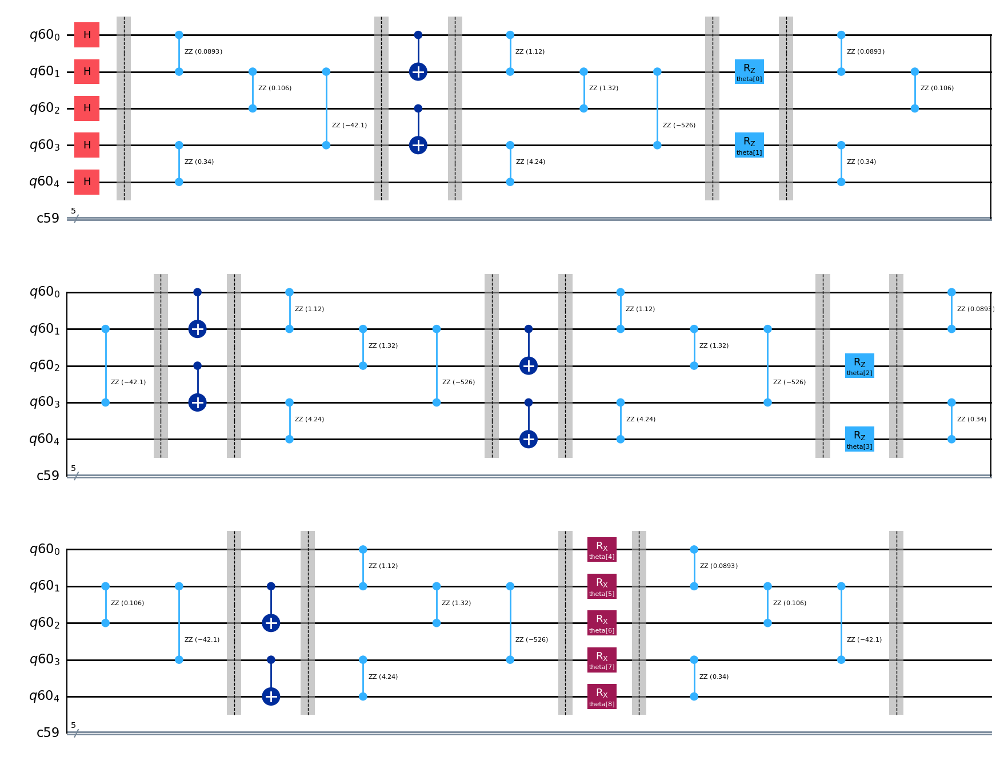

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

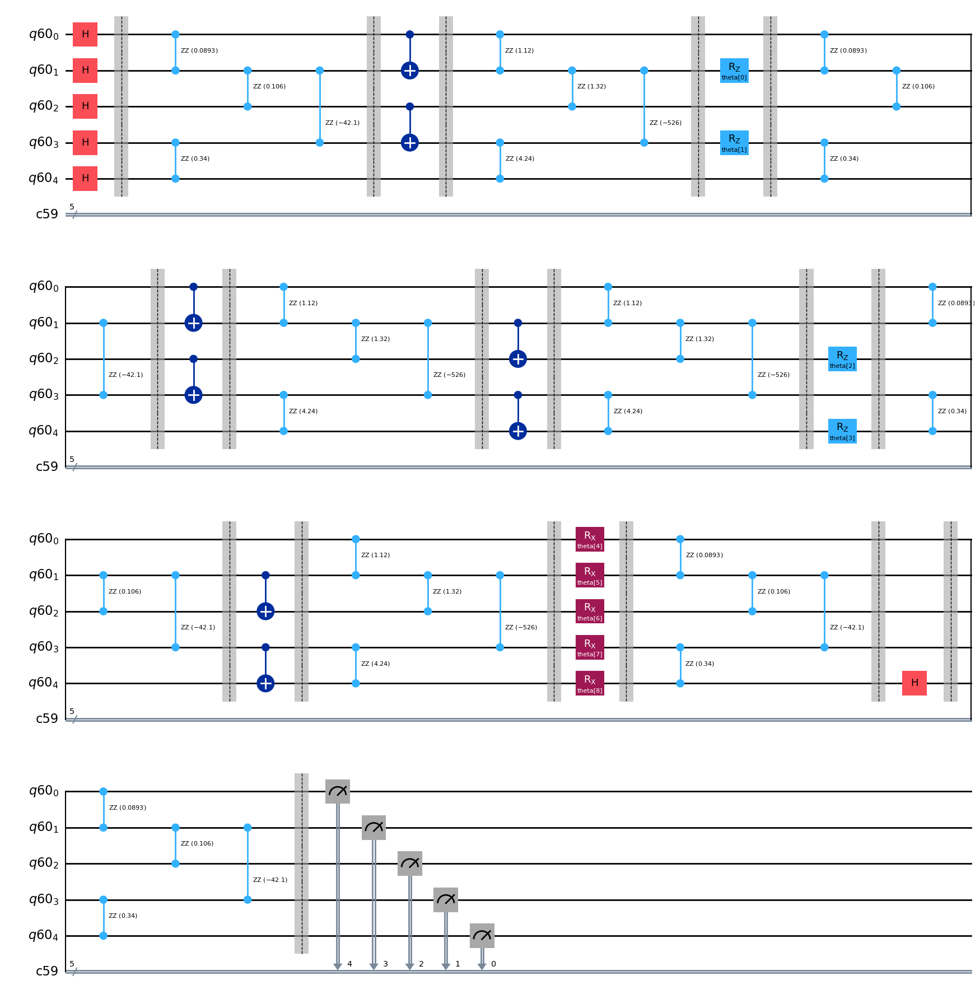

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-1.4591999999999996
-1.3214000000000001
-1.1858000000000002
-1.2037999999999998
-1.3125999999999995
-1.0796000000000001
-1.2788000000000002
-1.0839999999999999
-1.4019999999999997
-1.0902000000000003
-1.2498000000000002
-1.1699999999999997
-0.8236000000000001
-1.2970000000000004
-1.2846
-0.9817999999999998
-1.4732
-1.2849999999999997
-1.2794000000000003
-1.2402


In [ ]:
lowest_energy_vqe

-1.4732

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.4591999999999996
-1.3214000000000001
-1.1858000000000002
-1.2037999999999998
-1.3125999999999995
-1.0796000000000001
-1.2788000000000002
-1.0839999999999999
-1.4019999999999997
-1.0902000000000003
-1.2498000000000002
-1.1699999999999997
-0.8236000000000001
-1.2970000000000004
-1.2846
-0.9817999999999998
-1.4732
-1.2849999999999997
-1.2794000000000003
-1.2402
Optimization terminated successfully.
         Current function value: -2.343083
         Iterations: 22
         Function evaluations: 175
         Gradient evaluations: 25
Optimization terminated successfully.
         Current function value: -3.356647
         Iterations: 26
         Function evaluations: 210
         Gradient evaluations: 30


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in 

         Current function value: nan
         Iterations: 32
         Function evaluations: 1015
         Gradient evaluations: 145


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 43
         Function evaluations: 1113
         Gradient evaluations: 159
Optimization terminated successfully.
         Current function value: -2.539660
         Iterations: 11
         Function evaluations: 98
         Gradient evaluations: 14


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 38
         Function evaluations: 1120
         Gradient evaluations: 160
Optimization terminated successfully.
         Current function value: -4.448110
         Iterations: 48
         Function evaluations: 462
         Gradient evaluations: 66


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:56: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overf

         Current function value: nan
         Iterations: 42
         Function evaluations: 1092
         Gradient evaluations: 156
Optimization terminated successfully.
         Current function value: -3.348342
         Iterations: 57
         Function evaluations: 826
         Gradient evaluations: 118
Optimization terminated successfully.
         Current function value: -5.790830
         Iterations: 59
         Function evaluations: 588
         Gradient evaluations: 84
Optimization terminated successfully.
         Current function value: -3.359550
         Iterations: 67
         Function evaluations: 504
         Gradient evaluations: 72
Optimization terminated successfully.
         Current function value: -3.510446
         Iterations: 32
         Function evaluations: 238
         Gradient evaluations: 34


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 34
         Function evaluations: 1043
         Gradient evaluations: 149


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 37
         Function evaluations: 1050
         Gradient evaluations: 150
Optimization terminated successfully.
         Current function value: -9.107982
         Iterations: 89
         Function evaluations: 875
         Gradient evaluations: 125


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 55
         Function evaluations: 1211
         Gradient evaluations: 173
Optimization terminated successfully.
         Current function value: -3.359550
         Iterations: 73
         Function evaluations: 532
         Gradient evaluations: 76
Optimization terminated successfully.
         Current function value: -9.921962
         Iterations: 74
         Function evaluations: 749
         Gradient evaluations: 107
Optimization terminated successfully.
         Current function value: -2.343475
         Iterations: 29
         Function evaluations: 224
         Gradient evaluations: 32


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:86: RuntimeWarning: overflo

         Current function value: nan
         Iterations: 33
         Function evaluations: 1022
         Gradient evaluations: 146


<ipython-input-203-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-206-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:54: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:82: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:99: Run

In [ ]:
lowest_energy_vqnhe

-9.921962102184281

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.4591999999999996
-1.3214000000000001
-1.1858000000000002
-1.2037999999999998
-1.3125999999999995
-1.0796000000000001
-1.2788000000000002
-1.0839999999999999
-1.4019999999999997
-1.0902000000000003
-1.2498000000000002
-1.1699999999999997
-0.8236000000000001
-1.2970000000000004
-1.2846
-0.9817999999999998
-1.4732
-1.2849999999999997
-1.2794000000000003
-1.2402
Optimization terminated successfully.
         Current function value: -3.370951
         Iterations: 168
         Function evaluations: 8640
         Gradient evaluations: 270


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.095473
         Iterations: 138
         Function evaluations: 8488
         Gradient evaluations: 265


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.260827
         Iterations: 88
         Function evaluations: 3712
         Gradient evaluations: 116


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.445950
         Iterations: 105
         Function evaluations: 7815
         Gradient evaluations: 244


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.375766
         Iterations: 63
         Function evaluations: 3360
         Gradient evaluations: 105
Optimization terminated successfully.
         Current function value: -2.758681
         Iterations: 76
         Function evaluations: 5152
         Gradient evaluations: 161
Optimization terminated successfully.
         Current function value: -2.373429
         Iterations: 50
         Function evaluations: 2272
         Gradient evaluations: 71
Optimization terminated successfully.
         Current function value: -3.261334
         Iterations: 101
         Function evaluations: 5376
         Gradient evaluations: 168
Optimization terminated successfully.
         Current function value: -8.053441
         Iterations: 166
         Function evaluations: 7840
         Gradient evaluations: 245


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -9.986309
         Iterations: 40
         Function evaluations: 5639
         Gradient evaluations: 176


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.378821
         Iterations: 35
         Function evaluations: 3587
         Gradient evaluations: 112
Optimization terminated successfully.
         Current function value: -3.139713
         Iterations: 1
         Function evaluations: 160
         Gradient evaluations: 5
Optimization terminated successfully.
         Current function value: -3.363204
         Iterations: 92
         Function evaluations: 4352
         Gradient evaluations: 136


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.773632
         Iterations: 62
         Function evaluations: 2986
         Gradient evaluations: 93


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.618603
         Iterations: 113
         Function evaluations: 7690
         Gradient evaluations: 240


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -9.165075
         Iterations: 153
         Function evaluations: 10603
         Gradient evaluations: 331


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.848114
         Iterations: 48
         Function evaluations: 3785
         Gradient evaluations: 118


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.103460
         Iterations: 241
         Function evaluations: 14988
         Gradient evaluations: 468


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.246213
         Iterations: 84
         Function evaluations: 4768
         Gradient evaluations: 149
Optimization terminated successfully.
         Current function value: -2.401989
         Iterations: 34
         Function evaluations: 1920
         Gradient evaluations: 60


In [ ]:
lowest_energy_vqnhe

-10.103459629336339

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.4591999999999996
-1.3214000000000001
-1.1858000000000002
-1.2037999999999998
-1.3125999999999995
-1.0796000000000001
-1.2788000000000002
-1.0839999999999999
-1.4019999999999997
-1.0902000000000003
-1.2498000000000002
-1.1699999999999997
-0.8236000000000001
-1.2970000000000004
-1.2846
-0.9817999999999998
-1.4732
-1.2849999999999997
-1.2794000000000003
-1.2402
Optimization terminated successfully.
         Current function value: -1.999990
         Iterations: 17
         Function evaluations: 1425
         Gradient evaluations: 25


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.615371
         Iterations: 23
         Function evaluations: 4735
         Gradient evaluations: 83


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.501990
         Iterations: 91
         Function evaluations: 9645
         Gradient evaluations: 169
Optimization terminated successfully.
         Current function value: -3.363204
         Iterations: 116
         Function evaluations: 9519
         Gradient evaluations: 167


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.336420
         Iterations: 87
         Function evaluations: 11696
         Gradient evaluations: 205


<ipython-input-206-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-206-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:48: RuntimeWarning: overflow encountered in 

         Current function value: -3.569888
         Iterations: 72
         Function evaluations: 6165
         Gradient evaluations: 108


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.118448
         Iterations: 58
         Function evaluations: 12151
         Gradient evaluations: 213


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -9.819249
         Iterations: 134
         Function evaluations: 11286
         Gradient evaluations: 198


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.839218
         Iterations: 112
         Function evaluations: 22355
         Gradient evaluations: 392


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.295986
         Iterations: 40
         Function evaluations: 9809
         Gradient evaluations: 172
Optimization terminated successfully.
         Current function value: -4.076042
         Iterations: 47
         Function evaluations: 4731
         Gradient evaluations: 83


<ipython-input-203-880feffc952c>:8: RuntimeWarning: overflow encountered in exp
  return np.exp(c*np.tanh(x))
<ipython-input-206-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:26: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:54: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-206-942dbc8389c9>:69: RuntimeWarning: invalid value encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-206-942dbc8389c9>:86: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-206-942dbc8389c9>:99: RuntimeW

         Current function value: nan
         Iterations: 34
         Function evaluations: 9690
         Gradient evaluations: 170


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.608864
         Iterations: 128
         Function evaluations: 11583
         Gradient evaluations: 203


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.369524
         Iterations: 10
         Function evaluations: 6503
         Gradient evaluations: 114
Optimization terminated successfully.
         Current function value: -3.999992
         Iterations: 25
         Function evaluations: 1596
         Gradient evaluations: 28


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.236505
         Iterations: 129
         Function evaluations: 16143
         Gradient evaluations: 283
Optimization terminated successfully.
         Current function value: -4.435682
         Iterations: 52
         Function evaluations: 4047
         Gradient evaluations: 71


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.097379
         Iterations: 254
         Function evaluations: 24294
         Gradient evaluations: 426


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.639235
         Iterations: 63
         Function evaluations: 7935
         Gradient evaluations: 139
Optimization terminated successfully.
         Current function value: -3.540691
         Iterations: 87
         Function evaluations: 7011
         Gradient evaluations: 123


In [ ]:
lowest_energy_vqnhe

-10.097379303349706

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.4591999999999996
-1.3214000000000001
-1.1858000000000002
-1.2037999999999998
-1.3125999999999995
-1.0796000000000001
-1.2788000000000002
-1.0839999999999999
-1.4019999999999997
-1.0902000000000003
-1.2498000000000002
-1.1699999999999997
-0.8236000000000001
-1.2970000000000004
-1.2846
-0.9817999999999998
-1.4732
-1.2849999999999997
-1.2794000000000003
-1.2402
Optimization terminated successfully.
         Current function value: -2.881020
         Iterations: 19
         Function evaluations: 728
         Gradient evaluations: 28


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.904713
         Iterations: 51
         Function evaluations: 2919
         Gradient evaluations: 112


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.893588
         Iterations: 38
         Function evaluations: 1846
         Gradient evaluations: 71


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.852413
         Iterations: 48
         Function evaluations: 5492
         Gradient evaluations: 211


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.118338
         Iterations: 50
         Function evaluations: 2106
         Gradient evaluations: 81


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.881117
         Iterations: 33
         Function evaluations: 2506
         Gradient evaluations: 96
Optimization terminated successfully.
         Current function value: -2.881113
         Iterations: 43
         Function evaluations: 2808
         Gradient evaluations: 108
Optimization terminated successfully.
         Current function value: -1.493403
         Iterations: 14
         Function evaluations: 390
         Gradient evaluations: 15
Optimization terminated successfully.
         Current function value: -2.898620
         Iterations: 64
         Function evaluations: 2626
         Gradient evaluations: 101
Optimization terminated successfully.
         Current function value: -2.881121
         Iterations: 27
         Function evaluations: 806
         Gradient evaluations: 31
Optimization terminated successfully.
         Current function value: -2.616099
         Iterations: 50
         Function evaluations: 2314
         Gradient eval

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.796142
         Iterations: 62
         Function evaluations: 2558
         Gradient evaluations: 98


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.881021
         Iterations: 32
         Function evaluations: 1988
         Gradient evaluations: 76
Optimization terminated successfully.
         Current function value: -1.493403
         Iterations: 13
         Function evaluations: 364
         Gradient evaluations: 14
Optimization terminated successfully.
         Current function value: -2.898106
         Iterations: 65
         Function evaluations: 2678
         Gradient evaluations: 103
Optimization terminated successfully.
         Current function value: -2.907520
         Iterations: 54
         Function evaluations: 1976
         Gradient evaluations: 76
Optimization terminated successfully.
         Current function value: -2.136143
         Iterations: 69
         Function evaluations: 3042
         Gradient evaluations: 117


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -3.276558
         Iterations: 146
         Function evaluations: 5980
         Gradient evaluations: 230
Optimization terminated successfully.
         Current function value: -2.616099
         Iterations: 66
         Function evaluations: 2626
         Gradient evaluations: 101
         Current function value: -2.916257
         Iterations: 86
         Function evaluations: 3198
         Gradient evaluations: 123


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-3.276558161116478

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-1.4591999999999996
-1.3214000000000001
-1.1858000000000002
-1.2037999999999998
-1.3125999999999995
-1.0796000000000001
-1.2788000000000002
-1.0839999999999999
-1.4019999999999997
-1.0902000000000003
-1.2498000000000002
-1.1699999999999997
-0.8236000000000001
-1.2970000000000004
-1.2846
-0.9817999999999998
-1.4732
-1.2849999999999997
-1.2794000000000003
-1.2402


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.246187
         Iterations: 5
         Function evaluations: 2814
         Gradient evaluations: 51


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.496650
         Iterations: 56
         Function evaluations: 4125
         Gradient evaluations: 75


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.007719
         Iterations: 4
         Function evaluations: 3752
         Gradient evaluations: 68


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.871335
         Iterations: 52
         Function evaluations: 9252
         Gradient evaluations: 168
Optimization terminated successfully.
         Current function value: -1.493403
         Iterations: 22
         Function evaluations: 1320
         Gradient evaluations: 24


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.904709
         Iterations: 41
         Function evaluations: 4015
         Gradient evaluations: 73
Optimization terminated successfully.
         Current function value: -2.881113
         Iterations: 34
         Function evaluations: 3025
         Gradient evaluations: 55
Optimization terminated successfully.
         Current function value: -2.881122
         Iterations: 65
         Function evaluations: 4840
         Gradient evaluations: 88
Optimization terminated successfully.
         Current function value: -1.473200
         Iterations: 1
         Function evaluations: 110
         Gradient evaluations: 2
Optimization terminated successfully.
         Current function value: -2.881021
         Iterations: 6
         Function evaluations: 605
         Gradient evaluations: 11
Optimization terminated successfully.
         Current function value: -2.881021
         Iterations: 20
         Function evaluations: 1320
         Gradient evaluatio

/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.722491
         Iterations: 25
         Function evaluations: 8262
         Gradient evaluations: 150


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -2.904710
         Iterations: 41
         Function evaluations: 3806
         Gradient evaluations: 69


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.754344
         Iterations: 17
         Function evaluations: 4134
         Gradient evaluations: 75
Optimization terminated successfully.
         Current function value: -2.533867
         Iterations: 14
         Function evaluations: 1155
         Gradient evaluations: 21
Optimization terminated successfully.
         Current function value: -2.907523
         Iterations: 50
         Function evaluations: 4345
         Gradient evaluations: 79


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.918658
         Iterations: 15
         Function evaluations: 5456
         Gradient evaluations: 99
Optimization terminated successfully.
         Current function value: -2.494079
         Iterations: 47
         Function evaluations: 3025
         Gradient evaluations: 55


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -1.796085
         Iterations: 51
         Function evaluations: 8589
         Gradient evaluations: 156
         Current function value: -2.904612
         Iterations: 61
         Function evaluations: 5995
         Gradient evaluations: 109


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-2.9075226913175083

## ZZ Crosstalk, Shots = 10000

CUSCO 3 4 5 15 22

J = 8MHz

1. Optimize Parameters in PQC

2. Fix Parameters in PQC and Connect Neural Net Layer, Optimize Parameters in Neural Net

### Ansatz, Hamiltonian, Sampler & Estimator Setting

CUSCO 3 4 5 15 22

J = 8MHz

In [ ]:
# Qubit Number 3,4,5,15,22

J = 0.008                                                   # Unit : GHz
freq = [5.232, 5.138, 4.988, 5.015, 5.282]                  # Unit : GHz
anharm = [-0.30373, -0.3054, -0.30755, -0.30699, -0.303]    # Unit : GHz

In [ ]:
from qiskit.circuit import QuantumCircuit, QuantumRegister, ClassicalRegister, Parameter
from qiskit.circuit.library import RZZGate
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import SparsePauliOp
from qiskit.circuit import ParameterVector
from qiskit_aer.primitives import Estimator, Sampler

import numpy as np
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Import from Qiskit Aer noise module
from qiskit_aer.noise import (
    NoiseModel,
)

In [ ]:
# Instantiate the system Hamiltonian
interation = 1
bias = -1

coeff_list = [interation for _ in range(4)] + [bias for _ in range(5)]
operator_list = ["ZZIII", "IZZII", "IIZZI", "IIIZZ", "XIIII", "IXIII", "IIXII", "IIIXI", "IIIIX"]
hamiltonian_list = []
for i in range(9):
  hamiltonian_list.append((operator_list[i], coeff_list[i]))
hamiltonian = SparsePauliOp.from_list(hamiltonian_list)

In [ ]:
# ZZ Crosstalk Frequency

H1 = np.array([[freq[0], J], [J, freq[1]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[0]+anharm[0], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[0]+freq[1], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[1]+anharm[1]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_34 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[1], J], [J, freq[2]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[1]+anharm[1], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[1]+freq[2], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[2]+anharm[2]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_45 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[2], J], [J, freq[3]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[2]+anharm[2], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[2]+freq[3], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[3]+anharm[3]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_415 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2


H1 = np.array([[freq[3], J], [J, freq[4]]])
eigenvalue0, eigenvector = np.linalg.eig(H1)
print(eigenvalue0)

H2 = np.array([[2*freq[3]+anharm[3], np.sqrt(2)*J, 0], [np.sqrt(2)*J, freq[3]+freq[4], np.sqrt(2)*J], [0, np.sqrt(2)*J, 2*freq[4]+anharm[4]]])
eigenvalue1, eigenvector = np.linalg.eig(H2)
print(eigenvalue1)

print(eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])
crosstalk_freq_1522 = (eigenvalue1[1]-eigenvalue0[0]-eigenvalue0[1])/2

[5.23267599 5.13732401]
[10.37092736 10.1596634   9.97027924]
-0.21033659592271636
[5.13842546 4.98757454]
[ 9.96978285 10.12709699  9.66817016]
0.0010969888514607007
[4.98580765 5.01719235]
[10.00383744  9.66806516  9.7225574 ]
-0.3349348406094368
[5.01476051 5.28223949]
[ 9.72278699 10.30046504 10.25775797]
0.0034650392625410475


In [ ]:
crosstalk_freq_34, crosstalk_freq_45, crosstalk_freq_415, crosstalk_freq_1522

(-0.10516829796135818,
 0.0005484944257303503,
 -0.1674674203047184,
 0.0017325196312705238)

In [ ]:
gate_01 = 460
gate_12 = 460
gate_23 = 460
gate_34 = 460

gate_single = 40

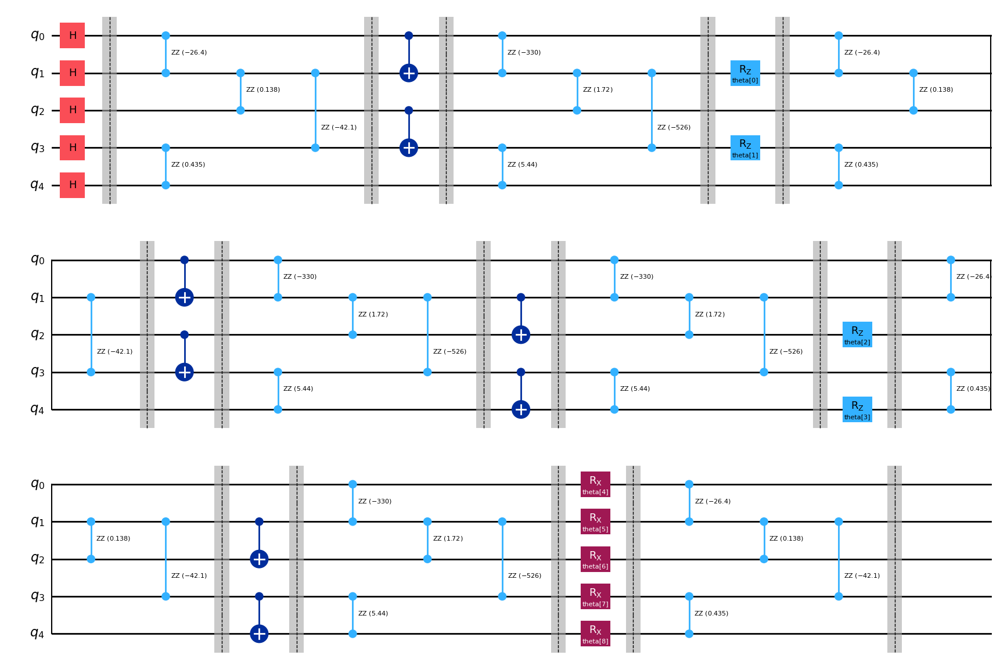

In [ ]:
# Ansatz for VQE

ansatz = QuantumCircuit(5)
params = ParameterVector("theta", length=9)
it = iter(params)

ansatz.h(range(0,5))
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 1)
ansatz.rz(next(it), 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(0, 1)
ansatz.cx(2, 3)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rz(next(it), 2)
ansatz.rz(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.cx(1, 2)
ansatz.cx(3, 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatz.barrier()


ansatz.rx(next(it), 0)
ansatz.rx(next(it), 1)
ansatz.rx(next(it), 2)
ansatz.rx(next(it), 3)
ansatz.rx(next(it), 4)
ansatz.barrier()

ansatz.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz.barrier()


ansatz.draw("mpl")

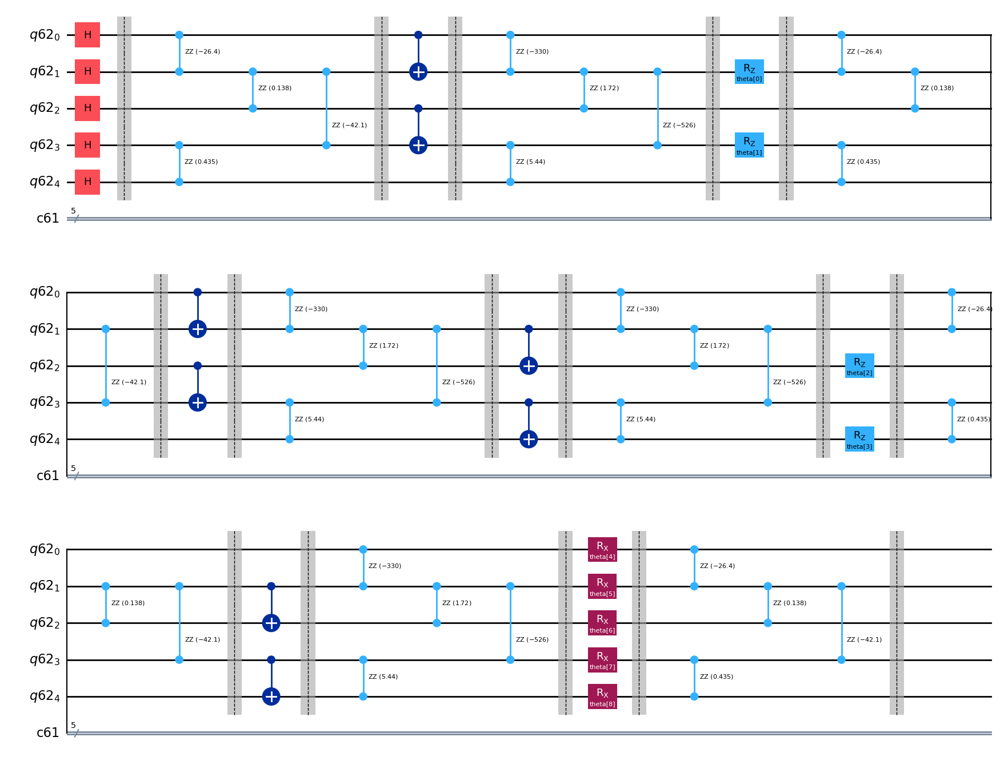

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

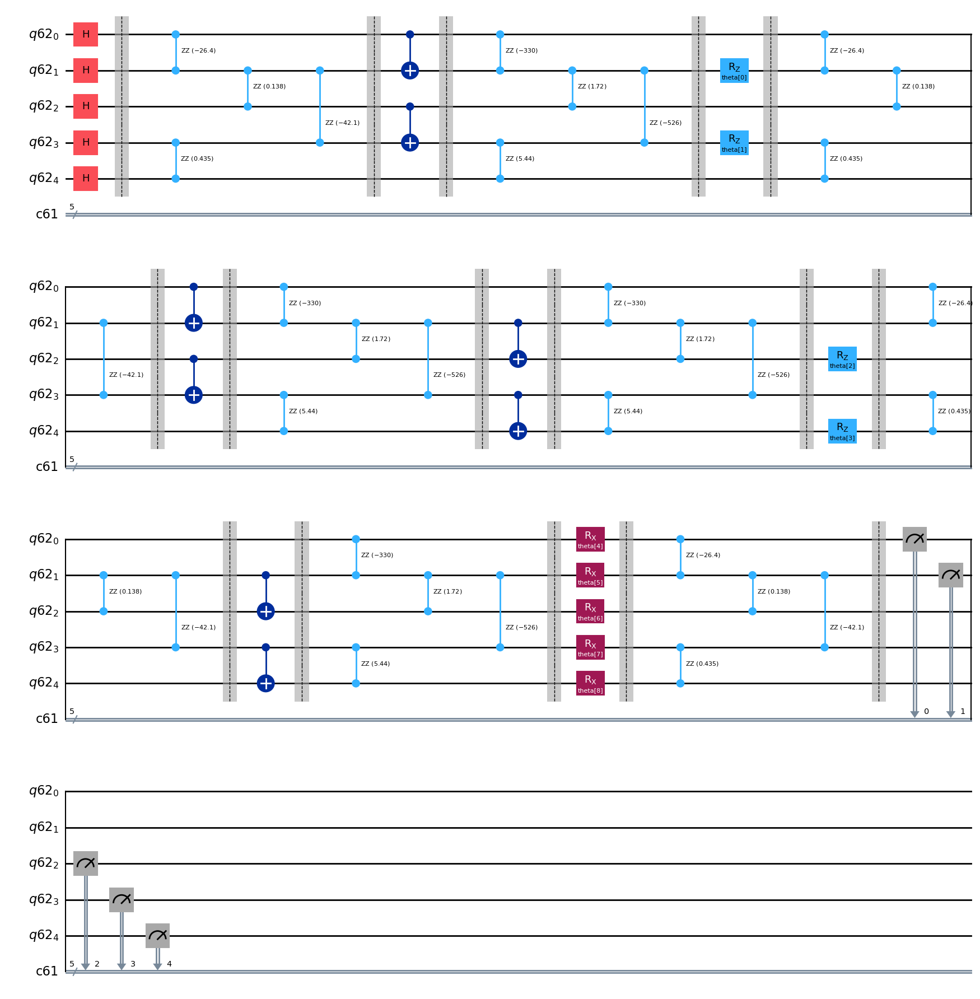

In [ ]:
# Ansatz for VQNHE ZZ Measurement

ansatz_zz = ansatzo

ansatz_zz.measure([0,1,2,3,4], [0,1,2,3,4])

ansatz_zz.draw("mpl")

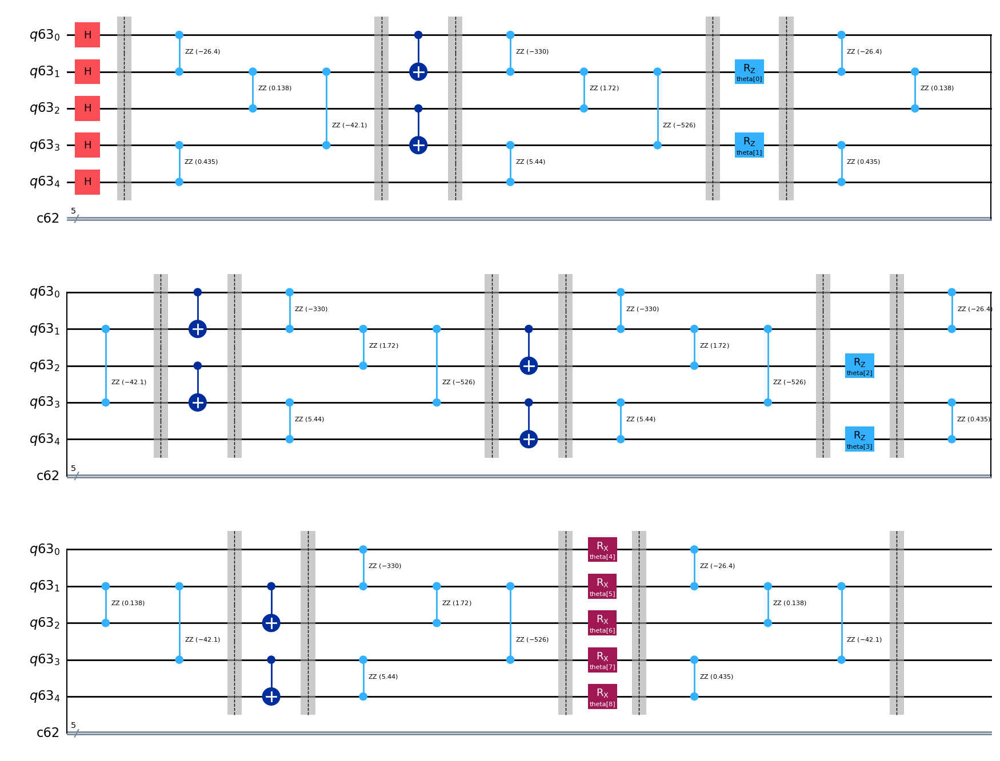

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

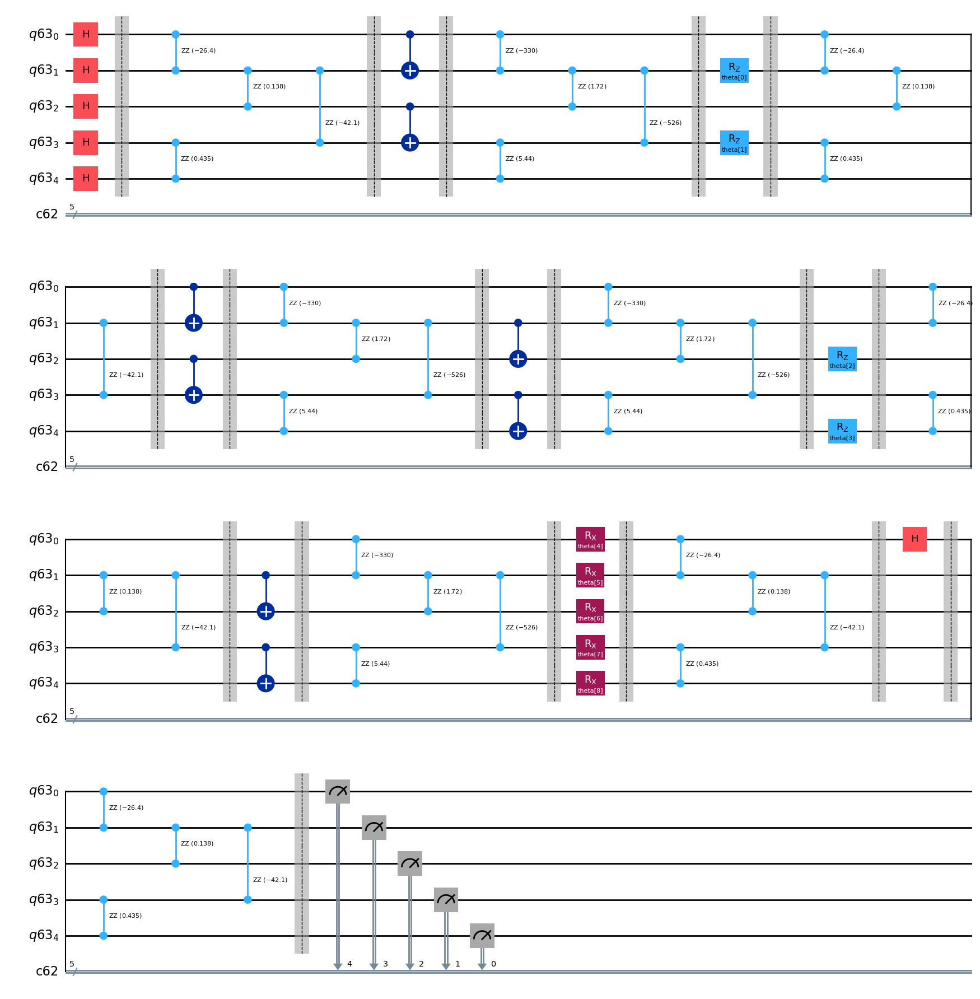

In [ ]:
# Ansatz for VQNHE X0 Measurement

qbit0 = QuantumRegister(5)
cbit0 = ClassicalRegister(5)

ansatz_x0 = ansatzo

ansatz_x0.h(0)
ansatz_x0.barrier()

ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x0.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x0.barrier()

ansatz_x0.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x0.draw("mpl")

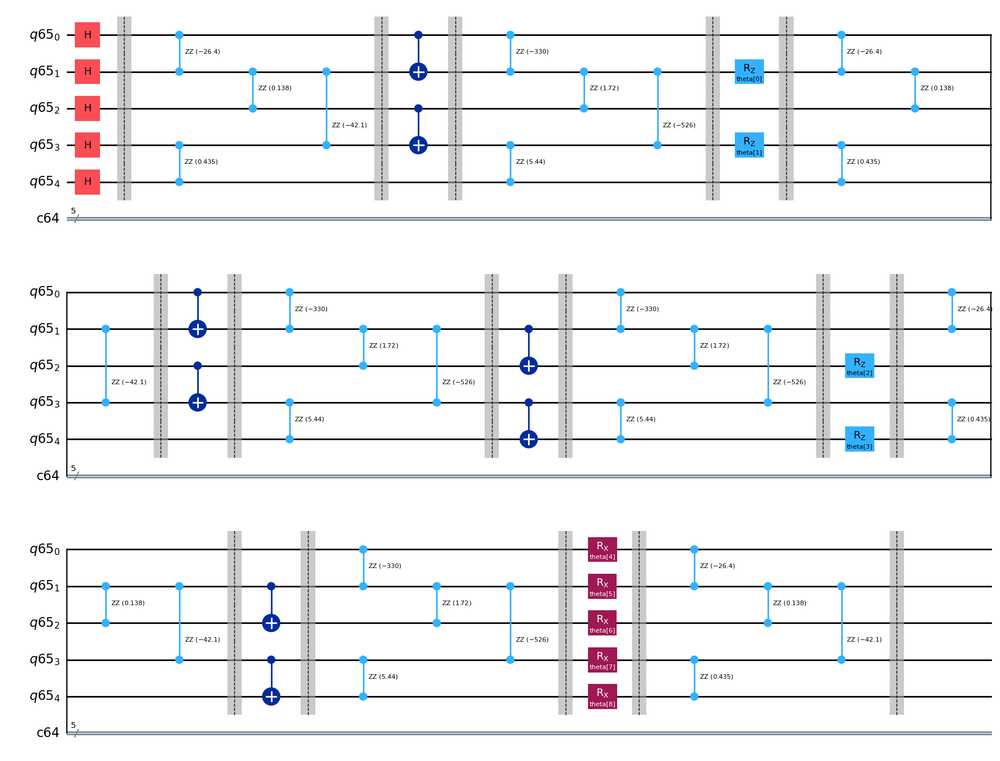

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

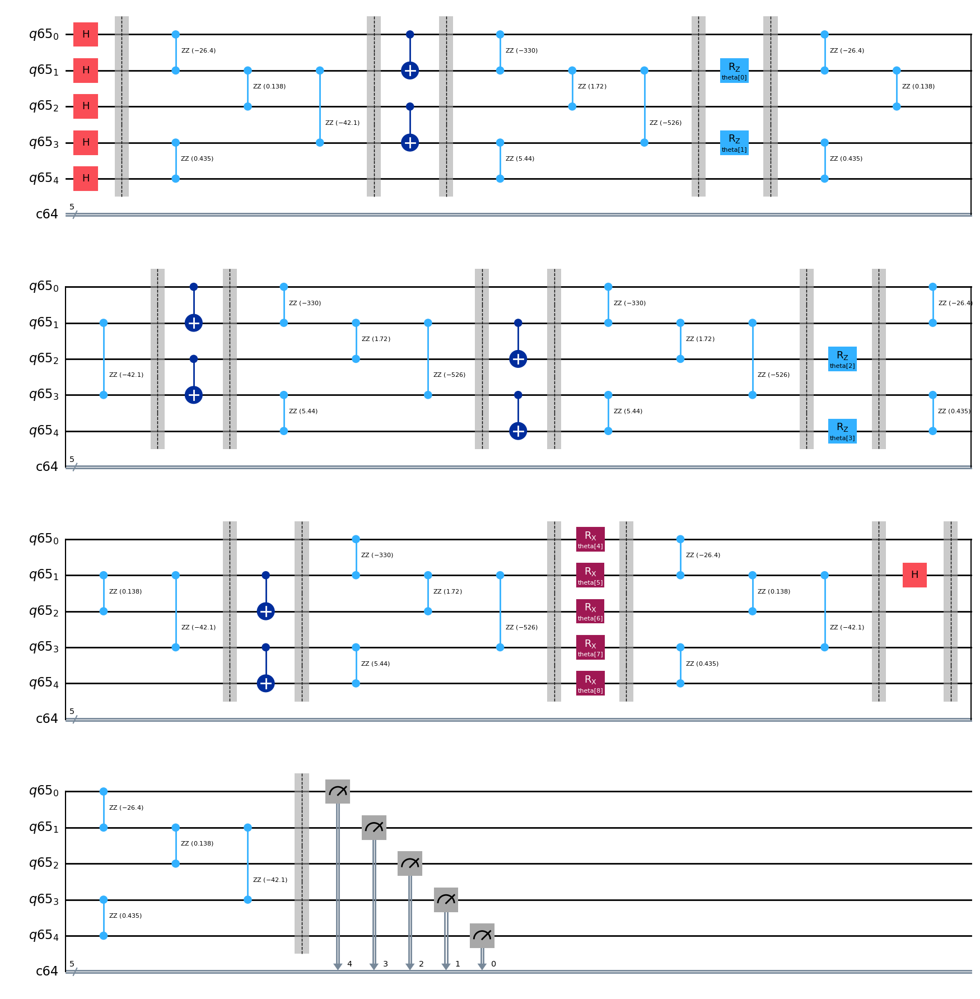

In [ ]:
# Ansatz for VQNHE X1 Measurement

qbit1 = QuantumRegister(5)
cbit1 = ClassicalRegister(5)

ansatz_x1 = ansatzo

ansatz_x1.h(1)
ansatz_x1.barrier()

ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x1.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x1.barrier()

ansatz_x1.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x1.draw("mpl")

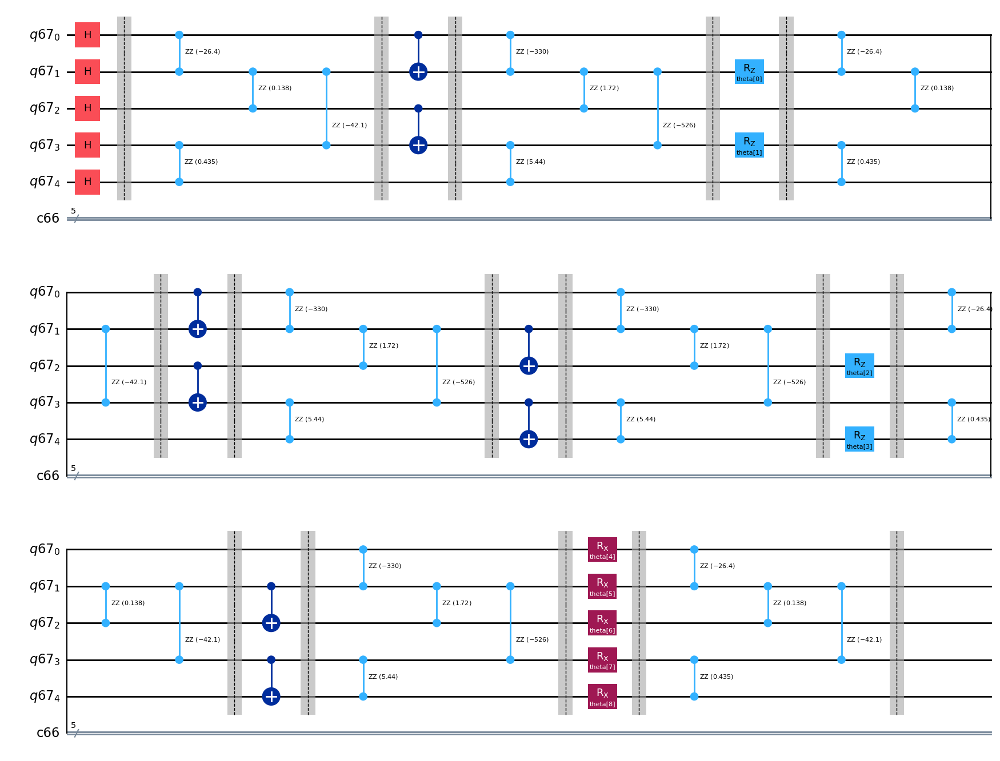

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

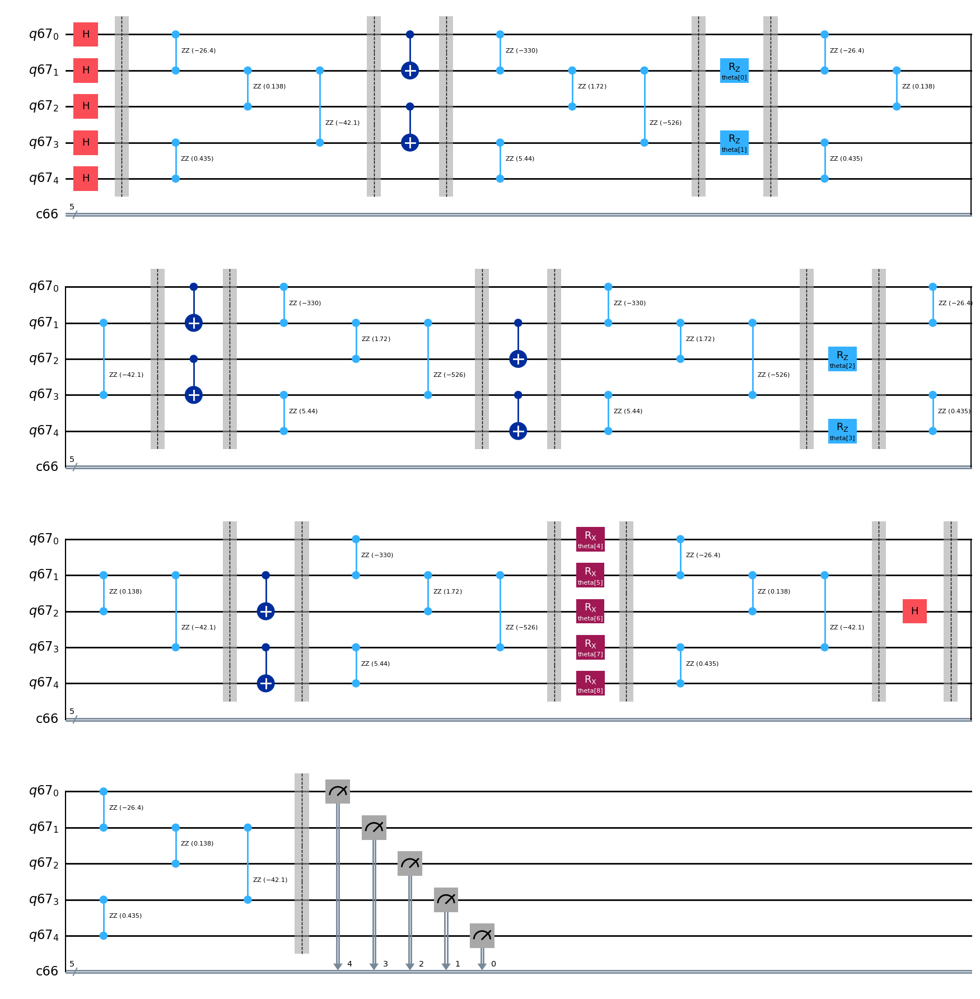

In [ ]:
# Ansatz for VQNHE X2 Measurement

qbit2 = QuantumRegister(5)
cbit2 = ClassicalRegister(5)

ansatz_x2 = ansatzo

ansatz_x2.h(2)
ansatz_x2.barrier()

ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x2.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x2.barrier()

ansatz_x2.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x2.draw("mpl")

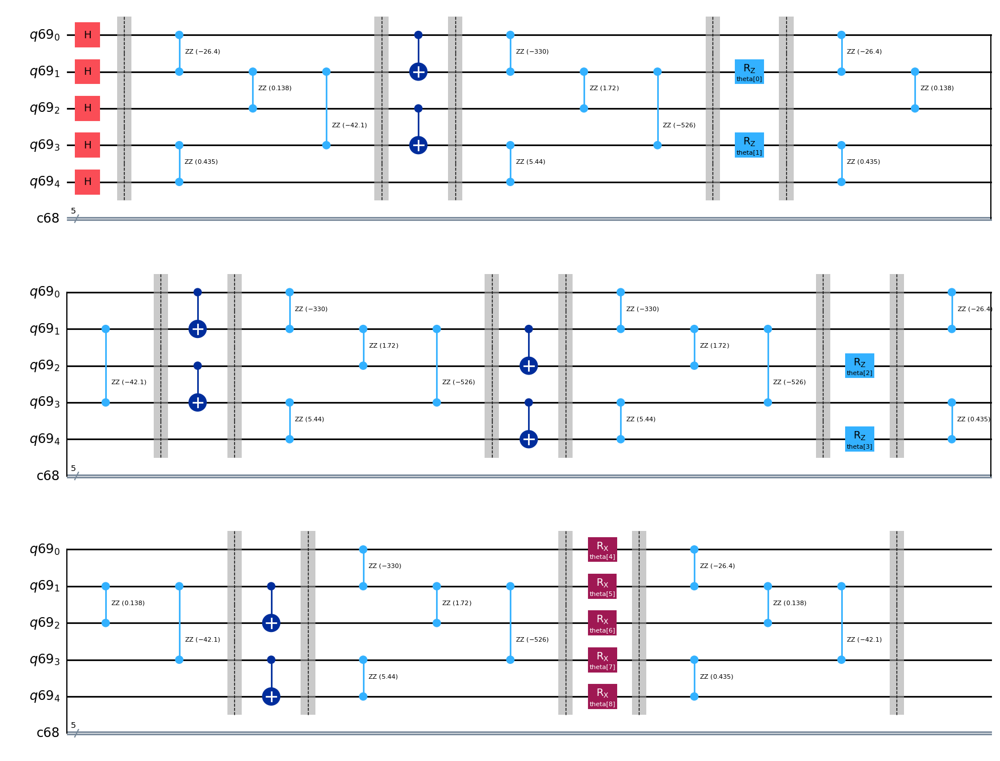

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

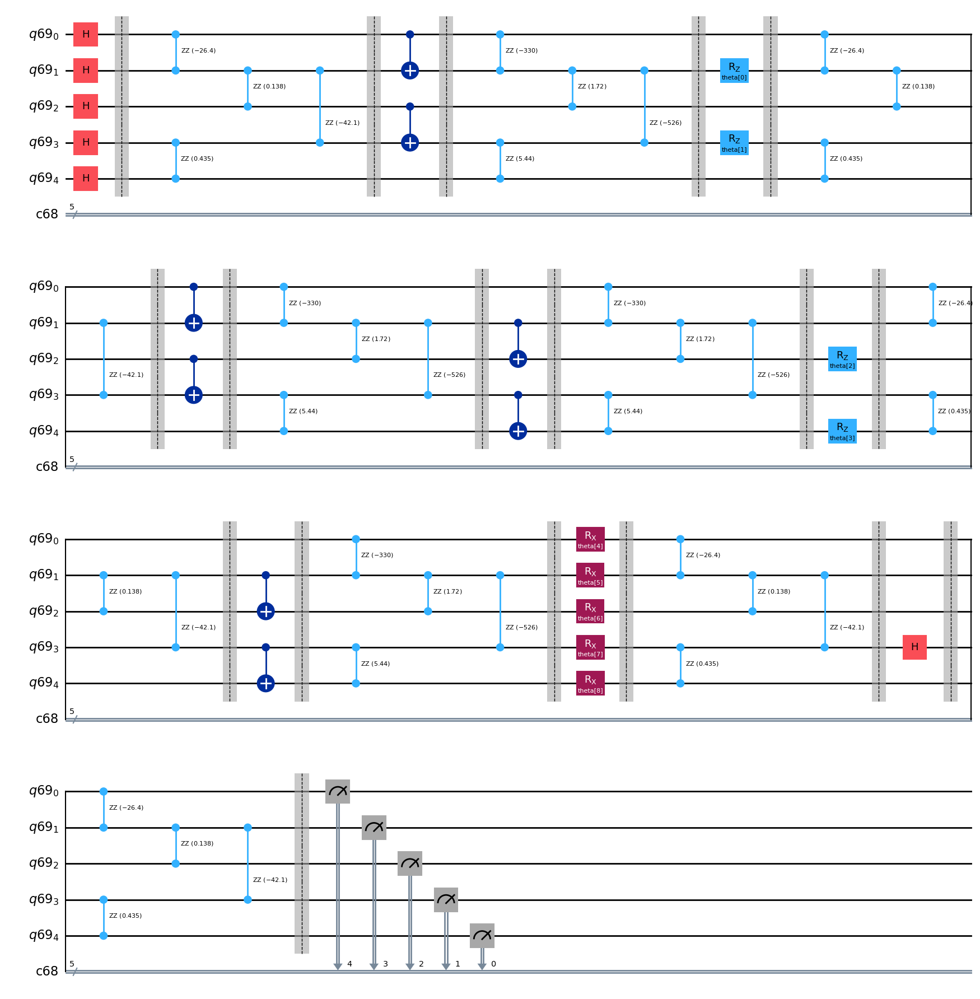

In [ ]:
# Ansatz for VQNHE X3 Measurement

qbit3 = QuantumRegister(5)
cbit3 = ClassicalRegister(5)

ansatz_x3 = ansatzo

ansatz_x3.h(3)
ansatz_x3.barrier()

ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x3.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x3.barrier()

ansatz_x3.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x3.draw("mpl")

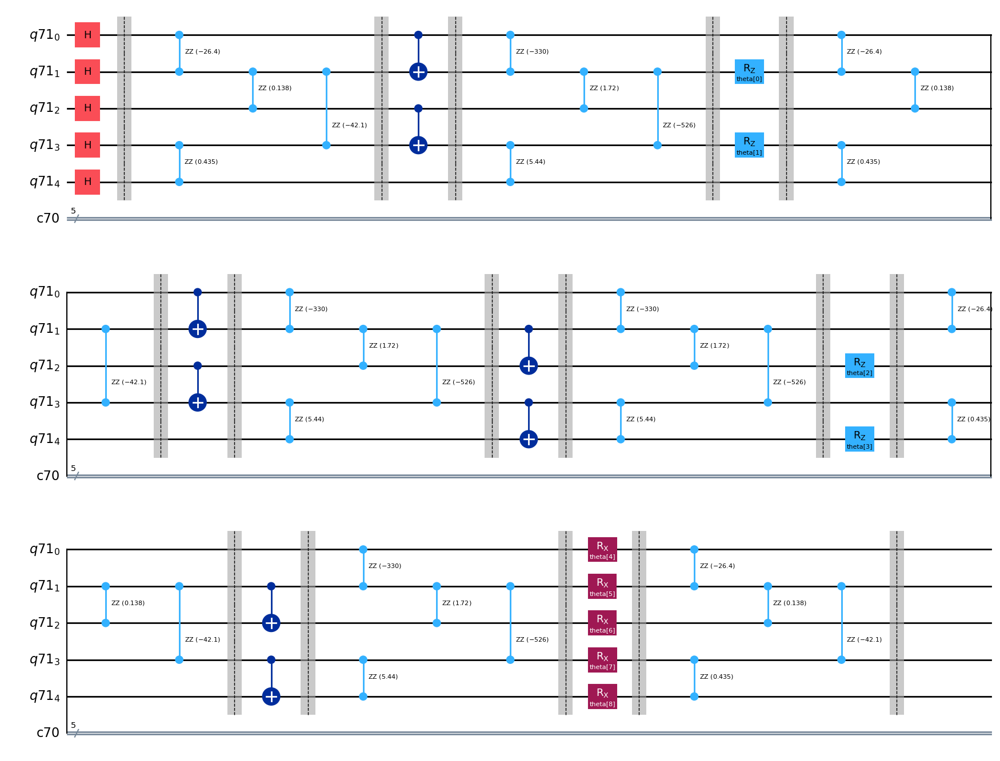

In [ ]:
# Ansatz for VQE

qbit = QuantumRegister(5)
cbit = ClassicalRegister(5)

ansatzo = QuantumCircuit(qbit, cbit)

params = ParameterVector("theta", length=9)
it = iter(params)

ansatzo.h(range(0,5))
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 1)
ansatzo.rz(next(it), 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(0, 1)
ansatzo.cx(2, 3)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_23)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_23)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_23)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_23)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rz(next(it), 2)
ansatzo.rz(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.cx(1, 2)
ansatzo.cx(3, 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single+gate_12)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single+gate_12)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single+gate_12)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single+gate_12)), [1,3])
ansatzo.barrier()


ansatzo.rx(next(it), 0)
ansatzo.rx(next(it), 1)
ansatzo.rx(next(it), 2)
ansatzo.rx(next(it), 3)
ansatzo.rx(next(it), 4)
ansatzo.barrier()

ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatzo.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatzo.barrier()


ansatzo.draw("mpl")

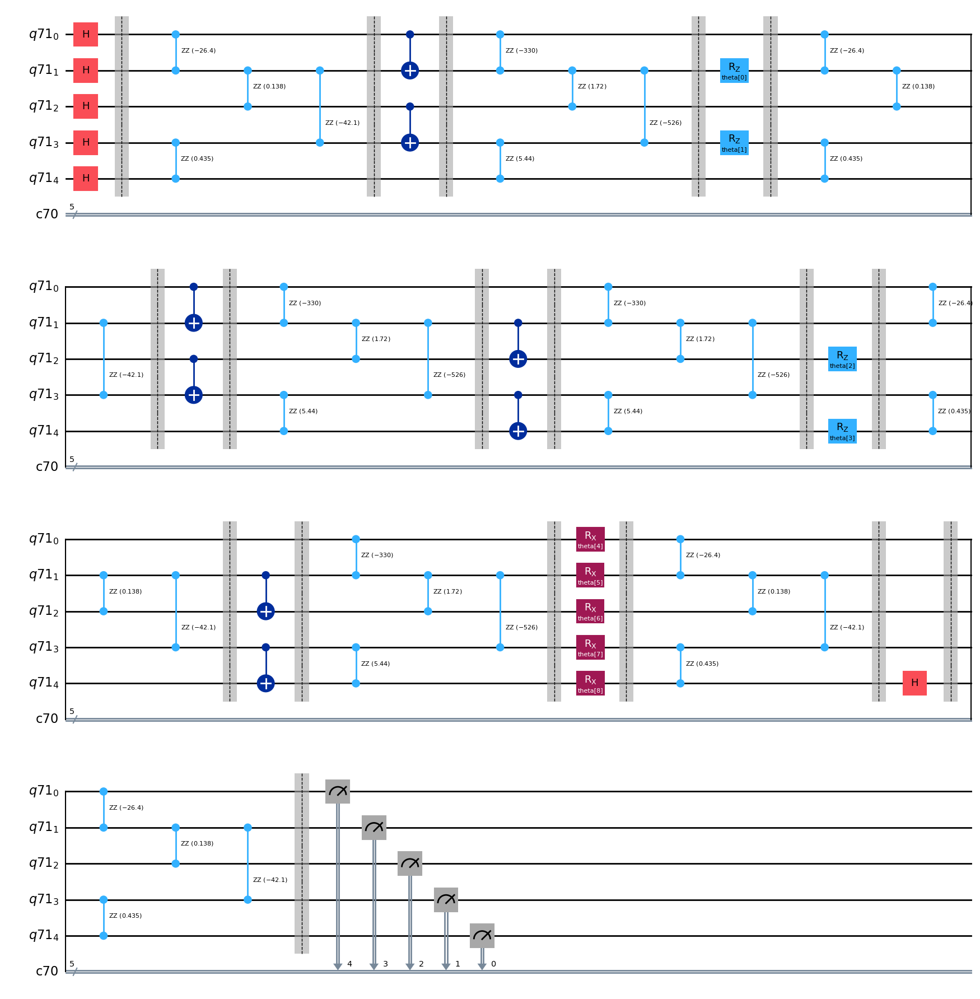

In [ ]:
# Ansatz for VQNHE X4 Measurement

qbit4 = QuantumRegister(5)
cbit4 = ClassicalRegister(5)

ansatz_x4 = ansatzo

ansatz_x4.h(4)
ansatz_x4.barrier()

ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_34*(gate_single)), [0,1])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_1522*(gate_single)), [3,4])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_45*(gate_single)), [1,2])
ansatz_x4.append(RZZGate(2*np.pi*crosstalk_freq_415*(gate_single)), [1,3])
ansatz_x4.barrier()

ansatz_x4.measure([0,1,2,3,4], [4,3,2,1,0])

ansatz_x4.draw("mpl")

### Cost Function for VQE & VQNHE

In [ ]:
# Activation Function for Neural Network

def relu(x):
  return np.maximum(0, x)


def output_activate(c, x):
  return np.exp(c*np.tanh(x))


# Convert Decimal Number to Binary Number

def d2b(x):

  binary = []

  for _ in range(5):
    binary.append(x % 2)
    x = x // 2

  binary.reverse()

  return np.array(binary)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
@cache
def pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8):

  def cost_func_vqe(params, ansatz, hamiltonian, estimator):
    cost = estimator.run(ansatz, hamiltonian, parameter_values=params, shots=10000, seed=1).result()
    return cost.values[0]


  def build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict):
    def callback(current_vector):
      callback_dict_vqe["iters"] += 1
      callback_dict_vqe["prev_vector"] = current_vector
      current_cost_vqe = cost_func_vqe(current_vector, ansatz, hamiltonian, estimator)

      callback_dict_vqe["cost_history"].append(current_cost_vqe)

      print(
        "Iters. done: {} [Current cost: {}]".format(callback_dict_vqe["iters"], current_cost_vqe),
        end="\r",
        flush=True,
      )

    return callback


  x_pqc_0 = np.array([x0,x1,x2,x3,x4,x5,x6,x7,x8])

  callback_dict_vqe = {
    "prev_vector": None,
    "iters": 0,
    "cost_history": [],
  }

  options = dict()
  options["maxiter"] = 50000
  options["disp"] = True

  callback_vqe = build_callback_vqe(ansatz, hamiltonian, estimator, callback_dict_vqe)
  res = minimize(
    cost_func_vqe,
    x_pqc_0,
    args=(ansatz, hamiltonian, estimator),
    method="cobyla",
    callback=callback_vqe,
    options=options
  )

  params_pqc = res.x

  return params_pqc

In [ ]:
@cache
def prob_string_zz(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_zz, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x0(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x0, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x1(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x1, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x2(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x2, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x3(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x3, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string


@cache
def prob_string_x4(x0,x1,x2,x3,x4,x5,x6,x7,x8):
  params_pqc = pqc_params(x0,x1,x2,x3,x4,x5,x6,x7,x8)
  job = sampler.run(ansatz_x4, params_pqc, shots=10000, seed=1).result()
  prob_string = job.quasi_dists[0]

  for i in range(32):
   if not (i in prob_string):  prob_string[i] = 0

  return prob_string

In [ ]:
def Z0Z1(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 8 == 0 or k // 8 == 3:
      expval = expval + prob_string[k]*nnval[k]
    if k // 8 == 1 or k // 8 == 2:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z1Z2(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k // 4 == 0 or k // 4 == 3 or k // 4 == 4 or k // 4 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k // 4 == 1 or k // 4 == 2 or k // 4 == 5 or k // 4 == 6:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z2Z3(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 8 == 0 or k % 8 == 1 or k % 8 == 6 or k % 8 == 7:
      expval = expval + prob_string[k]*nnval[k]
    if k % 8 == 2 or k % 8 == 3 or k % 8 == 4 or k % 8 == 5:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def Z3Z4(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    if k % 4 == 0 or k % 4 == 3:
      expval = expval + prob_string[k]*nnval[k]
    else:
      expval = expval - prob_string[k]*nnval[k]

  return expval


def X0(params_nn, x_pqc_0):
  prob_string = prob_string_x0(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(16):
    delt = prob_string[k] - prob_string[k+16]
    expval = expval + delt*nnval[k]*nnval[k+16]

  return expval


def X1(params_nn, x_pqc_0):
  prob_string = prob_string_x1(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(8):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  for k in range(16,24,1):
    delt = prob_string[k] - prob_string[k+8]
    expval = expval + delt*nnval[k]*nnval[k+8]

  return expval


def X2(params_nn, x_pqc_0):
  prob_string = prob_string_x2(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(4):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(8,12,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(16,20,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  for k in range(24,28,1):
    delt = prob_string[k] - prob_string[k+4]
    expval = expval + delt*nnval[k]*nnval[k+4]

  return expval


def X3(params_nn, x_pqc_0):
  prob_string = prob_string_x3(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,4):
    expval = expval + (prob_string[k] - prob_string[k+2])*nnval[k]*nnval[k+2]
    expval = expval + (prob_string[k+1] - prob_string[k+3])*nnval[k+1]*nnval[k+3]

  return expval


def X4(params_nn, x_pqc_0):
  prob_string = prob_string_x4(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([neural_net(params_nn, d2b(j)) for j in range(32)])

  expval = 0

  for k in range(0,32,2):
    expval = expval + (prob_string[k] - prob_string[k+1])*nnval[k]*nnval[k+1]

  return expval


def norm(params_nn, x_pqc_0):
  prob_string = prob_string_zz(x_pqc_0[0],x_pqc_0[1],x_pqc_0[2],x_pqc_0[3],x_pqc_0[4],x_pqc_0[5],x_pqc_0[6],x_pqc_0[7],x_pqc_0[8])
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])

  expval = 0

  for k in range(32):
    expval = expval + prob_string[k]*nnval[k]

  return expval

In [ ]:
def cost_func_vqnhe(params_nn, x_pqc_0):
  expval = 0
  expval = expval + Z0Z1(params_nn, x_pqc_0)
  expval = expval + Z1Z2(params_nn, x_pqc_0)
  expval = expval + Z2Z3(params_nn, x_pqc_0)
  expval = expval + Z3Z4(params_nn, x_pqc_0)

  expval = expval - X0(params_nn, x_pqc_0)
  expval = expval - X1(params_nn, x_pqc_0)
  expval = expval - X2(params_nn, x_pqc_0)
  expval = expval - X3(params_nn, x_pqc_0)
  expval = expval - X4(params_nn, x_pqc_0)

  expval = expval / norm(params_nn, x_pqc_0)

  return expval

In [ ]:
def build_callback_vqnhe(x_pqc_0, callback_dict):
  def callback(current_vector):
    callback_dict["iters"] += 1
    callback_dict["prev_vector"] = current_vector
    current_cost = cost_func_vqnhe(current_vector, x_pqc_0)
    callback_dict["cost_history"].append(current_cost)

  return callback

### VQE

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc

-2.503
-3.5164000000000004
-3.4968
-3.5144000000000006
-3.589000000000001
-3.7878000000000007
-3.6441999999999997
-3.2782000000000013
-3.6308000000000002
-3.7108
-2.9903999999999997
-3.4124
-3.5324000000000004
-3.4554000000000014
-3.592399999999999
-3.6616
-3.399
-3.2015999999999996
-3.4517999999999995
-3.8346


In [ ]:
lowest_energy_vqe

-3.8346

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 0개

In [ ]:
# Activation Function for Neural Network

def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:5]
  c = parameter[5]

  FC1 = FC1.reshape(1,5)


  a1 = np.matmul(FC1, x)
  y = output_activate(c, a1)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=6), pqc))
    if cost_func_vqnhe(np.zeros(shape=6), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=6), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(6) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.503
-3.5164000000000004
-3.4968
-3.5144000000000006
-3.589000000000001
-3.7878000000000007
-3.6441999999999997
-3.2782000000000013
-3.6308000000000002
-3.7108
-2.9903999999999997
-3.4124
-3.5324000000000004
-3.4554000000000014
-3.592399999999999
-3.6616
-3.399
-3.2015999999999996
-3.4517999999999995
-3.8346
Optimization terminated successfully.
         Current function value: -4.156656
         Iterations: 32
         Function evaluations: 308
         Gradient evaluations: 44
Optimization terminated successfully.
         Current function value: -4.389221
         Iterations: 43
         Function evaluations: 308
         Gradient evaluations: 44


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar pow

         Current function value: nan
         Iterations: 85
         Function evaluations: 1673
         Gradient evaluations: 239


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-248-942dbc8389c9>:103: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+4]
<ipython-input-248-942dbc8389c9>:123: RuntimeWarning: overfl

         Current function value: nan
         Iterations: 56
         Function evaluations: 1225
         Gradient evaluations: 175


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 58
         Function evaluations: 1302
         Gradient evaluations: 186


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-248-942dbc8389c9>:103: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+4]
<ipython-input-248-942dbc8389c9>:123: RuntimeWarning: overfl

         Current function value: nan
         Iterations: 57
         Function evaluations: 1239
         Gradient evaluations: 177


<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-248-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-248-942dbc8389c9>:86: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-248-942dbc8389c9>:86: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-248-942dbc8389c9>:1

         Current function value: nan
         Iterations: 112
         Function evaluations: 1848
         Gradient evaluations: 264
Optimization terminated successfully.
         Current function value: -6.138474
         Iterations: 74
         Function evaluations: 644
         Gradient evaluations: 92


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 58
         Function evaluations: 1253
         Gradient evaluations: 179
Optimization terminated successfully.
         Current function value: -14.117459
         Iterations: 34
         Function evaluations: 329
         Gradient evaluations: 47
Optimization terminated successfully.
         Current function value: -14.117459
         Iterations: 66
         Function evaluations: 756
         Gradient evaluations: 108
Optimization terminated successfully.
         Current function value: -4.936298
         Iterations: 61
         Function evaluations: 546
         Gradient evaluations: 78


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: overflow e

         Current function value: nan
         Iterations: 110
         Function evaluations: 1771
         Gradient evaluations: 253


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 75
         Function evaluations: 1456
         Gradient evaluations: 208


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:54: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-248-942dbc8389c9>:82: RuntimeWarning: overflow

         Current function value: nan
         Iterations: 91
         Function evaluations: 1610
         Gradient evaluations: 230


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:56: RuntimeWarning: invalid va

         Current function value: nan
         Iterations: 58
         Function evaluations: 1281
         Gradient evaluations: 183


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-248-942dbc8389c9>:82: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+8]
<ipython-input-248-942dbc8389c9>:103: RuntimeWarning: overfl

         Current function value: nan
         Iterations: 63
         Function evaluations: 1400
         Gradient evaluations: 200


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:54: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: overflow encountered in scalar multiply
  expval = expval + delt*nnval[k]*nnval[k+16]
<ipython-input-248-942dbc8389c9>:69: RuntimeWarning: invalid 

         Current function value: nan
         Iterations: 80
         Function evaluations: 1435
         Gradient evaluations: 205
Optimization terminated successfully.
         Current function value: -6.138474
         Iterations: 106
         Function evaluations: 875
         Gradient evaluations: 125
Optimization terminated successfully.
         Current function value: -14.117459
         Iterations: 36
         Function evaluations: 329
         Gradient evaluations: 47


In [ ]:
lowest_energy_vqnhe

-14.117459157601159

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:30]
  c = parameter[30]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=31), pqc))
    if cost_func_vqnhe(np.zeros(shape=31), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=31), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(31) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.503
-3.5164000000000004
-3.4968
-3.5144000000000006
-3.589000000000001
-3.7878000000000007
-3.6441999999999997
-3.2782000000000013
-3.6308000000000002
-3.7108
-2.9903999999999997
-3.4124
-3.5324000000000004
-3.4554000000000014
-3.592399999999999
-3.6616
-3.399
-3.2015999999999996
-3.4517999999999995
-3.8346


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -13.667271
         Iterations: 100
         Function evaluations: 5580
         Gradient evaluations: 174


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.592027
         Iterations: 21
         Function evaluations: 4108
         Gradient evaluations: 128


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.288230
         Iterations: 233
         Function evaluations: 13420
         Gradient evaluations: 419


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.846486
         Iterations: 95
         Function evaluations: 4619
         Gradient evaluations: 144


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.007773
         Iterations: 20
         Function evaluations: 3014
         Gradient evaluations: 94


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.478712
         Iterations: 167
         Function evaluations: 9990
         Gradient evaluations: 312


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.785310
         Iterations: 117
         Function evaluations: 8480
         Gradient evaluations: 265


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -15.049052
         Iterations: 67
         Function evaluations: 5032
         Gradient evaluations: 157


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -14.305569
         Iterations: 295
         Function evaluations: 16524
         Gradient evaluations: 516


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.426379
         Iterations: 62
         Function evaluations: 5191
         Gradient evaluations: 162


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:9: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:24: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:41: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar powe

         Current function value: nan
         Iterations: 141
         Function evaluations: 9504
         Gradient evaluations: 297


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -10.096516
         Iterations: 113
         Function evaluations: 9740
         Gradient evaluations: 304


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.308636
         Iterations: 56
         Function evaluations: 3820
         Gradient evaluations: 119


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.186066
         Iterations: 226
         Function evaluations: 15057
         Gradient evaluations: 470


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.144528
         Iterations: 144
         Function evaluations: 9835
         Gradient evaluations: 307


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.358856
         Iterations: 101
         Function evaluations: 5856
         Gradient evaluations: 183


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -13.160325
         Iterations: 50
         Function evaluations: 6629
         Gradient evaluations: 207


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -15.501181
         Iterations: 112
         Function evaluations: 7564
         Gradient evaluations: 236


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.813045
         Iterations: 82
         Function evaluations: 4748
         Gradient evaluations: 148
         Current function value: -13.428547
         Iterations: 40
         Function evaluations: 4524
         Gradient evaluations: 141


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-16.478712453551402

### VQNHE FC Hidden Layer 2개 + CNN Hidden Layer 0개

In [ ]:
def cnn(a, b, c, x):
  lst = []
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])

  return np.array(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  FC1 = parameter[0:25]
  FC2 = parameter[25:50]
  FC3 = parameter[50:55]
  c = parameter[55]

  FC1 = FC1.reshape(5,5)
  FC2 = FC2.reshape(5,5)
  FC3 = FC3.reshape(1,5)

  a1 = np.matmul(FC1, x)
  z1 = relu(a1)

  a2 = np.matmul(FC2, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC3, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=56), pqc))
    if cost_func_vqnhe(np.zeros(shape=56), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=56), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(56) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.503
-3.5164000000000004
-3.4968
-3.5144000000000006
-3.589000000000001
-3.7878000000000007
-3.6441999999999997
-3.2782000000000013
-3.6308000000000002
-3.7108
-2.9903999999999997
-3.4124
-3.5324000000000004
-3.4554000000000014
-3.592399999999999
-3.6616
-3.399
-3.2015999999999996
-3.4517999999999995
-3.8346


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.380542
         Iterations: 79
         Function evaluations: 11298
         Gradient evaluations: 198


<ipython-input-248-942dbc8389c9>:3: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:11: RuntimeWarning: invalid value encountered in scalar subtract
  expval = expval - prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:18: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:33: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:39: RuntimeWarning: invalid value encountered in scalar add
  expval = expval + prob_string[k]*nnval[k]
<ipython-input-248-942dbc8389c9>:48: RuntimeWarning: overflow encountered in scalar power
  nnval = np.array([(neural_net(params_nn, d2b(j)))**2 for j in range(32)])
<ipython-input-248-942dbc8389c9>:56: RuntimeWarning: inval

         Current function value: nan
         Iterations: 49
         Function evaluations: 11058
         Gradient evaluations: 194


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.047557
         Iterations: 23
         Function evaluations: 4392
         Gradient evaluations: 77


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.968634
         Iterations: 12
         Function evaluations: 6794
         Gradient evaluations: 119


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -5.393265
         Iterations: 82
         Function evaluations: 13234
         Gradient evaluations: 232


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.799642
         Iterations: 129
         Function evaluations: 11924
         Gradient evaluations: 209


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.433287
         Iterations: 213
         Function evaluations: 20931
         Gradient evaluations: 367


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -7.385741
         Iterations: 257
         Function evaluations: 23085
         Gradient evaluations: 405


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.185327
         Iterations: 248
         Function evaluations: 20639
         Gradient evaluations: 362


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.789703
         Iterations: 58
         Function evaluations: 9132
         Gradient evaluations: 160


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.489376
         Iterations: 294
         Function evaluations: 25548
         Gradient evaluations: 448


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -12.727263
         Iterations: 91
         Function evaluations: 13919
         Gradient evaluations: 244


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -6.933924
         Iterations: 23
         Function evaluations: 5134
         Gradient evaluations: 90


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.413542
         Iterations: 38
         Function evaluations: 10836
         Gradient evaluations: 190


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -15.998526
         Iterations: 163
         Function evaluations: 22579
         Gradient evaluations: 396


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -15.723705
         Iterations: 52
         Function evaluations: 7476
         Gradient evaluations: 131


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Maximum number of iterations has been exceeded.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -16.342621
         Iterations: 300
         Function evaluations: 23256
         Gradient evaluations: 408
         Current function value: -15.782080
         Iterations: 300
         Function evaluations: 22458
         Gradient evaluations: 394


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -15.174221
         Iterations: 59
         Function evaluations: 9755
         Gradient evaluations: 171
         Current function value: -16.473567
         Iterations: 165
         Function evaluations: 17674
         Gradient evaluations: 310


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


In [ ]:
lowest_energy_vqnhe

-16.48937622306484

### VQNHE FC Hidden Layer 0개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:24]
  c = parameter[24]

  FC1 = FC1.reshape(1,6)


  a2 = np.matmul(FC1, z1)
  y = output_activate(c, a2)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=25), pqc))
    if cost_func_vqnhe(np.zeros(shape=25), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=25), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(25) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.503
-3.5164000000000004
-3.4968
-3.5144000000000006
-3.589000000000001
-3.7878000000000007
-3.6441999999999997
-3.2782000000000013
-3.6308000000000002
-3.7108
-2.9903999999999997
-3.4124
-3.5324000000000004
-3.4554000000000014
-3.592399999999999
-3.6616
-3.399
-3.2015999999999996
-3.4517999999999995
-3.8346
Optimization terminated successfully.
         Current function value: -4.361499
         Iterations: 57
         Function evaluations: 2028
         Gradient evaluations: 78


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.401794
         Iterations: 269
         Function evaluations: 10100
         Gradient evaluations: 388
Optimization terminated successfully.
         Current function value: -4.279788
         Iterations: 142
         Function evaluations: 5590
         Gradient evaluations: 215


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.362380
         Iterations: 138
         Function evaluations: 8928
         Gradient evaluations: 343
Optimization terminated successfully.
         Current function value: -3.850644
         Iterations: 20
         Function evaluations: 546
         Gradient evaluations: 21
Optimization terminated successfully.
         Current function value: -4.355449
         Iterations: 178
         Function evaluations: 6266
         Gradient evaluations: 241


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.444270
         Iterations: 90
         Function evaluations: 3094
         Gradient evaluations: 119
Optimization terminated successfully.
         Current function value: -3.850645
         Iterations: 20
         Function evaluations: 546
         Gradient evaluations: 21
Optimization terminated successfully.
         Current function value: -4.444967
         Iterations: 84
         Function evaluations: 4082
         Gradient evaluations: 157


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.360362
         Iterations: 168
         Function evaluations: 6746
         Gradient evaluations: 259
Optimization terminated successfully.
         Current function value: -4.474955
         Iterations: 93
         Function evaluations: 3094
         Gradient evaluations: 119
Optimization terminated successfully.
         Current function value: -4.147814
         Iterations: 67
         Function evaluations: 2418
         Gradient evaluations: 93


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.369735
         Iterations: 90
         Function evaluations: 4923
         Gradient evaluations: 189
Optimization terminated successfully.
         Current function value: -3.850643
         Iterations: 21
         Function evaluations: 572
         Gradient evaluations: 22


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.442294
         Iterations: 80
         Function evaluations: 3094
         Gradient evaluations: 119
Optimization terminated successfully.
         Current function value: -4.363000
         Iterations: 101
         Function evaluations: 3380
         Gradient evaluations: 130
Optimization terminated successfully.
         Current function value: -4.219997
         Iterations: 80
         Function evaluations: 2730
         Gradient evaluations: 105
Optimization terminated successfully.
         Current function value: -3.850642
         Iterations: 12
         Function evaluations: 416
         Gradient evaluations: 16
Optimization terminated successfully.
         Current function value: -4.307883
         Iterations: 121
         Function evaluations: 5460
         Gradient evaluations: 210
Optimization terminated successfully.
         Current function value: -4.305569
         Iterations: 17
         Function evaluations: 754
         Gradient 

In [ ]:
lowest_energy_vqnhe

-4.474955028619331

### VQNHE FC Hidden Layer 1개 + CNN Hidden Layer 1개

In [ ]:
def cnn2(vec, x):
  a = vec[0]
  b = vec[1]

  lst = []
  lst.append(b*x[0])
  lst.append(a*x[0]+b*x[1])
  lst.append(a*x[1]+b*x[2])
  lst.append(a*x[2]+b*x[3])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn3(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]

  lst = []
  lst.append(c*x[0])
  lst.append(b*x[0]+c*x[1])
  lst.append(a*x[0]+b*x[1]+c*x[2])
  lst.append(a*x[1]+b*x[2]+c*x[3])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


def cnn4(vec, x):
  a = vec[0]
  b = vec[1]
  c = vec[2]
  d = vec[3]

  lst = []
  lst.append(d*x[0])
  lst.append(c*x[0]+d*x[1])
  lst.append(b*x[0]+c*x[1]+d*x[2])
  lst.append(a*x[0]+b*x[1]+c*x[2]+d*x[3])
  lst.append(a*x[1]+b*x[2]+c*x[3]+d*x[4])
  lst.append(a*x[2]+b*x[3]+c*x[4])
  lst.append(a*x[3]+b*x[4])
  lst.append(a*x[4])

  lst = np.array(lst)

  return np.max(lst)


# Neural Network
# Output : f(s)

def neural_net(parameter, x):

  a1 = np.array([cnn2(parameter[0:2], x), cnn2(parameter[2:4], x), cnn3(parameter[4:7], x), cnn3(parameter[7:10], x), cnn4(parameter[10:14], x), cnn4(parameter[14:18], x)])
  z1 = relu(a1)

  FC1 = parameter[18:48]
  FC2 = parameter[48:53]
  c = parameter[53]

  FC1 = FC1.reshape(5,6)
  FC2 = FC2.reshape(1,5)


  a2 = np.matmul(FC1, z1)
  z2 = relu(a2)

  a3 = np.matmul(FC2, z2)
  y = output_activate(c, a3)

  return y[0]

In [ ]:
noise_model = NoiseModel()
estimator = Estimator(backend_options={"noise_model": noise_model}, skip_transpilation=True)
sampler = Sampler(backend_options={"noise_model": noise_model}, skip_transpilation=True)


lowest_energy_vqnhe = 0

for k in range(20):
    np.random.seed(k)
    x_pqc_0 = 2*np.pi*np.random.random(9)

    pqc = pqc_params(x_pqc_0[0], x_pqc_0[1], x_pqc_0[2], x_pqc_0[3], x_pqc_0[4], x_pqc_0[5], x_pqc_0[6], x_pqc_0[7], x_pqc_0[8])
    print(cost_func_vqnhe(np.zeros(shape=54), pqc))
    if cost_func_vqnhe(np.zeros(shape=54), pqc) < lowest_energy_vqe:
      lowest_energy_vqe = cost_func_vqnhe(np.zeros(shape=54), pqc)
      optimized_pqc = pqc


for k in range(20, 40, 1):

    callback_dict = {
      "prev_vector": None,
      "iters": 0,
      "cost_history": [],
    }

    np.random.seed(k)
    x0 = 2 * np.random.random(54) - 1

    callback = build_callback_vqnhe(optimized_pqc, callback_dict)

    options = dict()
    options["maxiter"] = 300
    options["disp"] = True

    res = minimize(
      cost_func_vqnhe,
      x0,
      args=(optimized_pqc),
      method="bfgs",
      callback=callback,
      options=options
    )

    local_minimum_dict = callback_dict["cost_history"]

    if len(local_minimum_dict) and local_minimum_dict[-1] < lowest_energy_vqnhe :
      lowest_energy_vqnhe = local_minimum_dict[-1]

-2.503
-3.5164000000000004
-3.4968
-3.5144000000000006
-3.589000000000001
-3.7878000000000007
-3.6441999999999997
-3.2782000000000013
-3.6308000000000002
-3.7108
-2.9903999999999997
-3.4124
-3.5324000000000004
-3.4554000000000014
-3.592399999999999
-3.6616
-3.399
-3.2015999999999996
-3.4517999999999995
-3.8346


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.357865
         Iterations: 30
         Function evaluations: 5676
         Gradient evaluations: 103


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.388247
         Iterations: 35
         Function evaluations: 4846
         Gradient evaluations: 88


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.315846
         Iterations: 152
         Function evaluations: 11836
         Gradient evaluations: 215
Optimization terminated successfully.
         Current function value: -3.850646
         Iterations: 20
         Function evaluations: 1155
         Gradient evaluations: 21
Optimization terminated successfully.
         Current function value: -3.850646
         Iterations: 16
         Function evaluations: 935
         Gradient evaluations: 17


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.353800
         Iterations: 103
         Function evaluations: 7590
         Gradient evaluations: 138


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.305259
         Iterations: 53
         Function evaluations: 7428
         Gradient evaluations: 135


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.307875
         Iterations: 73
         Function evaluations: 7822
         Gradient evaluations: 142
Optimization terminated successfully.
         Current function value: -3.834600
         Iterations: 1
         Function evaluations: 110
         Gradient evaluations: 2


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.299535
         Iterations: 36
         Function evaluations: 7547
         Gradient evaluations: 137


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.363265
         Iterations: 106
         Function evaluations: 12051
         Gradient evaluations: 219
Optimization terminated successfully.
         Current function value: -4.120071
         Iterations: 13
         Function evaluations: 1045
         Gradient evaluations: 19


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.330600
         Iterations: 199
         Function evaluations: 21132
         Gradient evaluations: 384


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.137700
         Iterations: 7
         Function evaluations: 4238
         Gradient evaluations: 77


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.280546
         Iterations: 249
         Function evaluations: 19140
         Gradient evaluations: 348


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.364293
         Iterations: 105
         Function evaluations: 7535
         Gradient evaluations: 137


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.193812
         Iterations: 17
         Function evaluations: 6282
         Gradient evaluations: 114


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.334058
         Iterations: 19
         Function evaluations: 5677
         Gradient evaluations: 103


/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minimize.py:705: OptimizeWarning: Desired error not necessarily achieved due to precision loss.
  res = _minimize_bfgs(fun, x0, args, jac, callback, **options)


         Current function value: -4.309798
         Iterations: 51
         Function evaluations: 8977
         Gradient evaluations: 163
Optimization terminated successfully.
         Current function value: -4.513042
         Iterations: 112
         Function evaluations: 8965
         Gradient evaluations: 163


In [ ]:
lowest_energy_vqnhe

-4.513042413442587

# CNN QEM Plot

## 5. CNN Estimation - Depolarizing Channel

vqe

[-5.831799999999999,
 -5.8191999999999995,
 -5.775000000000001,
 -5.782000000000001,
 -5.7467999999999995,
 -5.742000000000001,
 -5.6944,
 -5.709399999999999,
 -5.684400000000002,
 -5.6546,
 -5.6246,
 -5.4496,
 -5.256800000000002,
 -5.056400000000001,
 -4.8721999999999985,
 -4.706800000000002,
 -4.576600000000001,
 -4.430999999999998,
 -4.254599999999999,
 -4.114799999999999]

vqnhe FC Hidden Layer 0 + CNN Hidden Layer 0

[-5.919691524202059,
 -5.909266681731913,
 -5.871121846295345,
 -5.860512992519139,
 -5.827856166661195,
 -5.8693531158632455,
 -5.803894487338251,
 -5.816255217174009,
 -5.763852070123904,
 -5.7550676097308475,
 -5.720940795044208,
 -5.568578059117119,
 -5.411916222038937,
 -5.284468919589966,
 -5.265287221604532,
 -5.129173554445168,
 -5.077624272045166,
 -5.073424152028077,
 -4.928244187760365,
 -4.911047483324537]

vqnhe FC Hidden Layer 1 + CNN Hidden Layer 0

[-6.016810277150228,
 -5.993445929692607,
 -6.012591815389597,
 -5.959095768598058,
 -5.909027999679842,
 -5.987107360376306,
 -5.917036036455259,
 -5.922397274809012,
 -5.857229761262304,
 -5.841494889534196,
 -5.8105821583220525,
 -5.692370916403381,
 -5.569565571660491,
 -5.406280078842187,
 -5.396340270045532,
 -5.245672828163454,
 -5.192263034610052,
 -5.16313359541295,
 -5.032879195310073,
 -4.978091901266644]

vqnhe FC Hidden Layer 0 + CNN Hidden Layer 1

vqnhe FC Hidden Layer 1 + CNN Hidden Layer 1

[-5.9215692209688084,
 -5.9051113716317625,
 -5.882038846182267,
 -5.88662268294751,
 -5.839374372609238,
 -5.836689658429629,
 -5.808483999142415,
 -5.8287110002385445,
 -5.787439979698193,
 -5.768134065885558,
 -5.727824786531487,
 -5.613545399129404,
 -5.460960445529198,
 -5.318625460239696,
 -5.2174201256509285,
 -5.1133637963997245,
 -5.031851065964,
 -4.981779980345924,
 -4.863445336486164,
 -4.774758869722714]

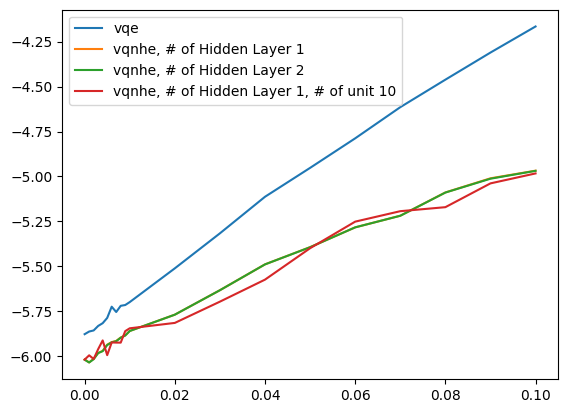

In [ ]:
error_list = [0.001*i for i in range(10)]+[0.01*i for i in range(1,11,1)]

vqe = [-5.876600000000001, -5.8619200000000005, -5.855820000000001, -5.830759999999999, -5.81554, -5.786360000000001, -5.723840000000001, -5.75338, -5.71892, -5.714540000000001, -5.69826, -5.5106, -5.3159800000000015, -5.112719999999999, -4.9521, -4.78792, -4.614680000000001, -4.461779999999999, -4.3110599999999994, -4.16606]
vqnhe_1 = [-6.016802141557301, -6.033668811971606, -6.0126360379539046, -5.981320863910831, -5.969558737051838, -5.934874750042589, -5.920637462798409, -5.914035409603047, -5.895030747146389, -5.883510734777119, -5.8589093314138285, -5.768163382324187, -5.632185221427297, -5.488488523492795, -5.392835794187803, -5.282777008483308, -5.218086763971021, -5.088782119949112, -5.010089066676246, -4.967618445813056]
vqnhe_2 = [-6.0189520440435835, -6.033933976459512, -6.015939855858921, -5.981398538394226, -5.971035006177397, -5.937147888028424, -5.921916205729822, -5.915723425109382, -5.896390190020607, -5.884099549362669, -5.858966473582975, -5.768171830036203, -5.632245711882939, -5.488642324996632, -5.393136248291399, -5.282811913275707, -5.218354733066544, -5.089269, -5.012300, -4.968633]
vqnhe_5 = [-6.012186352896376, -5.990314680426382, -6.012238520592578, -5.94999362014869, -5.911308461056507, -5.987423, -5.91941228330353, -5.9199132081640755, -5.857610311120224, -5.840269378687749, -5.8127171201352414, -5.695483374689246, -5.572004400932811, -5.409658085158476, -5.397080228431743, -5.250284575846735, -5.1916432743864025, -5.169469727175823, -5.034134576221107, -4.971820354328851]
vqnhe_unit10 = [-6.0180292017147865, -5.9940830843595005, -6.014639147707469, -5.9597404015346624, -5.911344187076163, -5.993209559288424, -5.922568836995583, -5.92337036213113, -5.9235631, -5.859724870361055, -5.843946004687859, -5.81398424629551, -5.695758589588917, -5.573372391501268, -5.398764320375726, -5.250990830374524, -5.192855248104412, -5.170575560977388, -5.0383291010529865, -4.982976474792443]


plt.plot(error_list, vqe, label="vqe")
plt.plot(error_list, vqnhe_1, label="vqnhe, # of Hidden Layer 1")
plt.plot(error_list, vqnhe_2, label="vqnhe, # of Hidden Layer 2")
plt.plot(error_list, vqnhe_5, label="vqnhe, # of Hidden Layer 5")
plt.plot(error_list, vqnhe_unit10, label="vqnhe, # of Hidden Layer 1, # of unit 10")
plt.legend()